## NLP
## Bibind Vasu
## Assignment 7

In [1]:
from IPython.core.display import HTML
style = """
<style>
div.output_area {
	overflow-y: scroll;
	max-height: 500px;
}
</style>
"""
HTML(style)

## 1. Using your text(s)/corpus/corpora from the previous assignment and the gensim package, create an LDA Topic Model.

### a. Provide the raw Keywords and loadings for at least 5 Topics (10+ preferred).
### b. Provide the Perplexity and Coherence scores for your model.
### c. Provide a screenshot of two Topics from the pyLDAvis.gensim visualization.
### d. In 2-3 sentences, comment on the Topics you have provided and whether you feel they accurately represent topics in your corpus.

In [4]:
# Run in python console
import nltk; nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/bibindvasu/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [75]:
import re
import numpy as np
import pandas as pd
from pprint import pprint

# Gensim
import gensim
import gensim.corpora as corpora
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel

# spacy for lemmatization
import spacy

# Plotting tools
import pyLDAvis
import pyLDAvis.gensim  # don't skip this
import matplotlib.pyplot as plt
%matplotlib inline

# Enable logging for gensim - optional
import logging
logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.ERROR)

import warnings
warnings.filterwarnings("ignore",category=DeprecationWarning)

In [2]:
from sklearn.datasets import fetch_20newsgroups
newsgroups_train = fetch_20newsgroups(subset='train')

from pprint import pprint
pprint(list(newsgroups_train.target_names))

['alt.atheism',
 'comp.graphics',
 'comp.os.ms-windows.misc',
 'comp.sys.ibm.pc.hardware',
 'comp.sys.mac.hardware',
 'comp.windows.x',
 'misc.forsale',
 'rec.autos',
 'rec.motorcycles',
 'rec.sport.baseball',
 'rec.sport.hockey',
 'sci.crypt',
 'sci.electronics',
 'sci.med',
 'sci.space',
 'soc.religion.christian',
 'talk.politics.guns',
 'talk.politics.mideast',
 'talk.politics.misc',
 'talk.religion.misc']


In [3]:
cats = ['alt.atheism', 'sci.space']
newsgroups_train = fetch_20newsgroups(subset='train', categories=cats)

In [6]:
pprint(list(newsgroups_train.target_names))

['alt.atheism', 'sci.space']


In [21]:
newsgroups_train.data

['From: bil@okcforum.osrhe.edu (Bill Conner)\nSubject: Re: Not the Omni!\nNntp-Posting-Host: okcforum.osrhe.edu\nOrganization: Okcforum Unix Users Group\nX-Newsreader: TIN [version 1.1 PL6]\nLines: 18\n\nCharley Wingate (mangoe@cs.umd.edu) wrote:\n: \n: >> Please enlighten me.  How is omnipotence contradictory?\n: \n: >By definition, all that can occur in the universe is governed by the rules\n: >of nature. Thus god cannot break them. Anything that god does must be allowed\n: >in the rules somewhere. Therefore, omnipotence CANNOT exist! It contradicts\n: >the rules of nature.\n: \n: Obviously, an omnipotent god can change the rules.\n\nWhen you say, "By definition", what exactly is being defined;\ncertainly not omnipotence. You seem to be saying that the "rules of\nnature" are pre-existant somehow, that they not only define nature but\nactually cause it. If that\'s what you mean I\'d like to hear your\nfurther thoughts on the question.\n\nBill\n',
 "From: jhwitten@cs.ruu.nl (Jurriaan W

In [51]:
df = pd.read_csv("metadata.csv") 

//anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3057: DtypeWarning: Columns (13,14) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [52]:
df.head()

,cord_uid,sha,source_x,title,doi,pmcid,pubmed_id,license,abstract,publish_time,authors,journal,mag_id,who_covidence_id,arxiv_id,pdf_json_files,pmc_json_files,url,s2_id
0,ug7v899j,d1aafb70c066a2068b02786f8929fd9c900897fb,PMC,Clinical features of culture-proven Mycoplasma...,10.1186/1471-2334-1-6,PMC35282,11472636.0,no-cc,OBJECTIVE: This retrospective chart review des...,2001-07-04,"Madani, Tariq A; Al-Ghamdi, Aisha A",BMC Infect Dis,NaN,NaN,NaN,document_parses/pdf_json/d1aafb70c066a2068b027...,document_parses/pmc_json/PMC35282.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3...,NaN
1,02tnwd4m,6b0567729c2143a66d737eb0a2f63f2dce2e5a7d,PMC,Nitric oxide: a pro-inflammatory mediator in l...,10.1186/rr14,PMC59543,11667967.0,no-cc,Inflammatory diseases of the respiratory tract...,2000-08-15,"Vliet, Albert van der; Eiserich, Jason P; Cros...",Respir Res,NaN,NaN,NaN,document_parses/pdf_json/6b0567729c2143a66d737...,document_parses/pmc_json/PMC59543.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC5...,NaN
2,ejv2xln0,06ced00a5fc04215949aa72528f2eeaae1d58927,PMC,Surfactant protein-D and pulmonary host defense,10.1186/rr19,PMC59549,11667972.0,no-cc,Surfactant protein-D (SP-D) participates in th...,2000-08-25,"Crouch, Erika C",Respir Res,NaN,NaN,NaN,document_parses/pdf_json/06ced00a5fc04215949aa...,document_parses/pmc_json/PMC59549.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC5...,NaN
3,2b73a28n,348055649b6b8cf2b9a376498df9bf41f7123605,PMC,Role of endothelin-1 in lung disease,10.1186/rr44,PMC59574,11686871.0,no-cc,Endothelin-1 (ET-1) is a 21 amino acid peptide...,2001-02-22,"Fagan, Karen A; McMurtry, Ivan F; Rodman, David M",Respir Res,NaN,NaN,NaN,document_parses/pdf_json/348055649b6b8cf2b9a37...,document_parses/pmc_json/PMC59574.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC5...,NaN
4,9785vg6d,5f48792a5fa08bed9f56016f4981ae2ca6031b32,PMC,Gene expression in epithelial cells in respons...,10.1186/rr61,PMC59580,11686888.0,no-cc,Respiratory syncytial virus (RSV) and pneumoni...,2001-05-11,"Domachowske, Joseph B; Bonville, Cynthia A; Ro...",Respir Res,NaN,NaN,NaN,document_parses/pdf_json/5f48792a5fa08bed9f560...,document_parses/pmc_json/PMC59580.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC5...,NaN


In [54]:
df1 = df["title"]
df1.head()

0    Clinical features of culture-proven Mycoplasma...
1    Nitric oxide: a pro-inflammatory mediator in l...
2      Surfactant protein-D and pulmonary host defense
3                 Role of endothelin-1 in lung disease
4    Gene expression in epithelial cells in respons...
Name: title, dtype: object

In [55]:
df[:1]

,cord_uid,sha,source_x,title,doi,pmcid,pubmed_id,license,abstract,publish_time,authors,journal,mag_id,who_covidence_id,arxiv_id,pdf_json_files,pmc_json_files,url,s2_id
0,ug7v899j,d1aafb70c066a2068b02786f8929fd9c900897fb,PMC,Clinical features of culture-proven Mycoplasma...,10.1186/1471-2334-1-6,PMC35282,11472636.0,no-cc,OBJECTIVE: This retrospective chart review des...,2001-07-04,"Madani, Tariq A; Al-Ghamdi, Aisha A",BMC Infect Dis,NaN,NaN,NaN,document_parses/pdf_json/d1aafb70c066a2068b027...,document_parses/pmc_json/PMC35282.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3...,NaN


In [57]:
meta_df = df['title'].astype(str).values.tolist()

In [58]:
# Remove Emails
data = [re.sub('\S*@\S*\s?', '', sent) for sent in meta_df]


data

['Clinical features of culture-proven Mycoplasma pneumoniae infections at King Abdulaziz University Hospital, Jeddah, Saudi Arabia',
 'Nitric oxide: a pro-inflammatory mediator in lung disease?',
 'Surfactant protein-D and pulmonary host defense',
 'Role of endothelin-1 in lung disease',
 'Gene expression in epithelial cells in response to pneumovirus infection',
 'Sequence requirements for RNA strand transfer during nidovirus discontinuous subgenomic RNA synthesis',
 'Crystal structure of murine sCEACAM1a[1,4]: a coronavirus receptor in the CEA family',
 'Synthesis of a novel hepatitis C virus protein by ribosomal frameshift',
 'Structure of coronavirus main proteinase reveals combination of a chymotrypsin fold with an extra α-helical domain',
 'Discontinuous and non-discontinuous subgenomic RNA transcription in a nidovirus',
 'Debate: Transfusing to normal haemoglobin levels will not improve outcome',
 'The 21st International Symposium on Intensive Care and Emergency Medicine, Brusse

In [59]:
# Remove new line characters
data = [re.sub('\s+', ' ', sent) for sent in data]

# Remove distracting single quotes
data = [re.sub("\'", "", sent) for sent in data]

pprint(data)

['Clinical features of culture-proven Mycoplasma pneumoniae infections at King '
 'Abdulaziz University Hospital, Jeddah, Saudi Arabia',
 'Nitric oxide: a pro-inflammatory mediator in lung disease?',
 'Surfactant protein-D and pulmonary host defense',
 'Role of endothelin-1 in lung disease',
 'Gene expression in epithelial cells in response to pneumovirus infection',
 'Sequence requirements for RNA strand transfer during nidovirus discontinuous '
 'subgenomic RNA synthesis',
 'Crystal structure of murine sCEACAM1a[1,4]: a coronavirus receptor in the '
 'CEA family',
 'Synthesis of a novel hepatitis C virus protein by ribosomal frameshift',
 'Structure of coronavirus main proteinase reveals combination of a '
 'chymotrypsin fold with an extra α-helical domain',
 'Discontinuous and non-discontinuous subgenomic RNA transcription in a '
 'nidovirus',
 'Debate: Transfusing to normal haemoglobin levels will not improve outcome',
 'The 21st International Symposium on Intensive Care and Emerge

 'Respiratory failure presenting in H1N1 influenza with Legionnaires disease: '
 'two case reports',
 'Agricultural intensification, priming for persistence and the emergence of '
 'Nipah virus: a lethal bat-borne zoonosis',
 'Do expert assessments converge? An exploratory case study of evaluating and '
 'managing a blood supply risk',
 'Noninvasive positive pressure ventilation for acute respiratory failure in '
 'children: a concise review',
 'Pandemic A/H1N1v influenza 2009 in hospitalized children: a multicenter '
 'Belgian survey',
 'A Quantitative Method for the Specific Assessment of Caspase-6 Activity in '
 'Cell Culture',
 'Quantifying social distancing arising from pandemic influenza',
 'Novel Inhibitor Design for Hemagglutinin against H1N1 Influenza Virus by '
 'Core Hopping Method',
 'Tamiflu-Resistant but HA-Mediated Cell-to-Cell Transmission through Apical '
 'Membranes of Cell-Associated Influenza Viruses',
 'Persistent Expression of Hepatitis C Virus Non-Structural Prot

 'RPI-Pred: predicting ncRNA-protein interaction using sequence and structural '
 'information',
 'Year in review 2013: critical care - respiratory infections',
 'Genomic Characterization of Novel Circular ssDNA Viruses from Insectivorous '
 'Bats in Southern Brazil',
 'Fatal outcome of human influenza A (H5N1) is associated with high viral load '
 'and hypercytokinemia',
 'Resveratrol Inhibits Enterovirus 71 Replication and Pro-Inflammatory '
 'Cytokine Secretion in Rhabdosarcoma Cells through Blocking IKKs/NF-κB '
 'Signaling Pathway',
 'Unrealistic Optimism, Sex, and Risk Perception of Type 2 Diabetes Onset: '
 'Implications for Education Programs',
 'Evolution of Genome Size and Complexity in the Rhabdoviridae',
 'Human Ebola virus infection in West Africa: a review of available '
 'therapeutic agents that target different steps of the life cycle of Ebola '
 'virus',
 'Inaugural editorial: Military Medical Research',
 'Military medicine in China: old topic, new concept',
 'Effects 

 'Contrasting academic and lay press print coverage of the 2013-2016 Ebola '
 'Virus Disease outbreak',
 'A human inferred germline antibody binds to an immunodominant epitope and '
 'neutralizes Zika virus',
 'Challenges in developing methods for quantifying the effects of weather and '
 'climate on water-associated diseases: A systematic review',
 'Evaluation of potential anti-toxoplasmosis efficiency of combined '
 'traditional herbs in a mouse model',
 'Virtual screening for potential inhibitors of Mcl-1 conformations sampled by '
 'normal modes, molecular dynamics, and nuclear magnetic resonance',
 'Exacerbation of Japanese Encephalitis by CD11c(hi) Dendritic Cell Ablation '
 'Is Associated with an Imbalance in Regulatory Foxp3(+) and IL-17(+)CD4(+) '
 'Th17 Cells and in Ly-6C(hi) and Ly-6C(lo) Monocytes',
 'A large-scale behavior change intervention to prevent Nipah transmission in '
 'Bangladesh: components and costs',
 'Sugar-Binding Profiles of Chitin-Binding Lectins from the 

 'Exosome-Associated Cytokines',
 'Peptide-conjugate antisense based splice-correction for Duchenne muscular '
 'dystrophy and other neuromuscular diseases',
 'Highly Efficient and Practical N-Heterocyclic Carbene Organocatalyzed '
 'Chemoselective N(1)/C(3)-Functionalization of Isatins with Green Chemistry '
 'Principles',
 'Epidemiology and prevention of influenza in children in Argentina and Brazil',
 'Hepatitis E in southern Vietnam: Seroepidemiology in humans and molecular '
 'epidemiology in pigs',
 'Haploidentical Stem Cell Transplantation in Children with Benign Disorders: '
 'Improved Survival and Cost-Effective Care Over 15 Years from a Single Center '
 'in India',
 'Human DOCK2 Deficiency: Report of a Novel Mutation and Evidence for '
 'Neutrophil Dysfunction',
 'Biguanide is a modifiable pharmacophore for recruitment of endogenous Zn(2+) '
 'to inhibit cysteinyl cathepsins: review and implications',
 'Structural Analysis of Biomolecules through a Combination of Mobility '
 

 'Virus Taxonomy (ICTV), including new proposals ratified since publication of '
 'the Sixth ICTV Report in 1995',
 'In vitro cultivation of cells from the chorioallantoic membrane of chick '
 'embryos',
 'A novel method for the detection of early events in cell-cell fusion of '
 'Semliki Forest virus infected cells growing in monolayer cultures',
 'Serum interferon assay as a possible test for virus infections of man',
 'Antigenic and biological diversity of feline coronaviruses: feline '
 'infectious peritonitis and feline enteritis virus',
 'Inhibition of porcine reproductive and respiratory syndrome virus by '
 'interferon-gamma and recovery of virus replication with 2-aminopurine',
 'In vitro growth characteristics and heterogeneity of mouse hepatitis virus '
 'type 3',
 'Current knowledge on the structural proteins of porcine reproductive and '
 'respiratory syndrome (PRRS) virus: comparison of the North American and '
 'European isolates',
 'Mode of neutralization of lactate deh

 'Emerging diseases go global',
 'ESPNIC 2011: 22nd Annual Congress of the European Society of Paediatric and '
 'Neonatal Intensive Care',
 'Angiotensin-converting enzyme activity in serum and bronchoalveolar lavage '
 'fluid after damage to the alveolo-capillary barrier in the human lung',
 'Correspondence',
 'Infection of human oligodendroglioma cells by a recombinant measles virus '
 'expressing enhanced green fluorescent protein',
 'Engineering immune evasion',
 'Surfactant replacement therapy in acute respiratory distress syndrome from '
 'viral pneumonia',
 'Kaposi’s sarcoma: a reversible cause of ARDS in HIV-infected patient',
 'Acute respiratory distress syndrome: is it underrecognized in the pediatric '
 'intensive care unit?',
 'De-escalation therapy rates are significantly higher by bronchoalveolar '
 'lavage than by tracheal aspirate',
 'Comparison of clinical outcomes of influenza A and B at the 2017–2018 '
 'influenza season: a cohort study',
 'Further in vitro character

 'Nasopharyngeal Shedding of Severe Acute Respiratory Syndrome—Associated '
 'Coronavirus Is Associated with Genetic Polymorphisms',
 'A Case-Control Study of Acute Respiratory Tract Infection in General '
 'Practice Patients in The Netherlands',
 'Rhinovirus Outbreak in a Long Term Care Facility for Elderly Persons '
 'Associated with Unusually High Mortality',
 'Human Bocavirus: A New Viral Pathogen',
 'Drinking Bat Blood May Be Hazardous to Your Health',
 'Human Bocavirus in Children Hospitalized for Acute Gastroenteritis: A '
 'Case-Control Study',
 'The Association of Newly Identified Respiratory Viruses with Lower '
 'Respiratory Tract Infections in Korean Children, 2000–2005',
 'Microbiology of Acute Otitis Media in Children with Tympanostomy Tubes: '
 'Prevalences of Bacteria and Viruses',
 'Acute Respiratory Distress Syndrome and Pneumonia: A Comprehensive Review of '
 'Clinical Data',
 'Detection of Severe Acute Respiratory Syndrome Coronavirus in the Brain: '
 'Potential Rol

 'Editorial overview: Antiviral strategies: Antiviral drug development for '
 'single-stranded RNA viruses',
 'Public health crisis and local health security in Nigeria',
 'SARS virus in tears?',
 'HCV Infection Complicated with Nephrotic Syndrome, Immune Complex Crescentic '
 'Glomerulonephritis and Acute Renal Failure: A Case Report',
 'The European Commission pocket CDC: encore un effort!',
 'Development of loop-mediated isothermal amplification for rapid detection of '
 'Entamoeba histolytica',
 'Stacking up the armory against viruses',
 'Feline immunodeficiency virus infection: an overview',
 'Establishment of Stable Cell Lines With High Expression of Heterodimers of '
 'Human 4F2hc and Human Amino Acid Transporter LAT1 or LAT2 and Delineation of '
 'Their Differential Interaction With α-Alkyl Moieties',
 'Editorial overview: Host–microbe interactions: viruses: Viral sensing and '
 'activation of immunity',
 'IgA level in plasma as a differential factor for influenza infection in 

 'a cat · Koala retrovirus',
 'Clinical response decision tree for the mountain gorilla (Gorilla beringeii) '
 'as a model for great apes',
 'Articles: Seroprevalence study of Feline Coronavirus in owned and feral cats '
 'in Sydney, Australia',
 '142nd Annual Meeting of the American Neurological Association',
 'The Tn Antigen—Structural Simplicity and Biological Complexity',
 'Virus and virus‐like particles in the faeces of cats with and without '
 'diarrhoea',
 'A TAXONOMIC STUDY OF THE GENUS PASTEURELLA USING A NUMERICAL TECHNIQUE',
 'Report of the Executive Committee for 2006',
 'Enteritis in cattle due to Yersinia pseudotuberculosis infection',
 'EQUINE HERPESVIRUSES 4. CONCURRENT INFECTION IN HORSES WITH STRANGLES AND '
 'CONJUNCTIVITIS',
 'Detection of viral genes and their products in chronic neurological diseases',
 'Australian student wins 2003 Cornell leadership prize',
 'Experimental models of virus‐induced demyelination of the central nervous '
 'system',
 'NEWS',
 'Aspect

 'Comparative characterization of flavivirus production in two cell lines: '
 'Human hepatoma-derived Huh7.5.1-8 and African green monkey kidney-derived '
 'Vero',
 'The CD1 family and T cell recognition of lipid antigens',
 'Detection of blood‐transmissible agents: can screening be miniaturized?',
 'Cytosol to Lysosome Transport of Intracellular Antigens During Immune '
 'Surveillance',
 'Letter to the editor concerning “Guidelines for clinical diagnosis and '
 'treatment of osteonecrosis of the femoral head in adults (2019 version)” by '
 'Zhao et al., Journal of Orthopaedic Translation, 2019, '
 'https://doi.org/10.1016/j.jot.2019.12.004',
 'Hemagglutination by Murine Hepatitis Viruses',
 'Coronaviridae1',
 'Coronaviridae: Second Report1',
 'Coronaviridae (1)',
 'Epidemiology of Viral Infections and Evaluation of the Potential Benefit of '
 'OM-85 BV on the Virologie Status of Children Attending Day-Care Centers',
 'In vivo and in vitro Models of Demyelinating Diseases',
 'Novel Cor

 'Trends and Perspectives of Biosensors for Food and Environmental Virology',
 'Minimum Infective Dose of the Major Human Respiratory and Enteric Viruses '
 'Transmitted Through Food and the Environment',
 'Molecular epidemiology and sequencing of the G-L intergenic region of rabies '
 'viruses isolated in China',
 'Killing two birds with one stone: How do Plant Viruses Break Down Plant '
 'Defenses and Manipulate Cellular Processes to Replicate Themselves?',
 'Abstractbook of the Joint Conference 2017 of the DGHM & VAAM: Microbiology '
 'and Infection',
 'P19 of tomato bushy stunt virus suppresses RNA silencing induced by short '
 'hairpin RNA in mammal cells',
 'The influence of envelope features on interunit dispersion around a '
 'naturally ventilated multi-story building',
 'An improved culture system for virus isolation and detection',
 'Research proposals on diarrhoeal diseases',
 'Temperature sensing using red fluorescent protein',
 'Indirect Enzyme-Linked Immunosorbent Assay b

 'Krim-Kongo-Virus',
 'Leberversagen',
 'Disinfection Room: Cleaning Room',
 'Interstitial Lung Diseases',
 'Understanding the Impact of Face Mask Usage Through Epidemic Simulation of '
 'Large Social Networks',
 'The Mighty World of Microbes: An Overview',
 'Financial Services Industry',
 'Infections in Transplantation: Introduction and Overview',
 'How Governmental Regulation Can Help or Hinder the Integration of Bt Crops '
 'within IPM Programs',
 'Aircraft Environmental Control Systems',
 'Ventilator-Associated Pneumonia and Other Complications',
 'Diagnosis of Viral Infections',
 'The CD95/CD95L Signaling Pathway: A Role in Carcinogenesis',
 'Wie katz und Maus',
 'Krätzmilben (Sarcoptes scabiei und ähnliche)',
 'Appropriate Antibiotic Use for Treatment of Nonspecific Upper Respiratory '
 'Infections, Rhinosinusitis, and Acute Bronchitis in Adults',
 '7 Leverfalen',
 'Using Emergency Department Data For Biosurveillance: The North Carolina '
 'Experience',
 'Viral Gene Compression: 

 'Wastewater-Based Epidemiology for Early Detection of Viral Outbreaks',
 'Remaking Eco-civilization by Sustainable Decision-Making',
 'Convergence Toward the Pan-Canadian Electronic Health Record',
 'Adverse Medication Reactions',
 'The Respiratory System',
 'Pneumologie',
 'Spezifische Infektionen',
 'Avian influenza viruses: a severe threat of a pandemic in children?',
 'Hygiene und Arbeitsschutz',
 'Pulmonary Arterial Hypertension',
 'Coronaviridae: a review of coronaviruses and toroviruses',
 'Conclusion',
 'Assessment Considerations in Pediatric Patients',
 'Prioritätensetzung im Katastrophenschutz',
 'Introduction to Survival Analysis',
 'Epidemiology of Acute Respiratory Failure in Patients with HM (ICU Only)',
 'Consolidation',
 'Fluorescence Observables and Enzyme Kinetics in the Investigation of PPI '
 'Modulation by Small Molecules: Detection, Mechanistic Insight, and '
 'Functional Consequences',
 'Infection Prevention and Control Issues After Solid Organ Transplantation',

 'S32.1 H5N1 and SARS — What have we learned?',
 'Symposia',
 'Index of articles published',
 'S392 Wildlife hosts of SARS-coronavirus and related viruses',
 '5422108 Protection of plants against plant pathogens : Mirkov T Erik; '
 'Fitzmaurice Leona C San Diego, CA, United States Assigned to Smart Plants '
 'International Inc',
 'P1511 A retrospective study of 230 consecutive patients hospitalised after '
 'transcontinental travel',
 'Volume Contents, Author and Subject indices, 2011',
 'Raoul Scherrer (1938–1983)',
 'Polymerase Chain Reaction (PCR) Testing for Respiratory Viruses: What Is the '
 'Impact on Healthcare Associated Infection Surveillance?',
 'Classified patent abstracts',
 'S390 Emerging pathogens and host species barriers',
 '32 Aspects cliniques de l’épidémie de SRAS au Vietnam',
 'Creating a comprehensive multi-tiered influenza management plan for a large '
 'healthcare system',
 'Virus strategies. Molecular biology and pathogenesis: W Doerfler, P Böhm. '
 'VCH Verlag

 'Political Status of the ROC in Taiwan',
 'Transfusion Medicine',
 'Challenges and potentials of xenotransplantation',
 'Viral Pneumonia',
 'Asthma Triggers: What Really Matters?',
 'Endoparasites',
 'Personal Protective Equipment',
 'Clinical Immunology: Immune Senescence and the Acquired Immune Deficiency of '
 'Aging',
 'Examens complémentaires',
 'Immunologic Development and Immunization',
 'Other Forms of Immunosuppression',
 'The Common Cold',
 'Tuberculosis and migration',
 'Diarrhée aiguë',
 'Respiratory virus disease in the Antarctic: Immunological studies',
 'Updated Vaccination Recommendations for Carnivores',
 'Bioterrorism and the Intensive Care Unit',
 'Infection Control Programs for Dogs and Cats',
 'The South Korean Hotel Sectors Perspectives on the ‘Pre-’ and ‘Post-event’ '
 'Impacts of the Co-hosted 2002 Football World Cup',
 'Bats',
 'Viriasis respiratorias',
 'Aircraft Cabin Environment',
 'Epidemiologic Principles',
 'Viral Pneumonia',
 'Immunization',
 'Mechanism

 'detection',
 'Abstracts cont.',
 'Programme of the ESCV/SGM Meeting, Birmingham, 3–6 September 2006',
 'Volume contents and index to volume 8',
 'Scientific Program',
 'Identification of new pathogens involved in infectious uveitis',
 'Cumulative index to subjects',
 'P633 Whole blood real-time PCR for cytomegalovirus DNA quantification: '
 'analysis of PCR data and pp65 antigen test in a cohort of solid-organ '
 'transplant recipients',
 'Molecular phylogeny',
 'Human Rhinovirus Precipitates Acute Wheezing, Preferentially Over Upper '
 'Respiratory Illness, in School-aged Children With Underlying Asthma',
 'Novel diarrhoea viruses: G. Bock and J. Whelan (Editors). Proceedings of '
 'Symposium on Novel Diarrhoea Viruses, held at the CIBA Foundation, London, '
 '15–17 July 1986, John Wiley & Sons, Chichester U.K., 1987, 272 pp., '
 'illustrated, price £28.95, ISBN 0-471-91094-5.',
 'Colds, flu and memories',
 'An Introduction to the Mathematics of Neurons: by F. C. Hoppensteadt, '
 'C

 'N-butyl cyanoacrylate embolization using a detachable tip microcatheter: '
 'initial experience.',
 'Angiotensin converting enzyme 2 and the kidney.',
 'Application of Enhanced Recovery After Surgery in Single-incision '
 'Laparoscopic Distal Gastrectomy.',
 'What I learnt from studying doctors mental health over 20 years-an essay by '
 'Jenny Firth-Cozens.',
 'Association of chemosensory dysfunction and Covid-19 in patients presenting '
 'with influenza-like symptoms.',
 'Effect of diclofenac on cyclooxygenase-2 levels and early breaking strength '
 'of experimental colonic anastomoses and skin incisions.',
 'High prevalence of olfactory and taste disorder during SARS-CoV-2 infection '
 'in outpatients.',
 'Single-incision totally extraperitoneal inguinal hernia repair: our initial '
 '100 cases and comparison with conventional three-port laparoscopic totally '
 'extraperitoneal inguinal hernia repair.',
 'White matter microstructure in fetal alcohol spectrum disorders: A '
 'system

 'One versus two-step Roux-en-Y gastric bypass after gastric banding—data '
 'analysis of the German Bariatric Surgery Registry.',
 '[Acute management of ischemic stroke in 2017].',
 'Hypertension and its severity or mortality in Coronavirus Disease 2019 '
 '(COVID-19): a pooled analysis.',
 'Transvesical natural orifice transluminal endoscopic surgery (NOTES) '
 'nephrectomy with kidney morcellation: a proof of concept study.',
 'Interferon antagonist function of Japanese encephalitis virus NS4A and its '
 'interaction with DEAD-box RNA helicase DDX42.',
 'Transanal Minimally Invasive Surgery: State of the Art.',
 'Oral health interventions for people living with mental disorders: protocol '
 'for a realist systematic review.',
 'A surge in eye clinic nonattendance under 2019 novel coronavirus outbreak.',
 'Concerns related to COVID-19 pandemic among patients with Inflammatory Bowel '
 'Disease, and its influence on patients management.',
 'Navigating the Root of the Mesentery: A Guid

 'liver resection.',
 'New sources of drugs for hematologic malignancies.',
 'Persistent replication of severe acute respiratory syndrome coronavirus in '
 'human tubular kidney cells selects for adaptive mutations in the membrane '
 'protein.',
 'COVID-19 pneumonia: what is the role of imaging in diagnosis?',
 'The role of biomarkers in the diagnosis of periprosthetic joint infection.',
 'Characterization of aurintricarboxylic acid as a potent hepatitis C virus '
 'replicase inhibitor.',
 'Transmission and risk factors of OF COVID-19.',
 'Searching for SARS-COV-2 on Particulate Matter: A Possible Early Indicator '
 'of COVID-19 Epidemic Recurrence.',
 'Glycoprotein IIb/IIIa Inhibitor Bridging and Subsequent Endovascular Therapy '
 'in Vertebrobasilar Occlusion in 120 Patients.',
 'Effect of one-off complete tumor radiofrequency ablation on liver function '
 'and postoperative complication in small hepatocellular carcinoma.',
 '[Etiology survey on virus of acute respiratory infection i

 'Human factors analysis of a near-miss event: oxygen supply failure during '
 'cardiopulmonary bypass.',
 'Impact of proton pump inhibitors and dual antiplatelet therapy cessation on '
 'outcomes following percutaneous coronary intervention: Results From the '
 'PARIS Registry.',
 'Middle East respiratory syndrome coronavirus (MERS-CoV) outbreak perceptions '
 'of risk and stress evaluation in nurses.',
 'Risk of stent thrombosis with bioresorbable vascular scaffolds - Authors '
 'reply.',
 'Single incision laparoscopic total abdominal colectomy with ileorectal '
 'anastomosis for synchronous colon cancer.',
 'Robot-assisted radical cystectomy and intracorporeal urinary diversion - '
 'safe and reproducible?',
 'Coronavirus disease 2019: a bibliometric analysis and review.',
 'Laparoscopic liver resection with selective prior vascular control.',
 'Predictors and Outcomes Associated with Rescue Therapy in SWIFT.',
 'Remdesivir in the treatment of Coronavirus Disease 2019 (COVID-19): A 

 'Time series analysis of Californias prescription monitoring program: impact '
 'on prescribing and multiple provider episodes.',
 'Different radiolabelling methods alter the pharmacokinetic and '
 'biodistribution properties of plasminogen activator inhibitor type 2 (PAI-2) '
 'forms.',
 'Clinical review: Update on neurally adjusted ventilatory assist--report of a '
 'round-table conference.',
 'Optimizing your telemedicine visit during the COVID-19 pandemic: Practice '
 'guidelines for patients with head and neck cancer.',
 'Subclinical pulmonary pathogenic infection in camels slaughtered in Cairo, '
 'Egypt.',
 'Middle East Respiratory Syndrome Coronavirus-Encoded Accessory Proteins '
 'Impair MDA5-and TBK1-Mediated Activation of NF-κB.',
 'Hyperoxia and hypertonic saline in patients with septic shock (HYPERS2S): a '
 'two-by-two factorial, multicentre, randomised, clinical trial.',
 'Reorganization of a large academic hospital to face COVID-19 outbreak: the '
 'model of Parma, Emi

 'Laparoscopic repair for recurrent parastomal hernia of an end stoma using '
 'the sandwich technique while preserving an ileal conduit: A case report.',
 'The Unfolded Protein Response: Detecting and Responding to Fluctuations in '
 'the Protein-Folding Capacity of the Endoplasmic Reticulum.',
 'Exendin-4-based radiopharmaceuticals for glucagonlike peptide-1 receptor '
 'PET/CT and SPECT/CT.',
 'Detection of Atrial Fibrillation from Single Lead ECG Signal Using Multirate '
 'Cosine Filter Bank and Deep Neural Network.',
 'Clitoral cyst in a bitch.',
 'Cardiac-Gated En Face Doppler Measurement of Retinal Blood Flow Using '
 'Swept-Source Optical Coherence Tomography at 100,000 Axial Scans per Second.',
 'Cerebral desaturation events in the beach chair position: correlation of '
 'noninvasive blood pressure and estimated temporal mean arterial pressure.',
 'Molecular Confirmation of Rocky Mountain Spotted Fever Epidemic Agent in '
 'Mexicali, Mexico.',
 'Bariatric Surgery can Lead to N

 'Effect of modified-live porcine reproductive and respiratory syndrome virus '
 '(PRRSv) vaccine on the shedding of wild-type virus from an infected '
 'population of growing pigs.',
 'Infectious bronchitis virus poly-epitope-based vaccine protects chickens '
 'from acute infection.',
 'European Task Force on Contact Dermatitis statement on coronavirus 19 '
 'disease (COVID-19) outbreak and the risk of adverse cutaneous reactions.',
 'Robot-Assisted Perineal Radical Prostatectomy in a Post-Kidney Transplant '
 'Recipient.',
 'Biochemical characterization of Acacia schweinfurthii serine proteinase '
 'inhibitor.',
 'A conformation-dependent neutralizing monoclonal antibody specifically '
 'targeting receptor-binding domain in Middle East respiratory syndrome '
 'coronavirus spike protein.',
 'Perioperative antibiotics in pediatric cardiac surgery: protocol for a '
 'systematic review.',
 'Airway fire during double-lung transplantation.',
 'Pertussis and Pertussis like Illness: Pediatri

 'Surpass flow diverter in the treatment of intracranial aneurysms: a '
 'prospective multicenter study.',
 'Mechanical thrombectomy in basilar artery thrombosis: technical advances and '
 'safety in a 10-year experience.',
 'Prognostic factors in the progression of intervertebral disc degeneration: '
 'Which patient should be targeted with regenerative therapies?',
 'Species-specific transmission of novel picornaviruses in lemurs.',
 'Ability of the nociception level, a multiparameter composite of autonomic '
 'signals, to detect noxious stimuli during propofol-remifentanil anesthesia.',
 'Renal denervation for treatment-resistant hypertension.',
 'Maternal health and non-communicable disease prevention: An investment case '
 'for the post COVID-19 world and need for better health economic data.',
 'Inspiratory muscle activity in neurally adjusted ventilatory assist: more '
 'than sonata for "solo diaphragm".',
 'Availability of secondary prevention services after stroke in Europe: An

 'MagicWand: a single, designed peptide that assembles to stable, ordered '
 'alpha-helical fibers.',
 'Pfannenstiel incision for intact specimen extraction in laparoscopic '
 'transperitoneal radical nephrectomy: a longitudinal prospective outcome '
 'study.',
 'Hip Labral Augmentation With Tibialis Anterior Tendon Allograft Using the '
 'Knotless Pull-Through Technique.',
 'Characteristics and diagnosis rate of 5,630 subjects receiving SARS-CoV-2 '
 'nucleic acid tests from Wuhan, China.',
 'Risk factors for neurocognitive impairment in patients with benign '
 'intracranial lesions.',
 'Inflammatory Responses, Spirometry, and Quality of Life in Subjects With '
 'Bronchiectasis Exacerbations.',
 'Catalytic function and substrate specificity of the papain-like protease '
 'domain of nsp3 from the Middle East respiratory syndrome coronavirus.',
 'A Framework for Rationing Ventilators and Critical Care Beds During the '
 'COVID-19 Pandemic.',
 'Dramatic improvement after Tocilizumab of a

 'Preperitoneal herniation and bowel obstruction post laparoscopic inguinal '
 'hernia repair: case report and review of the literature.',
 'Castration in the standing horse combining laparoscopic and conventional '
 'techniques.',
 'Changes in the electroencephalogram during anaesthesia and their '
 'physiological basis.',
 'Response to "Comments on Zhang et al.: Clinical trial analysis of 2019-nCoV '
 'therapy registered in China ".',
 'Mars walking simulation: An electromyographic analysis.',
 'The impact of viral respiratory infection on the severity and recovery from '
 'an asthma exacerbation.',
 'Septic shock, necrotizing pneumonitis, and meningoencephalitis caused by '
 'Mycoplasma pneumoniae in a child: a case report.',
 'X-ray Structural and Functional Studies of the Three Tandemly Linked Domains '
 'of Non-structural Protein 3 (nsp3) from Murine Hepatitis Virus Reveal '
 'Conserved Functions.',
 'Complete low-intensity endurance training programme in haemodialysis '
 'patien

 'morbidly obese patients with gastroesophageal reflux disease.',
 'Needlescopic assisted internal ring suturing; a novel application of '
 'low-cost home-made instruments for pediatric inguinal hernia repair.',
 'Short-term effects of extracorporeal shock waves on microcirculation.',
 'Robotic pursestring technique in low anterior resection.',
 'Integrating genetic and epidemiological data to determine transmission '
 'pathways of foot-and-mouth disease virus.',
 'Global Health Diplomacy: A New Strategic Defense Pillar.',
 'Novel Coronavirus Disease (COVID-19) Serosurveillance May Facilitate '
 'Return-to-Work Decisions.',
 'Role of porcine reproductive and respiratory syndrome virus nucleocapsid '
 'protein in induction of interleukin-10 and regulatory T-lymphocytes (Treg).',
 '(18)F-FDG microPET imaging differentiates between septic and aseptic wound '
 'healing after orthopedic implant placement: a longitudinal study of an '
 'implant osteomyelitis in the rabbit tibia.',
 'Comparis

 'Intraoperative endoscopy for the assessment of circular-stapled anastomosis '
 'in laparoscopic colon surgery.',
 'Surgical removal of embolic material after its unexpected migration through '
 'extracranial-intracranial anastomosis in the treatment of Barrow Type D '
 'carotid-cavernous fistula: case report.',
 'Procedure-related complications and adverse events associated with pediatric '
 'autologous peripheral blood stem cell collection.',
 'design of multiplexed detection assays for identification of avian influenza '
 'a virus subtypes pathogenic to humans by SmartCycler real-time reverse '
 'transcription-PCR.',
 'Advances in the diagnosis of pneumonia in children.',
 'Arthroscopically assisted meniscal allograft transplantation in the knee: a '
 'medium-term subjective, clinical, and radiographical outcome evaluation.',
 'Natural Language Processing for EHR-Based Pharmacovigilance: A Structured '
 'Review.',
 'A Case of Ventral Spinal Cord Herniation from a Chronic Dural-pleu

 'Deoxy-D-manno-Octulosonic Acid, occurred in a ciprofloxacin resistant strain '
 'of Francisella tularensis and caused a high level of attenuation in murine '
 'models of tularemia.',
 'Transanal total mesorectal excision (taTME) for cancer located in the lower '
 'rectum: short- and mid-term results.',
 'Nanoplasmonic On-Chip PCR for Rapid Precision Molecular Diagnostics.',
 'The role of imaging in the detection and management of COVID-19: a review.',
 'Pipeline Embolization Device for the treatment of cervical carotid and '
 'vertebral dissecting aneurysms.',
 'The quality of research synthesis in surgery: the case of laparoscopic '
 'surgery for colorectal cancer.',
 'Normothermic ex-vivo kidney perfusion improves early DCD graft function '
 'compared to hypothermic machine perfusion and static cold storage.',
 'Therapeutic uncertainties in people with cardiometabolic diseases and severe '
 'acute respiratory syndrome coronavirus 2 (SARS-CoV-2 or COVID-19).',
 'Endoscopic total thy

 'Financial Conflicts of Interest and Stance on Tobacco Harm Reduction: A '
 'Systematic Review.',
 'No visible scar (NVIS) colectomy: a new approach to minimal access surgery '
 'to the colon.',
 'Clinical features, laboratory characteristics, and outcomes of patients '
 'hospitalized with coronavirus disease 2019 (COVID-19): Early report from the '
 'United States.',
 'Is it time for airway management education to be mandatory?',
 'Cancer Center Recommendations to Mitigate COVID-19 Impact in Patients With '
 'Cancer: Low-Resource Settings Version.',
 'Weighing in on Body Mass Index and Infection After Total Joint Arthroplasty: '
 'Is There Evidence for a Body Mass Index Threshold?',
 'Novel Coronavirus Infection in Hospitalized Infants Under 1 Year of Age in '
 'China.',
 'Cannulation of the mouse submandibular salivary gland via the Whartons duct.',
 'Easy, reproducible extraperitoneal pelvic access for robot - assisted '
 'radical prostatectomy.',
 'Repair of abdominal wall hernias

 'Iso-osmolar contrast (iodixanol) reduces patient and operator pain during '
 'peripheral angiography.',
 'Thrombomodulin and the vascular endothelium: insights into functional, '
 'regulatory, and therapeutic aspects.',
 'Adaptive mutations in replicase transmembrane subunits can counteract '
 'inhibition of equine arteritis virus RNA synthesis by cyclophilin '
 'inhibitors.',
 'Changing Clinical and Therapeutic Trends in Tentorial Dural Arteriovenous '
 'Fistulas: A Systematic Review.',
 'Impact of guidelines for the management of minor head injury on the '
 'utilization and diagnostic yield of CT over two decades, using natural '
 'language processing in a large dataset.',
 'Modelling confounding effects from extracerebral contamination and systemic '
 'factors on functional near-infrared spectroscopy.',
 'Cardiac Arrest in Pregnancy: A Scientific Statement From the American Heart '
 'Association.',
 'Providing uninterrupted care during COVID-19 pandemic: experience from '
 'Beijin

 'Telehealth in urology after the COVID-19 pandemic.',
 'Correction: Immunodominant SARS Coronavirus Epitopes in Humans Elicited Both '
 'Enhancing and Neutralizing Effects on Infection in Non-human Primates.',
 'Effect of bisoprolol on respiratory function and exercise capacity in '
 'chronic obstructive pulmonary disease.',
 'Chronic Pancreatitis and Pancreatic Cancer Risk: A Systematic Review and '
 'Meta-analysis.',
 'Complete video-assisted thoracoscopic surgery anatomic segmentectomy for '
 'clinical stage I lung carcinoma - technique and feasibility.',
 'Standardization of the fully stapled laparoscopic Roux-en-Y gastric bypass '
 'for obesity reduces early immediate postoperative morbidity and mortality: a '
 'single center study on 2606 patients.',
 'Occurrence of bacteria and viruses on elementary classroom surfaces and the '
 'potential role of classroom hygiene in the spread of infectious diseases.',
 'Enrollment volume effect on risk factor control and outcomes in the SAMM

 'Evaluation of patients mask use after the implementation of cough etiquette '
 'in the emergency department.',
 'Novel divergent nidovirus in a python with pneumonia.',
 'Psychometric properties of the International Wellbeing Index in '
 'community-dwelling older adults.',
 'Welcome to the ninth international conference on pediatric mechanical '
 'circulatory support systems and pediatric cardiopulmonary perfusion.',
 'Rapid detection of viral RNA by a pocket-size real-time PCR system.',
 'Transumbilical totally laparoscopic single-port Nissen fundoplication: a new '
 'method of liver retraction: the Istanbul technique.',
 'First impact on services and their preparation. "Instant paper from the '
 'field" on rehabilitation answers to the Covid-19 emergency.',
 'Protecting the health of doctors during the COVID-19 pandemic.',
 'Safety and effectiveness of bariatric surgery: Roux-en-y gastric bypass is '
 'superior to gastric banding in the management of morbidly obese patients: a '
 '

 'Impact of telemedicine implementation in thrombolytic use for acute ischemic '
 'stroke: the University of Pittsburgh Medical Center telestroke network '
 'experience.',
 'Tumor-secreted SDF-1 promotes glioma invasiveness and TAM tropism toward '
 'hypoxia in a murine astrocytoma model.',
 'Coronavirus Pandemic Calls for an Immediate Social Work Response.',
 'Balloon-assisted osteoplasty of periacetabular tumors following percutaneous '
 'cryoablation.',
 'FTIR microscopy contribution for comprehension of degradation mechanisms in '
 'PLA-based implantable medical devices.',
 'Impaired cerebral autoregulation and elevation in plasma glial fibrillary '
 'acidic protein level during cardiopulmonary bypass surgery for CHD.',
 'Effect of Tracheostomy on Weaning Parameters in Difficult-to-Wean '
 'Mechanically Ventilated Patients: A Prospective Observational Study.',
 'Should azithromycin be used to treat COVID-19? A rapid review.',
 'Phylogeny and S1 Gene Variation of Infectious Bronchit

 'Epidemiology of Injuries Sustained by Civilians and Local Combatants in '
 'Contemporary Armed Conflict: An Appeal for a Shared Trauma Registry Among '
 'Humanitarian Actors.',
 'Risk factors for bleeding evaluated using the Forrest classification in '
 'Japanese patients after endoscopic submucosal dissection for early gastric '
 'neoplasm.',
 'Robotic nephroureterectomy: a simplified approach requiring no patient '
 'repositioning or robot redocking.',
 'Mucosal adenovirus-vectored vaccine for measles.',
 'PPE guidance for covid-19: be honest about resource shortages.',
 'Inability to replete white adipose tissue during recovery phase of sepsis is '
 'associated with increased autophagy, apoptosis, and proteasome activity.',
 'Transarterial Onyx Embolization of an Orbital Solitary Fibrous Tumor.',
 'Randomized trial of conventional transseptal needle versus radiofrequency '
 'energy needle puncture for left atrial access (the TRAVERSE-LA study).',
 'Open three-stage transthoracic o

 'Subtotal hysterectomy by natural orifice transluminal endoscopic surgery.',
 'Two hundred sixty pediatric emergency airway encounters by air transport '
 'personnel: a report of the air transport emergency airway management (NEAR '
 'VI: "A-TEAM") project.',
 'Evaluation of a novel closed-loop fluid-administration system based on '
 'dynamic predictors of fluid responsiveness: an in silico simulation study.',
 'SARS-CoV spike proteins expressed by the vaccinia virus Tiantan strain: '
 'secreted sq protein induces robust neutralization antibody in mice.',
 'Short-term results of changes in existing and de novo lower urinary tract '
 'symptoms after robot-assisted laparoscopic uterosacral ligament suspension '
 'and sacrocolpopexy.',
 'Death in the time of coronavirus.',
 'Endovascular treatment of popliteal artery aneurysms: a single-center '
 'experience.',
 'Technique of open laparoscopy for supramesocolic surgery in obese patients.',
 'Prolonged targeted temperature management comp

 'Aggressive medical treatment with or without stenting in high-risk patients '
 'with intracranial artery stenosis (SAMMPRIS): the final results of a '
 'randomised trial.',
 'A comparison between minimized extracorporeal circuits and conventional '
 'extracorporeal circuits in patients undergoing aortic valve surgery: is '
 'minimally invasive extracorporeal circulation just low prime or closed loop '
 'perfusion ?',
 'Performance evaluation model of a pilot food waste collection system in '
 'Suzhou City, China.',
 'Outpatient upper respiratory tract viral infections in children with malaria '
 'symptoms in Western Kenya.',
 'Dynamic preload markers to predict fluid responsiveness during and after '
 'major gastrointestinal surgery: an observational substudy of the OPTIMISE '
 'trial.',
 'Laparoendoscopic single-site surgery in gynecology: a review of the '
 'literature, tools, and techniques.',
 'Local Synthesis of Pepsin in Barretts Esophagus and the Role of Pepsin in '
 'Esophage

 'Syndrome Coronavirus 2 Infection.',
 'Introduction: Avian influenza: from basic biology to pandemic planning.',
 'Mid-term outcome of laparoscopic sacrocolpopexy with anterior and posterior '
 'polyester mesh for treatment of genito-urinary prolapse.',
 'Epidemiology of methicillin-resistant Staphylococcus aureus.',
 'Spread and adoption of enhanced recovery from elective surgery in the '
 'English National Health Service.',
 'Construct, concurrent, and content validity of the eoSim laparoscopic '
 'simulator.',
 'Dexamethasone and postoperative hyperglycemia in diabetics undergoing '
 'elective hip or knee arthroplasty: a case control study in 238 patients.',
 'Video. Transanal single-port low anterior resection in a cadaver model.',
 'Urbanization, Extreme Events, and Health: The Case for Systems Approaches in '
 'Mitigation, Management, and Response.',
 'Association between disruption of fibrin sheaths using percutaneous '
 'transluminal angioplasty balloons and late onset of cent

 'surgical technique and an unusual outcome.',
 'Inhibiting HER3-mediated tumor cell growth with affibody molecules '
 'engineered to low picomolar affinity by position-directed error-prone '
 'PCR-like diversification.',
 'In silico screening of natural compounds against COVID-19 by targeting Mpro '
 'and ACE2 using molecular docking.',
 'Systematic rapid "living" review on rehabilitation needs due to covid-19: '
 'update to march 31st 2020.',
 'Improved laparoscopic treatment of symptomatic urachal anomalies.',
 'Opioid titration and conversion in patients receiving morphine sulfate and '
 'naltrexone hydrochloride extended release capsules.',
 'Racial and Ethnic Disparities in Cancer Survival: The Contribution of Tumor, '
 'Sociodemographic, Institutional, and Neighborhood Characteristics.',
 'The impact of an online interprofessional course in disaster management '
 'competency and attitude towards interprofessional learning.',
 'Sunitinib malate for the treatment of pancreatic neu

 'An option for delta-shaped gastroduodenostomy in totally laparoscopic distal '
 'gastrectomy for gastric cancer: A single-layer suturing technique for the '
 'stapler entry hole using knotless barbed sutures combined with the '
 'application of additional knotted sutures.',
 'Oligonucleotides and the COVID-19 Pandemic: A Perspective.',
 'Selection of the ideal disinfectant.',
 'A novel way to facilitate left ventricular lead implantation: Jailed '
 'catheter technique.',
 'Personalized ventilation as a control measure for airborne transmissible '
 'disease spread.',
 'The Z-advancement flap for reconstruction of lateral nasal tip and medial '
 'alar defects.',
 'Does triage to critical care during a pandemic necessarily result in more '
 'survivors?',
 'Use of thermal imagery for estimation of core body temperature during '
 'precooling, exertion, and recovery in wildland firefighter protective '
 'clothing.',
 'Does the use of a barbed polyglyconate absorbable suture have an impact 

 'Influence of elastic lumbar support belts on trunk muscle function in '
 'patients with non-specific acute lumbar back pain.',
 'Strategy for the difficult-to-reach ileal pouch-anal anastomosis: technical '
 'steps of an in vivo application of a mesenteric-lengthening technique.',
 'Remote Access Robotic Facelift Thyroidectomy: A Multi-institutional '
 'Experience.',
 'Transrectal guidance of the ovaries reduces operative time during bovine '
 'laparoscopic ovariectomy.',
 'A domain-based model for predicting large and complex pseudoknotted '
 'structures.',
 'Effect of inspiratory muscle-loaded exercise training on peak oxygen uptake '
 'and ventilatory response during incremental exercise under normoxia and '
 'hypoxia.',
 'Sequential endovascular thrombectomy approach (SETA) to acute ischemic '
 'stroke: preliminary single-centre results and cost analysis.',
 'Hydrothermal Duodenal Mucosal Resurfacing: Role in the Treatment of '
 'Metabolic Disease.',
 'West Nile virus entry requi

 'Video-assisted thoracoscopic surgery lobectomy using "the caudal approach": '
 'results and evolution.',
 'Use of Prophylactic Antibiotics to Prevent Abscess Formation Following '
 'Hepatic Ablation in Patients with Prior Enterobiliary Manipulation.',
 'Whole body point of care ultrasound for COVID-19: a multi-system approach to '
 'a multi-system disease.',
 'Intraoperative Infusion of Dexmedetomidine for Prevention of Postoperative '
 'Delirium and Cognitive Dysfunction in Elderly Patients Undergoing Major '
 'Elective Noncardiac Surgery: A Randomized Clinical Trial.',
 'Tracking the impact of interventions against COVID-19 in absence of '
 'extensive testing.',
 'Morphologic and Clinical Outcome of Intracranial Aneurysms after Treatment '
 'Using Flow Diverter Devices: Mid-Term Follow-Up.',
 'Neuroimmunology of central nervous system viral infections: the cells, '
 'molecules and mechanisms involved.',
 'The ethical dimension of prioritization and allocation decisions within the '

 'Accurate Prediction of COVID-19 using Chest X-Ray Images through Deep '
 'Feature Learning model with SMOTE and Machine Learning Classifiers',
 'Applying the unified models of ecology to forecast epidemics, with '
 'application to Covid-19',
 'SEIR and Regression Model based COVID-19 outbreak predictions in India',
 'Identification of a common deletion in the spike protein of SARS-CoV-2',
 'Eco-Virological Preliminary Study of Potentially Emerging Pathogens in '
 'Hedgehogs (Erinaceus europaeus) Recovered at a Wildlife Treatment and '
 'Rehabilitation Center in Northern Italy',
 'International Electronic Health Record-Derived COVID-19 Clinical Course '
 'Profiles: The 4CE Consortium',
 'Coding variants in ACE2 and TMPRSS2 are not major drivers of COVID-19 '
 'severity in UK Biobank subjects.',
 'Mental Health of Clinical Staff Working in High-Risk Epidemic and Pandemic '
 'Health Emergencies: A Rapid Review of the Evidence and Meta-Analysis',
 'COVID-19 in Children with Brain-Based D

 'A Highly Scalable and Rapidly Deployable RNA Extraction-Free COVID-19 Assay '
 'by Quantitative Sanger Sequencing',
 'SARS-CoV-2 proteins exploit host’s genetic and epigenetic mediators for the '
 'annexation of key host signaling pathways that confers its immune evasion '
 'and disease pathophysiology',
 'Quantifying the social distancing privilege gap: a longitudinal study of '
 'smartphone movement',
 'Lymphopenic community acquired pneumonia as signature of severe COVID-19 '
 'infection',
 'Human leukocyte antigen susceptibility map for SARS-CoV-2',
 'Insight Derived from Molecular Docking and Molecular Dynamics Simulations '
 'into the Binding Interactions Between HIV-1 Protease Inhibitors and '
 'SARS-CoV-2 3CLpro',
 'Experimental Human Metapneumovirus Infection of Cynomolgus Macaques (Macaca '
 'fascicularis) Results in Virus Replication in Ciliated Epithelial Cells and '
 'Pneumocytes with Associated Lesions throughout the Respiratory Tract',
 'COVID-19: One-month impact of t

 'A strategy for finding people infected with SARS-CoV-2: optimizing pooled '
 'testing at low prevalence',
 'Robust Estimation of Infection Fatality Rates during the Early Phase of a '
 'Pandemic',
 'Lung Disease Network Reveals the Impact of Comorbidity on SARS-CoV-2 '
 'infection',
 'Empirical Model of Spring 2020 Decrease in Daily Confirmed COVID-19 Cases in '
 'King County, Washington',
 'Scutellaria baicalensis extract and baicalein inhibit replication of '
 'SARS-CoV-2 and its 3C-like protease in vitro',
 'Trials of drugs to prevent coronavirus infection begin in health care '
 'workers',
 'Testing the association between blood type and COVID-19 infection, '
 'intubation, and death',
 'Demographic science aids in understanding the spread and fatality rates of '
 'COVID-19',
 'Screening of SARS-CoV-2 among homeless people, asylum seekers and other '
 'people living in precarious conditions in Marseille, France, March April '
 '2020.',
 'A territory-wide study of early COVID-19 ou

 'potential infecting humans – Call for a One Health approach',
 'SARS-CoV-2 Encodes a PPxY Late Domain Motif that is Known to Enhance Budding '
 'and Spread in Enveloped RNA Viruses',
 'Isolation, sequence, infectivity and replication kinetics of SARS-CoV-2',
 'Population-Level Mortality Rates from Novel Coronavirus (COVID-19) in South '
 'Korea',
 'Characterization and Clinical Course of 1000 Patients with COVID-19 in New '
 'York: retrospective case series',
 'Inf-Net: Automatic COVID-19 Lung Infection Segmentation from CT Scans',
 'Studies of Novel Coronavirus Disease 19 (COVID-19) Pandemic: A Global '
 'Analysis of Literature',
 'The dynamics of Covid-19: weather, demographics and infection timeline',
 'A Genomic Survey of SARS-CoV-2 Reveals Multiple Introductions into Northern '
 'California without a Predominant Lineage',
 'DisCVR: Rapid viral diagnosis from high-throughput sequencing data',
 'Global profiling of SARS-CoV-2 specific IgG/ IgM responses of convalescents '
 'using 

 'treatment of severe acute respiratory syndrome.',
 'Globalization and risks to health.',
 'Sequence analysis of the spike protein gene of murine coronavirus variants: '
 'study of genetic sites affecting neuropathogenicity.',
 'SARS and population health technology.',
 'Cross-linked fibrin in the nasal fluid of patients with the common cold.',
 'Social Media Spread During Covid-19: The Pros and Cons of Likes and Shares.',
 'Antigenic and biological diversity of feline coronaviruses: feline '
 'infectious peritonitis and feline enteritis virus.',
 '[Perinatal and neonatal management plan for prevention and control of '
 'SARS-CoV-2 infection (2nd Edition)].',
 'Methods for estimating the case fatality ratio for a novel, emerging '
 'infectious disease.',
 'Coronavirus?',
 'Hydrolysis of angiotensin peptides by human angiotensin I-converting enzyme '
 'and the resensitization of B2 kinin receptors.',
 'Avian influenza: preparing for a pandemic.',
 'Comparison of Early Results and Compl

 'Zika in Singapore: implications for Saudi Arabia.',
 'Defective RNAs of clover yellow mosaic virus encode nonstructural/coat '
 'protein fusion products.',
 'Daily Situation Report on Coronavirus disease (COVID-19) in Iran; March 16, '
 '2020.',
 'Refinement of long-term toxicity and carcinogenesis studies.',
 'Status of obstetric epidural analgesia services in Hong Kong public '
 'hospitals: postal questionnaire survey.',
 '[SARS prevention and nursing in traditional Chinese medicine].',
 'Environmental effects on parasitic disease transmission exemplified by '
 'schistosomiasis in western China.',
 'Diagnosis and Treatment of Lower Extremity Deep Vein Thrombosis: Korean '
 'Practice Guidelines.',
 'Sequence of the 3-terminal end (8.1 kb) of the genome of porcine '
 'haemagglutinating encephalomyelitis virus: comparison with other '
 'haemagglutinating coronaviruses.',
 'Hydropathic characteristics of adenovirus hexons.',
 'In vitro detection of Shiga toxin using porcine alveolar ma

 'Predictability and preparedness in influenza control.',
 'Lack of trust hampers hunt for weapons.',
 'Blocking CC chemokine receptor (CCR) 1 and CCR5 during herpes simplex virus '
 'type 2 infection in vivo impairs host defence and perturbs the cytokine '
 'response.',
 'Protection protocol in intubation of suspected SARS patients.',
 '[An epidemic outbreak of respiratory infection caused by Chlamydia '
 'pneumoniae in medical workers].',
 'Development and Validation of a Scoring System for Predicting Periprocedural '
 'Complications During Percutaneous Coronary Interventions of Chronic Total '
 'Occlusions: The Prospective Global Registry for the Study of Chronic Total '
 'Occlusion Intervention (PROGRESS CTO) Complications Score.',
 'In silico drug discovery: solving the "target-rich and lead-poor" imbalance '
 'using the genome-to-drug-lead paradigm.',
 'Ethnoveterinary medicines used for ruminants in British Columbia, Canada.',
 'Nidovirales: evolving the largest RNA virus genome

 'Spatial dynamics of an epidemic of severe acute respiratory syndrome in an '
 'urban area.',
 'Cuts to the NHMRC budget will undermine the health of all Australians - '
 'today and in the future.',
 'Tropical travel and life-threatening disease: preventing malaria '
 'misadventures.',
 '[Initial analysis of complete genome sequences of SARS coronavirus].',
 'An established feline monocytic cell line.',
 'Gene expression analysis of cardiovascular diseases: novel insights into '
 'biology and clinical applications.',
 'Readiness and response to public health emergencies: help needed now from '
 'professional nursing associations.',
 'Detection and characterization of subgenomic RNAs in hepatitis A virus '
 'particles.',
 'Emergence of novel coronavirus: global context.',
 'Network medicine--from obesity to the "diseasome".',
 'RNA interference: from gene silencing to gene-specific therapeutics.',
 'Relaxin as a diagnostic tool for pregnancy in the coyote (Canis latrans).',
 'trans reg

 'Specific detection of H5N1 avian influenza A virus in field specimens by a '
 'one-step RT-PCR assay.',
 'Experimental human metapneumovirus infection of cynomolgus macaques (Macaca '
 'fascicularis) results in virus replication in ciliated epithelial cells and '
 'pneumocytes with associated lesions throughout the respiratory tract.',
 'Effects of lactoferrin-containing formula in the prevention of enterovirus '
 'and rotavirus infection and impact on serum cytokine levels: a randomized '
 'trial.',
 'One Health for the people of Hong Kong and the world.',
 'Strongyloides Hyperinfection Syndrome Combined with Cytomegalovirus '
 'Infection.',
 'Retraction of an interpretation.',
 'Depression in primary care.',
 'Thoracoscopic elongation of the esophagus in long gap esophageal atresia.',
 'Non-invasive versus invasive mechanical ventilation for respiratory failure '
 'in severe acute respiratory syndrome.',
 'Current knowledge on the structural proteins of porcine reproductive and '
 

 'Hepatic failure in a child with anti-epileptic hypersensitivity syndrome.',
 'Enhanced suppression of adrenocorticotropic hormone and cortisol responses '
 'to hypothalamic-pituitary-adrenal function and thyrotropin-releasing hormone '
 'tests after stressful life events in patients with major depressive '
 'disorder.',
 'Detection of proteolytic activity by fluorescent zymogram in-gel assays.',
 'Investigating public health emergency response information system '
 'initiatives in China.',
 'Guideline on management of severe acute respiratory syndrome (SARS).',
 'A contemporary view of coronavirus transcription.',
 'Treating severe acute respiratory syndrome with hyperimmune globulins.',
 'Nucleocapsid protein of SARS-CoV activates the expression of '
 'cyclooxygenase-2 by binding directly to regulatory elements for nuclear '
 'factor-kappa B and CCAAT/enhancer binding protein.',
 'Spike protein of SARS-CoV stimulates cyclooxygenase-2 expression via both '
 'calcium-dependent and cal

 'pseudorabies virus.',
 'CD147 overexpression on synoviocytes in rheumatoid arthritis enhances matrix '
 'metalloproteinase production and invasiveness of synoviocytes.',
 'Coinfection of pigs with porcine respiratory coronavirus and Bordetella '
 'bronchiseptica.',
 'Infectious diseases. Civets back on Chinas menu.',
 'A general method for the induction and screening of antisera for '
 'cDNA-encoded polypeptides: antibodies specific for a coronavirus putative '
 'polymerase-encoding gene.',
 'CSFV proliferation is associated with GBF1 and Rab2.',
 'Association between nitric oxide synthesis and vaccination-acquired '
 'resistance to murine hepatitis virus by spf mice.',
 'Design and construction of African swine fever virus chimeras incorporating '
 'foreign viral epitopes.',
 'Caspase-mediated cleavage of the feline calicivirus capsid protein.',
 'A new vision for distance learning and continuing medical education.',
 '[The human gastroenteritis virus in the Quebec region (1986-1991

 'manifestations in severe acute respiratory syndrome, Taiwan.',
 'Severe acute respiratory syndrome coronavirus 3a protein is released in '
 'membranous structures from 3a protein-expressing cells and infected cells.',
 'Anisotropic patterns of liver cancer prevalence in Guangxi in Southwest '
 'China: is local climate a contributing factor?',
 'Expression and purification of SARS coronavirus proteins using SUMO-fusions.',
 'Neutralizing antibodies against vesicular stomatitis viruses (serotypes New '
 'Jersey and Indiana) in horses in Costa Rica.',
 'Totally Transanal Laparo-Endoscopic Single-Site ProctoColectomy-Ileoanal '
 'J-Pouch (TLPC-J): An Experimental Study of a Novel Approach.',
 'Reflections on scrapie and related disorders, with consideration of the '
 'possibility of a viral aetiology.',
 'Longitudinal study of viruses associated with canine infectious respiratory '
 'disease.',
 'Mouse hepatitis virus S RNA sequence reveals that nonstructural proteins ns4 '
 'and ns5a ar

 'Isolation and identification of bat viruses closely related to human, '
 'porcine and mink orthoreoviruses.',
 'MRI of secondary cervical syringomyelia in four cats.',
 'Understanding TLR9 action in Epstein-Barr virus infection.',
 'Translational control of retroviruses.',
 'MERS-CoV- Low risk to Canadians.',
 'Functional analysis of Leishmania major cyclophilin.',
 '[Investigation of proximal femoral marrow with magnetic resonance imaging in '
 'recovered patients with severe acute respiratory syndrome].',
 'Were Eli Lilly unaware of this study?',
 'Detection of viral, Chlamydia pneumoniae and Mycoplasma pneumoniae '
 'infections in exacerbations of asthma in children.',
 'Susceptibility of murine CNS to OC43 infection.',
 'Illegal import of bushmeat and other meat products into Switzerland on '
 'commercial passenger flights.',
 'RNA recognition and cleavage by the SARS coronavirus endoribonuclease.',
 'Assessment of Ebola virus disease preparedness in the WHO South-East Asia '
 'R

 'Effect of Beetroot Juice on Moderate-Intensity Exercise at a Constant Rating '
 'of Perceived Exertion.',
 'Severe acute respiratory syndrome-related diarrhea.',
 'Plaque assay of bovine coronavirus in BEK-1 cells.',
 'Feline viruses in wildcats from Scotland.',
 'Receptor-independent spread of a neurotropic murine coronavirus MHV-JHMV in '
 'mixed neural culture.',
 'Treatment of the common cold with unrefined echinacea. A randomized, '
 'double-blind, placebo-controlled trial.',
 'Inhibition and escape of SARS-CoV treated with antisense morpholino '
 'oligomers.',
 'Squeezing the antibiotic balloon: the impact of antimicrobial classes on '
 'emerging resistance.',
 'Scanning electron microscopy of abomasium and intestine of gnotoxenic calves '
 'infected either with rotavirus, coronarivus or enteropathogenic Escherichia '
 'coli or with rotavirus and E. coli.',
 'The Gastroenterological Society of Australia.',
 'Vaccinia virus entry, exit, and interaction with differentiated human 

 'LSECtin interacts with filovirus glycoproteins and the spike protein of SARS '
 'coronavirus.',
 'Future directions for the European influenza reference laboratory network in '
 'influenza surveillance.',
 'Therapeutic antibodies in multiple sclerosis.',
 'ADP-ribose-1"-phosphatase activities of the human coronavirus 229E and SARS '
 'coronavirus X domains.',
 'First detection of canine parvovirus type 2c in pups with haemorrhagic '
 'enteritis in Spain.',
 'Communication during public health emergencies.',
 'The Golgi sorting domain of coronavirus E1 protein.',
 'Acute viral infections with combined involvement of the respiratory and '
 'gastrointestinal tracts in children. Therapy with interferon.',
 'Kawasaki disease associated with parainfluenza type 3 virus infection.',
 '[Corticosteroid therapy and changes in chest radiogram in five patients with '
 'severe acute respiratory syndrome].',
 'Perspective on the host response to human metapneumovirus infection: what '
 'can we lear

 'using a closely related reference genome.',
 'Preparedness for Ebola Virus Disease.',
 'Polymerase chain reaction-based detection of rhinovirus, respiratory '
 'syncytial virus, and coronavirus in otitis media with effusion.',
 'The molecular dynamics of feline coronaviruses.',
 'Review of bats and SARS.',
 'Interfering antiviral immunity: application, subversion, hope?',
 'Development of human monoclonal antibodies against diseases caused by '
 'emerging and biodefense-related viruses.',
 'Detection and isolation of exotic Newcastle disease virus from '
 'field-collected flies.',
 'Two-port laparoscopic anterior resection through a self-made glove device '
 'versus conventional laparoscopic anterior resection for rectal cancer: a '
 'comparison of short-term surgical results.',
 'Sporting Mass Gatherings: Public Health Preparedness and Responsibility of '
 'Health Authorities.',
 'Safety of patients isolated for infection control.',
 'Specific cytotoxic T lymphocytes are involved in

 'infection during pregnancy. Information and proposal of management care. '
 'CNGOF]',
 'Environmental virus surveillance in the isolation ward of COVID-19',
 'A Semantically Enriched Dataset based on Biomedical NER for the COVID19 Open '
 'Research Dataset Challenge',
 'Physical inactivity and cardiovascular disease at the time of coronavirus '
 'disease 2019 (COVID-19)',
 'From Viral City to Smart City: Learning from Pandemic Experiences',
 'Concomitant acute aortic thrombosis and pulmonary embolism complicating '
 'COVID-19 pneumonia',
 'Pattern of early human-to-human transmission of Wuhan 2019 novel coronavirus '
 '(2019-nCoV), December 2019 to January 2020',
 'Infectious Diseases Society of America Guidelines on the Treatment and '
 'Management of Patients with COVID-19',
 'Safety Recommendations for Evaluation and Surgery of the Head and Neck '
 'During the COVID-19 Pandemic',
 'CovidAID: COVID-19 Detection Using Chest X-Ray',
 'Immunological determinants of clinical outcomes i

 'Role of a Habitats Air Humidity in Covid-19 Mortality',
 'Staying Ahead of the Wave',
 'The accuracy of auditory spatial judgments in the visually impaired is '
 'dependent on sound source distance',
 'A Comparative Study of Chest Computed Tomography Features in Young and Older '
 'Adults With Corona Virus Disease (COVID-19)',
 'Analytical and numerical investigation of the airflow in face masks used for '
 'protection against COVID-19 virus -- implications for mask design and usage',
 'Dosing will be a key success factor in repurposing antivirals for COVID-19',
 '[Experience of tracheotomy for critical patients with COVID-19: a case '
 'report]',
 'Emergence of Novel Coronavirus and COVID-19: whether to stay or die out?',
 'After corona: there is life after the pandemic',
 'Some fractal thoughts about the COVID-19 infection outbreak',
 'What should a cardiologist know about coronavirus disease 2019?',
 'Novel coronavirus 2019, an emerging public health emergency',
 'Making allowance

 'Overzealous hand hygiene during COVID 19 pandemic causing increased '
 'incidence of hand eczema among general population',
 'The role of physical and rehabilitation medicine in the COVID-19 pandemic: '
 'the clinicians view',
 'On the Inhibition of COVID-19 Protease by Indian Herbal Plants: An In Silico '
 'Investigation',
 'Covid-19 and public health',
 'Optimal control of an SIR epidemic through finite-time non-pharmaceutical '
 'intervention',
 'People with Suspected COVID-19 Symptoms Were More Likely Depressed and Had '
 'Lower Health-Related Quality of Life: The Potential Benefit of Health '
 'Literacy',
 'Hypertension, the renin-angiotensin system, and the risk of lower '
 'respiratory tract infections and lung injury: implications for COVID-19',
 'Recommendations for Metabolic and Bariatric Surgery During the COVID-19 '
 'Pandemic from IFSO',
 'Treatment concerns for psychiatric symptoms in patients with COVID-19 with '
 'or without psychiatric disorders',
 'Treatment concern

 'Technology to Support Dispersed Radiology and Nuclear Medicine Training '
 'Programs in the Era of COVID-19',
 'Our thanks to ALL healthcare workers on the frontlines caring for our most '
 'vulnerable',
 'Symptom Cluster of ICU Nurses Treating COVID-19 Pneumonia Patients in Wuhan, '
 'China',
 'Aerosol Filtration Efficiency of Common Fabrics Used in Respiratory Cloth '
 'Masks',
 'The COVID-19 Intubation and Ventilation Pathway (CiVP);a Commentary',
 'COVID-19 putting patients at risk of unplanned extubation and airway '
 'providers at increased risk of contamination',
 '[Individualized treatment recommendations for lung cancer patients at '
 'different stages of treatment during the outbreak of 2019 novel coronavirus '
 'disease]',
 'Masked Face Recognition Dataset and Application',
 '[The Management of Blood Glucose Should be Emphasized in the Treatment of '
 'COVID-19]',
 'Rural Healthcare Center Preparation and Readiness Response to Threat of '
 'COVID-19',
 'Correlation Between

 'covid-19 outbreak: an Italian and Chinese experience',
 'Colchicine as a potent anti-inflammatory treatment in COVID-19: can we teach '
 'an old dog new tricks?',
 'Mechanisms of recoverable prevalence and extinction of viruses on linearly '
 'growing scale-free networks',
 'China coronavirus: labs worldwide scramble to analyse live samples',
 'Controversial Relationship between Renin-Angiotensin System Inhibitors and '
 'Severity of COVID-19: Announcing a Large Multicentre Case-Control Study in '
 'Italy',
 'Doubling Time of the COVID-19 Epidemic by Province, China',
 'Covid-19-related pancreatic injury',
 'Severe acute respiratory syndrome (SARS) and coronavirus disease-2019 '
 '(COVID-19): From causes to preventions in Hong Kong',
 'Dealing with Corona virus anxiety and OCD',
 'Hospitalization Rates and Characteristics of Patients Hospitalized with '
 'Laboratory-Confirmed Coronavirus Disease 2019 - COVID-NET, 14 States, March '
 '1-30, 2020',
 'Hospitalization Rates and Character

 'during the COVID-19 pandemic',
 'The need for neurologists in the care of COVID-19 patients',
 'Assessing ACE2 expression patterns in lung tissues in the pathogenesis of '
 'COVID-19',
 'Can prophylactic drugs keep fragile health systems running?',
 'Keeping up with studies on covid-19: systematic search strategies and '
 'resources',
 '[Detection of 2019-nCoV in the pathological paraffin embedded tissue]',
 'ICT Intervention in the Containment of the Pandemic Spread of COVID-19: An '
 'Exploratory Study',
 'Using random testing to manage a safe exit from the COVID-19 lockdown',
 'COVID-19 and the Inpatient Dialysis Unit: Managing Resources during '
 'Contingency Planning Pre-Crisis',
 'Gene expression network analysis of lymph node involvement in colon cancer '
 'identifies AHSA2, CDK10, and CWC22 as possible prognostic markers',
 'Analysis of Psychological and Sleep Status and Exercise Rehabilitation of '
 'Front-Line Clinical Staff in the Fight Against COVID-19 in China',
 'Genomi

 'A potential treatment of COVID-19 with TGF-ß blockade',
 'Angiotensin receptor blockers as tentative SARS-CoV-2 therapeutics',
 'Testing for SARS-CoV-2: Can We Stop at Two?',
 'Vulnerable Youth and the COVID-19 Pandemic',
 'Irans success in controlling Covid-19 outbreak',
 'Facing in real time the challenges of the Covid-19 epidemic for '
 'rehabilitation',
 'The Reconstruction and Prediction Algorithm of the Fractional TDD for the '
 'Local Outbreak of COVID-19',
 'Forecast analysis of the epidemics trend of COVID-19 in the United States by '
 'a generalized fractional-order SEIR model',
 'Leading on the Edge of Insanity',
 'Computational inference of selection underlying the evolution of the novel '
 'coronavirus, SARS-CoV-2',
 'Out-of-Hospital Cohort Treatment of Coronavirus Disease 2019 Patients with '
 'Mild Symptoms in Korea: an Experience from a Single Community Treatment '
 'Center',
 'Healthy communication in the promotion of healthy aging during COVID-19 '
 'pandemic',
 'Pr

 'Determination of Length of Time for "Post-Aerosol Pause" for Patients Under '
 'Investigation or Positive for COVID-19',
 'Covid 2019 - Role of Faculty Members to Keep Mental Activeness of Students',
 'After Covid-19',
 'Automatic Detection of Coronavirus Disease (COVID-19) in X-ray and CT '
 'Images: A Machine Learning-Based Approach',
 'A twin challenge to handle: COVID-19 with pregnancy',
 'Incidence and clinical course of COVID-19 in patients with connective tissue '
 'diseases: a descriptive observational analysis',
 'Preventing the transmission of COVID-19 amongst healthcare workers',
 'Varicella-like exanthem as a specific COVID-19-associated skin '
 'manifestation: multicenter case series of 22 patients',
 'We urgently need guidelines for managing COVID-19 in children with '
 'comorbidities',
 'Staffing with disease-based epidemiologic indices may reduce shortage of '
 'intensive care unit staff during the COVID-19 pandemic',
 'Radiation therapy and the innate immune response

 'coronavirus',
 'SARS-CoV-2: a potential novel etiology of fulminant myocarditis',
 'Sphenisciformes, Gaviiformes, Podicipediformes, Procellariiformes, and '
 'Pelecaniformes',
 'Endogenous IL-33 Deficiency Exacerbates Liver Injury and Increases Hepatic '
 'Influx of Neutrophils in Acute Murine Viral Hepatitis',
 'Summit proceedings: Biomedical countermeasure development for emerging '
 'vector-borne viral diseases',
 'The novel coronavirus (COVID-19) infection in Hangzhou: An experience to '
 'share',
 'Differential Inhibitory Activities and Stabilisation of DNA Aptamers against '
 'the SARS Coronavirus Helicase',
 'Chikungunya Fever in Travelers Returning to Europe from the Indian Ocean '
 'Region, 2006',
 'Collection by trained pediatricians or parents of mid-turbinate nasal '
 'flocked swabs for the detection of influenza viruses in childhood',
 'Infectious Diseases and Mass Gatherings',
 'Treating neovascular age-related macular degeneration in the era of COVID-19',
 'A natural r

 'Hyperammonemic encephalopathy in a pediatric patient with Salmonella '
 'enteritis and after Roux‐en‐Y surgery',
 'Ocular Examination and Corneal Surface Disease in the Ferret',
 'Waste Not, Want Not: Re-Usability of N95 Masks',
 'C-type lectin DC-SIGN: An adhesion, signalling and antigen-uptake molecule '
 'that guides dendritic cells in immunity',
 'Analysis of Ebola virus polymerase domains to find strain-specific '
 'differences and to gain insight on their pathogenicity',
 'Popular economic narratives advancing the longest U.S. expansion 2009–2019()',
 'Corona-Krise: (Wirtschafts-)politische Perspektiven: Die Reflexe aus der '
 'Finanzkrise sind nicht genug!',
 'Development and validation of a real-time PCR assay for specific and '
 'sensitive detection of canid herpesvirus 1',
 'A novel porcine reproductive and respiratory syndrome virus vector system '
 'that stably expresses enhanced green fluorescent protein as a separate '
 'transcription unit',
 'Assembly and immunogenicit

 'Testing for Respiratory Viruses in Adults With Severe Lower Respiratory '
 'Infection',
 'Consider pregnancy in COVID-19 therapeutic drug and vaccine trials',
 'A multi-centre pilot proficiency programme to assess the quality of '
 'molecular detection of respiratory viruses',
 'Application of the Updated CDC Isolation Guidelines for Health Care '
 'Facilities',
 'Packaging of Rift Valley fever virus pseudoviruses and establishment of a '
 'neutralization assay method',
 'Synthesis of a library of glycosylated flavonols',
 'Biophysical characterisation of the nucleocapsid protein from a highly '
 'pathogenic porcine reproductive and respiratory syndrome virus strain',
 'Characterization of the polyadenylation activity in a replicase complex from '
 'Bamboo mosaic virus-infected Nicotiana benthamiana plants',
 'Has osteopathy a role to play in treatment of flu?',
 'Ebola crisis response in the USA: Communication management and SOPs',
 'SARS-CoV-2, a novel virus with an unusual cardiac

 'blackout” in Ontario, Canada',
 'COVID-19 in People with Mental Illness: Challenges and Vulnerabilities',
 'Investigation of the Quantity of Exhaled Aerosols Released into the '
 'Environment during Nebulisation',
 'Application of montmorillonite in bentonite as a pharmaceutical excipient in '
 'drug delivery systems',
 'The Role of Adenovirus in Respiratory Tract Infections',
 'Long-term consequences in lung and bone associated with hospital-acquired '
 'severe acute respiratory syndrome: a 15-year follow-up from a prospective '
 'cohort study',
 'Inhibition of the OAS/RNase L pathway by viruses',
 'Malaria in Children',
 'Identification of a Lineage D Betacoronavirus in Cave Nectar Bats '
 '(Eonycteris spelaea) in Singapore and an Overview of Lineage D Reservoir '
 'Ecology in SE Asian Bats',
 'Development and validation of an LC-MS/MS method for detection and '
 'quantification of in vivo derived metabolites of [Pyr(1)]apelin-13 in humans',
 'Phylogenetic tracking of current porci

 'Optimized microbial DNA extraction from diarrheic stools',
 'COVID-19: Review of Epidemiology and Potential Treatments Against 2019 Novel '
 'Coronavirus',
 'Does Eating Chicken Feet With Pickled Peppers Cause Avian Influenza? '
 'Observational Case Study on Chinese Social Media During the Avian Influenza '
 'A (H7N9) Outbreak',
 'In vitro antiviral activity of Griffithsin against porcine epidemic diarrhea '
 'virus',
 'Change of influenza pandemics because of climate change: Complex network '
 'simulations',
 'A cohort study of the effect of winter dysentery on herd-level milk '
 'production',
 'Combined anti-influenza virus effect of a plant polyphenol-rich extract and '
 'rimantadine',
 'Production of virus-specific antiserum corresponding to sequences in the '
 'lactate dehydrogenase-elevating virus (LDV) ORF6 protein',
 'The Role of CXCR3 in Neurological Diseases',
 'First report of feline bocavirus associated with severe enteritis of cat in '
 'Northeast China, 2015',
 'How sev

 'Excretion of Eimeria spp. oocysts in young lambs following iron '
 'supplementation',
 'Viruses are a dominant driver of protein adaptation in mammals',
 'Synanthropy of Wild Mammals as a Determinant of Emerging Infectious Diseases '
 'in the Asian–Australasian Region',
 'Long-Term Single-Dose Efficacy of a Vesicular Stomatitis Virus-Based Andes '
 'Virus Vaccine in Syrian Hamsters',
 'Coronavirus (COVID-19) outbreak: what the department of endoscopy should '
 'know',
 'Transport of exhaled particulate matter in airborne infection isolation '
 'rooms',
 'The Formyl Peptide Receptors: Diversity of Ligands and Mechanism for '
 'Recognition',
 'Strategies to control PRRS: A summary of field and research experiences',
 'Covid-19: US health department staff sent to meet citizens returning from '
 'China werent protected, claims whistleblower.',
 'Disease X: accelerating the development of medical countermeasures for the '
 'next pandemic',
 'Viral pathogens associated with acute lower res

 'Discovery of a novel coronavirus associated with the recent pneumonia '
 'outbreak in humans and its potential bat origin',
 'Comparative analysis of four Massachusetts type infectious bronchitis '
 'coronavirus genomes reveals a novel Massachusetts type strain and evidence '
 'of natural recombination in the genome',
 'Two novel adenoviruses found in Cave Myotis bats (Myotis velifer) in '
 'Oklahoma',
 'The immune responses of HLA-A*0201 restricted SARS-CoV S peptide-specific '
 'CD8(+) T cells are augmented in varying degrees by CpG ODN, PolyI:C and R848',
 'Essential care of critical illness must not be forgotten in the COVID-19 '
 'pandemic',
 'Investigation of nonlinear epidemiological models for analyzing and '
 'controlling the MERS outbreak in Korea',
 'Monocytes and Macrophages as Viral Targets and Reservoirs',
 'Dynamics of an epidemic model with spatial diffusion',
 'The Role of Public Health Nursing in Emergency Preparedness and Response',
 'Mixed infections with Chlamydi

 'New perspectives on the pathogenesis of rheumatoid arthritis',
 'Induction of systemic IFITM3 expression does not effectively control '
 'foot-and-mouth disease viral infection in transgenic pigs',
 'Asthma exacerbations: Origin, effect, and prevention',
 'The application of virus-like particles as vaccines and biological vehicles',
 'Immunosuppressive Mechanisms During Viral Infectious Diseases',
 'Mathematical model to reduce loop mediated isothermal amplification (LAMP) '
 'false‐positive diagnosis',
 'An improved reverse genetics system for generation of bovine viral diarrhea '
 'virus as a BAC cDNA',
 'Excess Risk of Head and Chest Colds Among Teachers and Other School Workers',
 'A case of intrafamilial Human Parechovirus type 3 infections resulting in '
 'sepsis-like illness in a neonate but hand, foot and mouth disease in an '
 'elder sibling',
 '[Detection of 2019-nCoV in the pathological paraffin embedded tissue].',
 'Global Organization of a Positive-strand RNA Virus Genom

 'Enterovirus 71 infection: a new threat to global public health?',
 'Conducting Research in Disease Outbreaks',
 'Nucleic Acid Induced Interferon and Inflammasome Responses in Regulating '
 'Host Defense to Gastrointestinal Viruses',
 'Equine Arteritis Virus Does Not Induce Interferon Production in Equine '
 'Endothelial Cells: Identification of Nonstructural Protein 1 as a Main '
 'Interferon Antagonist',
 'Hospital-at-Home as an alternative to release the overload of healthcare '
 'systems during the SARS-CoV-2 pandemic.',
 'Trends in influenza vaccination coverage in Portugal from 1998 to 2010: '
 'effect of major pandemic threats',
 'Inhibitors of the Renin–Angiotensin–Aldosterone System and Covid-19',
 'Development of vaccines and passive immunotherapy against SARS corona virus '
 'using SCID-PBL/hu mouse models',
 'Astragalin inhibits autophagy-associated airway epithelial fibrosis',
 'P38 and JNK Mitogen-Activated Protein Kinases Interact With Chikungunya '
 'Virus Non-structur

 'Antiviral Effect of Diammonium Glycyrrhizinate on Cell Infection by Porcine '
 'Parvovirus',
 'Emerging Infectious Diseases: a Review',
 'Guidelines for dental care provision during the COVID-19 pandemic',
 'Die Beziehungen zwischen Coronaviren und Nasopharynxkarzinom',
 'Chapter 13 Transmission of Infectious Diseases Through Breast Milk and '
 'Breastfeeding',
 'Human coronavirus NL63: a clinically important virus?',
 'Construction and application of surveillance and response systems for '
 'parasitic diseases in China, led by NIPD',
 'Avian influenza virus, Streptococcus suis serotype 2, severe acute '
 'respiratory syndrome-coronavirus and beyond: molecular epidemiology, ecology '
 'and the situation in China',
 'COVID-19 response and containment strategies in the US, South Korea, and '
 'Iceland: Lessons learned and future directions',
 'Lactobacillus Mucosal Vaccine Vectors: Immune Responses against Bacterial '
 'and Viral Antigens',
 'Secondary attack rate and superspreading ev

 'from Culex pipiens quinquefasciatus in China*',
 'Current status of multiple antigen-presenting peptide vaccine systems: '
 'Application of organic and inorganic nanoparticles',
 'Editorial. COVID-19 and academic neurosurgery',
 'Effect of oral care gel on the quality of life for oral lichen planus in '
 'patients with chronic HCV infection',
 'Cryptosporidiosis in small ruminants()',
 'Understanding the impact of the COVID-19 pandemic on career development: '
 'Insights from cultural psychology',
 'Use of the recombinant nonstructural 3A, 3B, and 3AB proteins of '
 'foot-and-mouth disease virus in indirect ELISA for differentiation of '
 'vaccinated and infected cattle',
 'When Nature turns cook: An epidemiological feast: Report of the John Snow '
 'Society Pumphandle Lecture 2009, delivered by Dr David Heymann',
 'Emerging viral diseases in kidney transplant recipients',
 '59 Respiratory Infections',
 'Clinical characteristics and outcomes of patients with severe covid-19 with '
 '

 'Lactogenic immunity and vaccines for porcine epidemic diarrhea virus (PEDV): '
 'Historical and current concepts',
 'Emergency Responses to Covid-19 Outbreak: Experiences and Lessons from a '
 'General Hospital in Nanjing, China',
 'MERS-CoV as an emerging respiratory illness: A review of prevention methods',
 'Chapter 2 Expanding the Concept of Public Health',
 'Chemotherapy strategy for colorectal cancer under the outbreak of novel '
 'coronavirus pneumonia',
 'Recombinant Dengue virus protein NS2B alters membrane permeability in '
 'different membrane models',
 'Respiratory viral coinfection among hospitalized patients with H1N1 2009 '
 'during the first pandemic wave in Brazil',
 'Differential cellular gene expression in duck trachea infected with a highly '
 'or low pathogenic H5N1 avian influenza virus',
 'Decision Support Algorithm for Selecting an Antivirus Mask over COVID-19 '
 'Pandemic under Spherical Normal Fuzzy Environment.',
 'Field Efficacy of an Attenuated Infectious

 'Head and neck oncology during the COVID-19 pandemic: Reconsidering '
 'traditional treatment paradigms in light of new surgical and other '
 'multilevel risks',
 'Virus-Specific Immune Memory at Peripheral Sites of Herpes Simplex Virus '
 'Type 2 (HSV-2) Infection in Guinea Pigs',
 'Relationship between asymptomatic rotavirus infection and jaundice in '
 'neonates: a retrospective study',
 'Assessment of Knowledge, Attitude and Practice towards Prevention of '
 'Respiratory Tract Infections among Hajj and Umrah Pilgrims from Malaysia in '
 '2018',
 'Prevent and predict',
 'Expert recommendations on the management of patients with advanced non-small '
 'cell lung cancer during epidemic of COVID-19 (Trial version)',
 'CRISPR-Cas13a mediated nanosystem for attomolar detection of canine '
 'parvovirus type 2',
 'Methyl-RNA: an evolutionary bridge between RNA and DNA?',
 'Partial Purification of IBV and Subsequent Isolation of Viral RNA for '
 'Next-Generation Sequencing',
 'Structural an

 'Et COVID-19 nous frappa de plein fouet…',
 'Bovine Coronavirus Associated Syndromes',
 'The Key Role of Genomics in Modern Vaccine and Drug Design for Emerging '
 'Infectious Diseases',
 'The impact of bacterial and viral co‐infection in severe influenza',
 'Influence of exogenous gonadotropin-releasing hormone on seasonal '
 'reproductive behavior of the coyote (Canis latrans)',
 'Viral evasion mechanisms of early antiviral responses involving regulation '
 'of ubiquitin pathways',
 'Infectious Diseases Physicians: Improving and Protecting the Public’s '
 'Health: Why Equitable Compensation Is Critical',
 'Recovering full-length viral genomes from metagenomes',
 'Development and evaluation of a new Real-Time RT-PCR assay for detection of '
 'proposed influenza D virus',
 'Evidence for Gastrointestinal Infection of SARS-CoV-2',
 'A Study of Basic Needs and Psychological Wellbeing of Medical Workers in the '
 'Fever Clinic of a Tertiary General Hospital in Beijing during the COVID-19 

 'H7N9 influenza-the laboratory presentations: A letter to editor',
 'Ovine rotavirus strain LLR-85-based bovine rotavirus candidate vaccines: '
 'Construction, characterization and immunogenicity evaluation',
 'An alternative −1/+2 open reading frame exists within viral Npro(1–19) '
 'region of bovine viral diarrhea virus SD-1',
 'Adult cardiac surgery during the COVID-19 Pandemic: A Tiered Patient Triage '
 'Guidance Statement',
 'Modifications in the branched arms of a class of dual inhibitors of HIV and '
 'EV71 replication expand their antiviral spectrum',
 'COVID-19 pandemic through the lens of a gastroenterology fellow: looking for '
 'the silver lining',
 'Vaccinia Virus Protein C6 Is a Virulence Factor that Binds TBK-1 Adaptor '
 'Proteins and Inhibits Activation of IRF3 and IRF7',
 'Comparison of heart failure and 2019 novel coronavirus pneumonia in chest CT '
 'features and clinical characteristics',
 'Kinetics and synergistic effects of siRNAs targeting structural and '
 'r

 'The use of simulation to prepare and improve responses to infectious disease '
 'outbreaks like COVID-19: practical tips and resources from Norway, Denmark, '
 'and the UK',
 'Effective inhibition of MERS-CoV infection by resveratrol',
 'Building a global atlas of zoonotic viruses',
 'Rhinovirus-Infected Epithelial Cells Produce More IL-8 and RANTES Compared '
 'With Other Respiratory Viruses',
 'Emodin blocks the SARS coronavirus spike protein and angiotensin-converting '
 'enzyme 2 interaction',
 'Viral Infections and Associated Factors That Promote Acute Exacerbations of '
 'Asthma',
 'SARS-CoV-2 Serology: Much Hype, Little Data',
 'Porcine epidemic diarrhea virus E protein causes endoplasmic reticulum '
 'stress and up-regulates interleukin-8 expression',
 'Engineering Antibodies for the Treatment of Infectious Diseases',
 'Determination of chemical changes in Isatis indigotica seeds carried after '
 'Chinese first spaceship with FTIR and 2D-IR correlation spectroscopy',
 'Standa

 'COVID-19: Financial Stress Test for Academic Medical Centers',
 'Complete Genome Sequences of Four Bovine Coronavirus Isolates from '
 'Pennsylvania',
 'Detection of respiratory viruses using a multiplex real-time PCR assay in '
 'Germany, 2009/10',
 'Immune evasion during foot‐and‐mouth disease virus infection of swine',
 'Evidence for a coiled-coil structure in the spike proteins of coronaviruses',
 'Complete genome sequence of canine astrovirus with molecular and '
 'epidemiological characterisation of UK strains',
 'Prevalence of porcine circovirus type 3 in pigs in the southeastern Chinese '
 'province of Zhejiang',
 'Unifying Viral Genetics and Human Transportation Data to Predict the Global '
 'Transmission Dynamics of Human Influenza H3N2',
 'Inhibition of SARS-CoV-2 (previously 2019-nCoV) infection by a highly potent '
 'pan-coronavirus fusion inhibitor targeting its spike protein that harbors a '
 'high capacity to mediate membrane fusion',
 'Innovations in Oligonucleotide 

 'Twenty years of cell-penetrating peptides: from molecular mechanisms to '
 'therapeutics',
 'Early estimation of the case fatality rate of COVID-19 in mainland China: a '
 'data-driven analysis.',
 'A Subset of Protective γ(9)δ(2) T Cells Is Activated by Novel Mycobacterial '
 'Glycolipid Components',
 'Pooled nasopharyngeal and oropharyngeal samples for the identification of '
 'respiratory viruses in adults',
 'Epidemiology of Covid-19 in a Long-Term Care Facility in King County, '
 'Washington',
 'Colostrum Management for Dairy Calves',
 'The use of red cells with fused Semliki Forest virus envelope proteins in '
 'antibody determinations by hemolysis in gel',
 'Predicting receptor functionality of signaling lymphocyte activation '
 'molecule for measles virus hemagglutinin by docking simulation',
 'Synthesis of 3-fluoro-6-S-(2-S-pyridyl) nucleosides as potential lead '
 'cytostatic agents',
 'Antimicrobial strategies: An option to treat allergy?',
 'The COVID-19 pandemic and the 

 'Late viral or bacterial respiratory infections in lung transplanted '
 'patients: impact on respiratory function',
 'Immunoproteomic analysis of bacterial proteins of Actinobacillus '
 'pleuropneumoniae serotype 1',
 'Reducing onward spread of COVID-19 from imported cases: quarantine and ‘stay '
 'at home’ measures for travellers and returning residents to Singapore',
 'Managing a Specialty Service During the COVID-19 Crisis: Lessons From a New '
 'York City Health System',
 'Influence of HLA gene polymorphisms on susceptibility and outcome post '
 'infection with the SARS-CoV virus',
 'The perceived effectiveness of MERS-CoV educational programs and knowledge '
 'transfer among primary healthcare workers: a cross-sectional survey',
 'Regulation of p90RSK phosphorylation by SARS-CoV infection in Vero E6 cells',
 'The International Health Regulations and beyond',
 'COVID-19 Is a Data Science Issue',
 'Building toolkits for COPD exacerbations: lessons from the past and present',
 'Otol

 'How 3D Printing Can Prevent Spread of COVID-19 Among Healthcare '
 'Professionals During Times of Critical Shortage of Protective Personal '
 'Equipment.',
 'In vivo and in vitro models of demyelinating disease of coronaviruses in '
 'primary explants of the rat CNS XI. Tropism and differentiation regulate the '
 'infectious process of coronaviruses in primary explants of the rat CNS',
 'Covid-19: WHO declares pandemic because of "alarming levels" of spread, '
 'severity, and inaction',
 'Epidemiology and predictors of survival of MERS-CoV infections in Riyadh '
 'region, 2014–2015',
 'Diagnostics of severe acute respiratory syndrome-associated coronavirus '
 '(SARS-CoV) nucleocapsid antigen using chicken immunoglobulin Y',
 'Analysis of S1 gene of avian infectious bronchitis virus isolated in '
 'southern China during 2011–2012',
 'Local disease–ecosystem–livelihood dynamics: reflections from comparative '
 'case studies in Africa',
 'miRNA-200c-3p is crucial in acute respiratory di

 'Failure after Hematopoietic Stem Cell Transplantation in Children',
 'Antiviral activity of silymarin against chikungunya virus',
 '244 Homologous 2′,5′-phosphodiesterases from disparate RNA viruses '
 'antagonize antiviral innate immunity',
 'Sentinel Surveillance of Influenza-Like Illness in Two Hospitals in Maracay, '
 'Venezuela: 2006–2010',
 'Experience and suggestion of medical practices for burns during the outbreak '
 'of COVID-19',
 'The Global One Health Paradigm: Challenges and Opportunities for Tackling '
 'Infectious Diseases at the Human, Animal, and Environment Interface in '
 'Low-Resource Settings',
 'Chemical evolution for taming the ‘pathogenic kinase’ PAK1',
 'Priming T-cell responses with recombinant measles vaccine vector in a '
 'heterologous prime-boost setting in non-human primates',
 'Simultaneous investigation of influenza and enteric viruses in the stools of '
 'adult patients consulting in general practice for acute diarrhea',
 'Clinical features of child

 'Nonpathogenic New World Clade B Arenaviruses',
 'SARS-CoV-2 asymptomatic infection in a patient under treatment with '
 'dupilumab.',
 'Rotavirus infections in calves: efficacy of oral vaccination in endemically '
 'infected herds',
 'Health Sector Initiatives for Disaster Risk Management in Ethiopia: A '
 'Narrative Review',
 'Middle East Respiratory Syndrome Coronavirus Infection in Dromedary Camels '
 'in Saudi Arabia',
 'Reconstruction of the most recent common ancestor sequences of SARS-Cov S '
 'gene and detection of adaptive evolution in the spike protein',
 'Environmental Health, Planetary Boundaries and Limits to Growth',
 'Democracy and Womens Health',
 'Glycyrrhizic acid attenuates growth of Leishmania donovani by depleting '
 'ergosterol levels',
 '[Pulmonary rehabilitation guidelines in the principle of 4S for patients '
 'infected with 2019 novel coronavirus (2019-nCoV)].',
 'Evaluation of the reinforced integrated disease surveillance and response '
 'strategy using sh

 'Residency Program Directors at the Epicenter of the Pandemic',
 'Current landscape and future prospects of antiviral drugs derived from '
 'microbial products',
 'Imbalanced Host Response to SARS-CoV-2 Drives Development of COVID-19',
 'Medicinal herb extracts ameliorate impaired growth performance and '
 'intestinal lesion of newborn piglets challenged with the virulent porcine '
 'epidemic diarrhea virus',
 'Facility-based surveillance for emerging infectious diseases; diagnostic '
 'practices in rural West African hospital settings: observations from Ghana',
 'COVID-19 outbreak in Italy: experimental chest X-ray scoring system for '
 'quantifying and monitoring disease progression',
 'Viral channel forming proteins — How to assemble and depolarize lipid '
 'membranes in silico()',
 'Remyelination, axonal sparing, and locomotor recovery following '
 'transplantation of glial-committed progenitor cells into the MHV model of '
 'multiple sclerosis',
 'SARS-CoV-2 in wastewater: State 

 'Cardiac Involvement in a Patient With Coronavirus Disease 2019 (COVID-19).',
 'Paediatric urology practice during COVID-19 pandemic',
 'Human Coronavirus-NL63 infections in Korean children, 2004–2006',
 'Infecciones en el paciente inmunocomprometido (II). Paciente trasplantado',
 'Market clustering and performance of U.S. OD markets',
 'Spécificité d’hôte des virus et passages inter-espèces',
 'Human vaccine research in the European Union',
 'Assessing the Presence of Post-Traumatic Stress and Turnover Intention Among '
 'Nurses Post–Middle East Respiratory Syndrome Outbreak: The Importance of '
 'Supervisor Support',
 'Single particle assay of coronavirus membrane fusion with proteinaceous '
 'receptor-embedded supported bilayers',
 'Cyclophilins as Modulators of Viral Replication',
 'Feline coronavirus – that enigmatic little critter',
 'Building an Intelligent Hospital to Fight Contagion',
 'ISAR News',
 'Characterization of bovine coronavirus isolates/from eight different states 

 'Avian Interferon-Inducible Transmembrane Protein Family Effectively '
 'Restricts Avian Tembusu Virus Infection',
 'ROLE OF PHOTOTHERAPY IN THE ERA OF BIOLOGICS',
 'The Middle East Respiratory Syndrome Coronavirus: An Emerging Virus of '
 'Global Threat',
 'TREM2 in Neurodegenerative Diseases',
 'Traffic-driven SIR epidemic spreading in networks',
 'Nasopharyngeal Microbiota in Infants With Acute Otitis Media',
 'Early diagnosis of radiodermatitis using lactate dehydrogenase isozymes in '
 'hairless mice (SKH1-hr)',
 'Preliminary Study on Detecting the SARS-CoV Specific Target cDNA Fragments '
 'by Multiplex PCR',
 'Comparison of SYBR green I real-time RT-PCR with conventional agarose '
 'gel-based RT-PCR for the diagnosis of infectious bronchitis virus infection '
 'in chickens in Morocco',
 'ST-elevation myocardial infarction and pulmonary embolism in a patient with '
 'COVID-19 acute respiratory distress syndrome',
 'Climate change impact on migration, travel, travel destinations 

 'a systematic thoracic CT scan',
 'COVID-19 occurring during Natalizumab treatment: a case report in a patient '
 'with extended interval dosing approach',
 'Cadre nosologique des infections respiratoires basses',
 'Prevalence of serum neutralizing antibodies to adenovirus type 5 (Ad5) and '
 '41 (Ad41) in children is associated with age and sanitary conditions',
 'The molecular biology of intracellular events during Coronavirus infection '
 'cycle',
 'Co‐occurrence of birds and bats in natural nest‐holes',
 'ACE2 Activators for the Treatment of Covid 19 Patients.',
 'Minimising aerosol generation during orthopaedic surgical procedures- '
 'Current practice to protect theatre staff during Covid-19 pandemic',
 'Translating COVID-19 Pandemic Surge Theory to Practice in the Emergency '
 'Department: How to Expand Structure',
 'Detection of influenza C viruses among outpatients and patients hospitalized '
 'for severe acute respiratory infection, Minnesota, 2013–2016',
 'Collard and cauli

 'Enrichment of coronavirus-induced interferon-producing blood leukocytes '
 'increases the interferon yield per cell: A study with pig leukocytes',
 'Will we see protection or reinfection in COVID-19?',
 'Risk of transmission of severe acute respiratory syndrome to household '
 'contacts by infected health care workers and patients',
 'The 19th Rocky Mountain Virology Association Meeting',
 'Experimental inoculation of equine coronavirus into Japanese draft horses',
 'Binding stretches of myelin basic protein define encephalitogenic T cell '
 'epitopes for RT1.B and RT1.D alleles of four different rat haplotypes',
 'Deoxyribozymes: useful DNA catalysts in vitro and in vivo',
 'Formation of dioxins from triclosan with active chlorine: A potential risk '
 'assessment',
 'Gastrointestinal Diseases of the Ferret',
 'Improvement of the specificity of a pan‐viral microarray by using '
 'genus‐specific oligonucleotides and reduction of interference by host '
 'genomes',
 'Intranasal applicat

 'Comorbidities in COVID-19: Outcomes in hypertensive cohort and controversies '
 'with renin angiotensin system blockers',
 'Depletion of RIPK1 in hepatocytes exacerbates liver damage in fulminant '
 'viral hepatitis',
 'Fetal Interventions in the Setting of COVID-19 Pandemic: Statement from the '
 'North American Fetal Therapy Network (NAFTNet)',
 'Critical care capacity in Canada: results of a national cross-sectional '
 'study',
 'Covid-19: Are chest compressions an aerosol generating procedure or not?',
 'Potential risks of SARS-Cov-2 infection on reproductive health',
 'A 5-point strategy for improved connection with relatives of critically ill '
 'patients with COVID-19',
 'Perinatal death investigations: What is current practice?',
 'Newly emerging C group enteroviruses may elude diagnosis due to a divergent '
 '5′-UTR',
 'Contribution of Unmeasured Anions to Acid–Base Disorders and its Association '
 'with Altered Demeanor in 264 Calves with Neonatal Diarrhea',
 'The Emerging 

In [60]:
# Remove distracting single quotes
data = [re.sub('[^0-9a-zA-Z?]+', " ", sent) for sent in data]



pprint(data)

['Clinical features of culture proven Mycoplasma pneumoniae infections at King '
 'Abdulaziz University Hospital Jeddah Saudi Arabia',
 'Nitric oxide a pro inflammatory mediator in lung disease?',
 'Surfactant protein D and pulmonary host defense',
 'Role of endothelin 1 in lung disease',
 'Gene expression in epithelial cells in response to pneumovirus infection',
 'Sequence requirements for RNA strand transfer during nidovirus discontinuous '
 'subgenomic RNA synthesis',
 'Crystal structure of murine sCEACAM1a 1 4 a coronavirus receptor in the CEA '
 'family',
 'Synthesis of a novel hepatitis C virus protein by ribosomal frameshift',
 'Structure of coronavirus main proteinase reveals combination of a '
 'chymotrypsin fold with an extra helical domain',
 'Discontinuous and non discontinuous subgenomic RNA transcription in a '
 'nidovirus',
 'Debate Transfusing to normal haemoglobin levels will not improve outcome',
 'The 21st International Symposium on Intensive Care and Emergency Medi

 'Glycoprotein Induces Protective Immunity against RSV Infection without '
 'Vaccine Enhanced Disease',
 'Divergent lineage of a novel hantavirus in the banana pipistrelle Neoromicia '
 'nanus in C te dIvoire',
 'Protective Immunity to Listeria Monocytogenes Infection Mediated by '
 'Recombinant Listeria innocua Harboring the VGC Locus',
 'Transcriptomics of In Vitro Immune Stimulated Hemocytes from the Manila Clam '
 'Ruditapes philippinarum Using High Throughput Sequencing',
 'Distribution and Risk Factors of 2009 Pandemic Influenza A H1N1 in Mainland '
 'China',
 'Replication Neurotropism and Pathogenicity of Avian Paramyxovirus Serotypes '
 '1 9 in Chickens and Ducks',
 'Patterns and influencing factor of synonymous codon usage in porcine '
 'circovirus',
 'Development of a Humanized Antibody with High Therapeutic Potential against '
 'Dengue Virus Type 2',
 'CD8 T Cells in Leishmania Infections Friends or Foes?',
 'Macroevolutionary Immunology A Role for Immunity in the Diversific

 'for Correct Folding and Functional Dynamics',
 'Phenotypic and Genetic Characterization of Avian Influenza H5N2 Viruses with '
 'Intra and Inter Duck Variations in Taiwan',
 'Tropism and Induction of Cytokines in Human Embryonic Stem Cells Derived '
 'Neural Progenitors upon Inoculation with Highly Pathogenic Avian H5N1 '
 'Influenza Virus',
 'Comparative Analysis of Transcriptional Profiles of Adult Schistosoma '
 'japonicum from Different Laboratory Animals and the Natural Host Water '
 'Buffalo',
 'Improved Pharmacological and Structural Properties of HIV Fusion Inhibitor '
 'AP3 over Enfuvirtide Highlighting Advantages of Artificial Peptide Strategy',
 'One health multiple challenges The inter species transmission of influenza A '
 'virus',
 'GATA2 deficiency in children and adults with severe pulmonary alveolar '
 'proteinosis and hematologic disorders',
 'Improving health aid for a better planet The planning monitoring and '
 'evaluation tool PLANET ',
 'The Fecal Virome of Chi

 'Status quality and specific needs of Zika virus ZIKV diagnostic capacity and '
 'capability in National Reference Laboratories for arboviruses in 30 EU EEA '
 'countries May 2016',
 'Induction of Antiviral Immune Response through Recognition of the Repeating '
 'Subunit Pattern of Viral Capsids Is Toll Like Receptor 2 Dependent',
 'Telomere Dynamics in Immune Senescence and Exhaustion Triggered by Chronic '
 'Viral Infection',
 'Follow up monitoring in a cat with leishmaniosis and coinfections with '
 'Hepatozoon felis and Candidatus Mycoplasma haemominutum ',
 'Emerging Infections and Pertinent Infections Related to Travel for Patients '
 'with Primary Immunodeficiencies',
 'Computational design of fully overlapping coding schemes for protein pairs '
 'and triplets',
 'ICU treated influenza A H1N1 pdm09 infections more severe post pandemic than '
 'during 2009 pandemic a retrospective analysis',
 'Quantification and phenotypic characterisation of peripheral IFN producing '
 'leucocy

 'Ruminants in France',
 'Cytolytic Perforin as an Adjuvant to Enhance the Immunogenicity of DNA '
 'Vaccines',
 'Seoul Virus Tropism and Pathology in Naturally Infected Feeder Rats',
 'Current and Novel Approaches in Influenza Management',
 'Animal Virus Ecology and Evolution Are Shaped by the Virus Host Body '
 'Infiltration and Colonization Pattern',
 'Computational Approaches and Challenges to Developing Universal Influenza '
 'Vaccines',
 'Novel Picobirnaviruses in Respiratory and Alimentary Tracts of Cattle and '
 'Monkeys with Large Intra and Inter Host Diversity',
 'A Comparison of Plasmid DNA and mRNA as Vaccine Technologies',
 'Recent Advances in Droplet based Microfluidic Technologies for Biochemistry '
 'and Molecular Biology',
 'IFITM3 Clusters on Virus Containing Endosomes and Lysosomes Early in the '
 'Influenza A Infection of Human Airway Epithelial Cells',
 'Porcine Interferon Complex and Co Evolution with Increasing Viral Pressure '
 'after Domestication',
 'Assessing

 'The influence of pH on the growth and stability of transmissible '
 'gastroenteritis virusin vitro',
 'Epitopes on the spike protein of a nephropathogenic strain of infectious '
 'bronchitis virus',
 'A novel variant of avian infectious bronchitis virus resulting from '
 'recombination among three different strains',
 'Avian infectious bronchitis virus structural polypeptides Effect of '
 'different conditions of disruption and comparison of different strains and '
 'isolates',
 'Stability and inactivation of SARS coronavirus',
 'Early infantile pertussis increasingly prevalent and potentially fatal',
 'Replication of porcine enteric adenovirusesin vivo',
 'The possible value of certain cells for the propagation of respiratory '
 'viruses',
 'Upregulation of Mitochondrial Gene Expression in PBMC from Convalescent SARS '
 'Patients',
 'Acute otitis media and respiratory viruses',
 'Neutralization of feline infectious peritonitis virus preparation of '
 'monoclonal antibody that shows 

 'apoptosis and mortality following mouse hepatitis virus infection of the '
 'central nervous system',
 'Angiotensin converting enzyme 2 protects from severe acute lung failure',
 '8th international symposium on neurovirology Speakers',
 'Flu in wild birds sparks fears of mutating virus',
 'A code of conduct for data on epidemics',
 'Tale of two serines',
 'Mechanism of measles virus failure to activate NF B in neuronal cells',
 'Hepatitis C Screening in Community Based Voluntary Counselling and Testing '
 'Services in Europe An Observational Study from the COBATEST Network 2014 '
 '2018',
 'Growing pains',
 'Gene therapy for acute lung injury',
 'Antibodies to SARS like virus hint at repeated infections',
 'Virology Molecular biology of the coronaviruses',
 'Surviving sepsis campaign international guidelines for the management of '
 'septic shock and sepsis associated organ dysfunction in children',
 'Adjuvant therapies in critical care steroids in community acquired pneumonia',
 'An

 'Enqu te pr liminaire sur l int r t de consommer des probiotiques du cypr s '
 'et de l chinac e en pr vention des infections hivernales',
 'Aktuell',
 'What are our health expectations in a pandemic?',
 'Exploring the role of genome and structural ions in preventing viral capsid '
 'collapse during dehydration',
 'Cytomegalovirus Reactivation in a Patient With Extensively Pretreated '
 'Multiple Myeloma During Daratumumab Treatment',
 'Single particle fusion of influenza viruses reveals complex interactions '
 'with target membranes',
 'Varieties of charge distributions in coat proteins of ssRNA viruses',
 'Membrane vesiculation induced by proteins of the dengue virus envelope '
 'studied by molecular dynamics simulations',
 'Nano and microparticles at fluid and biological interfaces',
 'Self assembly of model proteins into virus capsids',
 'TensorCalculator exploring the evolution of mechanical stress in the CCMV '
 'capsid',
 'Compactness of viral genomes effect of disperse and loc

 'Patients Would Prefer Ward to Emergency Department Boarding While Awaiting '
 'an Inpatient Bed',
 'Autophagy Nobel Prize 2016 and allergy and asthma research',
 'Safe high throughput screening of natural compounds of MERS CoV entry '
 'inhibitors using a pseudovirus expressing MERS CoV spike protein',
 'Comparaci n entre la t cnica shell vial y una PCR m ltiple en el diagn stico '
 'de las infecciones respiratorias v ricas',
 'Serum Procalcitonin and Infective Exacerbations of Asthma',
 'Emerging and Reemerging Infectious Diseases Global Overview',
 'Sendai virus in nude and germ free rats',
 'Mapping of a region of dengue virus type 2 glycoprotein required for binding '
 'by a neutralizing monoclonal antibody',
 'Forming research questions ',
 'Reverse transcription polymerase chain reaction pyrosequencing to '
 'characterize neuraminidase H275 residue of influenza A 2009 H1N1 virus for '
 'rapid and specific detection of the viral oseltamivir resistance marker in a '
 'clinical la

 'The therapy of gastrointestinal infections associated with the acquired '
 'immunodeficiency syndrome',
 'Molecular mimicry and multiple sclerosis Degenerate T cell recognition and '
 'the induction of autoimmunity',
 'Proceedings of the 42nd annual meeting of the american rheumatism '
 'association a section of the arthritis foundation june 1 2 1978 new york '
 'city abstracts of papers presented',
 'Isolation of infectious bronchitis virus from a flock of racing pigeons',
 'Increased serum levels of cartilage oligomeric matrix protein in chronic '
 'erosive arthritis in rats',
 'Do sensational media reports about severe acute respiratory syndrome affect '
 'the mindset of healthcare workers?',
 'Treatment of superficial tumours on horses with dimethyl sulfoxide and '
 'cisplatin',
 'Scale issues in the study of primate foraging Red colobus of Kibale National '
 'Park',
 'Myelin basic protein and human coronavirus 229E cross reactive T cells in '
 'multiple sclerosis',
 'Risk factor

 'S ndrome de Guillain Barr asociado a infecci n por SARS CoV 2',
 'Reply to the letter to the editor by Tuuminen et al 2020 Indoor air '
 'nontoxicity should be proven with special techniques prior claiming that it '
 'may cause a variety of mental disorders ',
 'Investigating the Strategies Adopted by Emergency Nurses to Address '
 'Uncertainty and Change in the Event of Emerging Infectious Diseases A '
 'Grounded Theory Study',
 'The Relationship Exploration between Public Migration Attention and '
 'Population Migration from a Perspective of Search Query',
 'Validation of age PaO 2 FlO 2 and plateau pressure score in Korean patients '
 'with acute respiratory distress syndrome a retrospective cohort study',
 'H2 influenza A virus is not pathogenic in Tmprss2 knock out mice',
 'Immunization with a fusion protein vaccine candidate generated from '
 'truncated peptides of human enterovirus 71 protects mice from lethal '
 'enterovirus 71 infections',
 'Synthesis and Bioactivity Assessm

 'by aurintricarboxylic acid Biochem Biophys Res Commun 320 2004 1199 1203 ',
 'Nomogram for the Individualized Prediction of Survival Among Patients with '
 'H7N9 Infection',
 'Ambulatory surgery center infection control coordinator',
 'Management of Adenoviral Keratoconjunctivitis Challenges and Solutions',
 'Viral respiratory infections in elderly patients and patients with chronic '
 'obstructive pulmonary disease ',
 'References',
 'News in brief',
 'Research highlights',
 'OP 0364 0412',
 'Oral Presentations 001 053',
 'Abstracts Survival under Critical Life Conditions Rome October 4 6 1989',
 'News in brief',
 'Queens University of Belfast',
 'Spotlight on Osaka',
 'Posters Wednesday 14 October 2009',
 'Highlight Austria',
 'Timely tale of avian flu',
 'Posters Monday 12 October 2009',
 'Books Received',
 'Fast vaccine offers hope in battle with Ebola',
 'All I want for 2005 is ',
 'Caution raised over SARS vaccine',
 'Charaterization of H9 subtype influenza viruses from the duc

 'Analysis of Microorganisms in Hospital Environments and Potential Risks',
 'Diffusion in Dynamic Social Networks Application in Epidemiology',
 'The Role of Phosphoinositide 3 Kinase Akt Signaling in Virus Infection',
 'The Epidemiology of Alcohol Abuse and Pneumonia',
 'Schweinefinnenbandwurm',
 'Pneumonia in the Cancer Patient',
 'Sewage Disposal and Wildlife Health in Antarctica',
 'Whole Genome Sequencing of Porcine Epidemic Diarrhea Virus by Illumina MiSeq '
 'Platform',
 'Reducing Spreading Processes on Networks to Markov Population Models',
 'Laboratories',
 'DATA DATA AND MORE DATA',
 'Interstitial Lung Disease in Infants and Children New Classification System '
 'with Emphasis on Clinical Imaging and Pathological Correlation',
 'Care of the Postoperative Pulmonary Resection Patient',
 'Infections in the Long Term Care Setting',
 'Virus Evolution in the Face of the Host Response',
 'Learning About Nature of Science Through Listening to Scientists Stories of '
 'Scientific Enq

 'Malignancies Global Approach',
 'Internationale Gesundheitsrisiken',
 'Epidemiologische Grundlagen nosokomialer Infektionen',
 'Other Pediatric Accidental Deaths',
 'Pneumologie',
 'Regulated Cell Death',
 'Clinical Ethics and Professionalism',
 'Analysis of Codon Usage Bias in Interferon Alpha Gene of the Giant Panda '
 'Ailuropoda Melanoleuca ',
 'Narratives in Healthcare',
 'ARF Like ARL Proteins',
 'Wastewater Based Epidemiology for Early Detection of Viral Outbreaks',
 'Remaking Eco civilization by Sustainable Decision Making',
 'Convergence Toward the Pan Canadian Electronic Health Record',
 'Adverse Medication Reactions',
 'The Respiratory System',
 'Pneumologie',
 'Spezifische Infektionen',
 'Avian influenza viruses a severe threat of a pandemic in children?',
 'Hygiene und Arbeitsschutz',
 'Pulmonary Arterial Hypertension',
 'Coronaviridae a review of coronaviruses and toroviruses',
 'Conclusion',
 'Assessment Considerations in Pediatric Patients',
 'Priorit tensetzung im Ka

 'Impact on Healthcare Associated Infection Surveillance?',
 'Classified patent abstracts',
 'S390 Emerging pathogens and host species barriers',
 '32 Aspects cliniques de l pid mie de SRAS au Vietnam',
 'Creating a comprehensive multi tiered influenza management plan for a large '
 'healthcare system',
 'Virus strategies Molecular biology and pathogenesis W Doerfler P B hm VCH '
 'Verlagsgesellschaft mbH Weinheim New York Basel Cambridge Tokyo 1993',
 'SH2 and SH3 domains',
 'Index to volume 3',
 '4824786 Methylotroph cloning vehicle Richard Hanson Larry N Allen assigned '
 'to The Regents of the University of Minnesota',
 'An introduction to genetic engineering by Desmond S T Nicholl Cambridge '
 'University Press 1994 9 95 16 95 168 pages ISBN 0 5214 3634 6',
 'Analysis and localisation of mouse hepatitis virus 3 MHV3 polypeptides',
 ' Slow strangulation of a service ',
 'S18 1 Vaccine preventable pneumonia in children',
 'The ultrastructure of multinucleate giant cells',
 '5422106 

 'Acute Respiratory Enteric Disease in Calves and Sheep',
 'The trade union researcher Sandeep',
 'Astroviruses',
 'Viral Etiology of Polymyositis Dermatomyositis',
 'Tourism and SARS',
 'The Eye and Ear',
 'Infections and Medical Diseases',
 'Vaccinia Virus Recombinants Expression Vectors and Potential Vaccines',
 'Safety in the Dive Tourism Industry of Australia',
 'Antimicrobials from animals',
 'Exercise and infection risk',
 'Blood Replacement',
 'Clinical Conditions',
 'Introduction and economic overview',
 'Infectious Disease',
 'Productive Cough Acute Bronchitis ',
 'The Spread of Disease in the 20th Century and Lessons for the 21st Century',
 'Viral Gastroenteritis in Ruminants',
 'Livestock Diseases',
 'Current Issues in Tourist Health Safety and Security',
 'Basic microbiology',
 'Preventive Medicine',
 'Muslim Pilgrimage',
 'The Borneo Eco Challenge GeoSentinel and Rapid Global Sharing of Disease '
 'Outbreak Information',
 'Respiratory Viruses',
 'DMOs Disasters and Crises

 'Current Insight into the Novel Coronavirus Disease 2019 COVID 19 ',
 'Preparing for the Perpetual Challenges of Pandemics of Coronavirus '
 'Infections with Special Focus on SARS CoV 2',
 'Host Immune Response and Immunobiology of Human SARS CoV 2 Infection',
 'Therapeutic Development and Drugs for the Treatment of COVID 19',
 'Clinical Characteristics and Differential Clinical Diagnosis of Novel '
 'Coronavirus Disease 2019 COVID 19 ',
 'Laboratory Diagnosis of Novel Coronavirus Disease 2019 COVID 19 Infection',
 'Global Trends in Epidemiology of Coronavirus Disease 2019 COVID 19 ',
 'General Ear Nose and Throat Question and Answer Items',
 'Lung and Mediastinum',
 'Infectious Diseases of Children',
 'Considerations for Medications Commonly Utilized in the Oncology Population '
 'in the Intensive Care Unit',
 'Recent advances in diagnostic testing for viral infections',
 'Air Distribution Design in Negative Pressure Isolation Ward',
 'Addressing Skilled Nursing Facilities COVID 19 P

 'Indigenous Adolescents and Young Adults Challenges for Healthcare ',
 'Psychopathology and resilience following traumatic injury a latent growth '
 'mixture model analysis ',
 'The configuration of bi level ventilator circuits may affect compensation '
 'for non intentional leaks during volume targeted ventilation ',
 'Imaging the course of a hypoplastic cerebellum in a spina bifida newborn ',
 'One Year Outcomes Following Directional Atherectomy of Popliteal Artery '
 'Lesions Subgroup Analysis of the Prospective Multicenter DEFINITIVE LE '
 'Trial ',
 'COVID 19 its impact on dental schools in Italy clinical problems in '
 'endodontic therapy and general considerations ',
 'Effect of the type of reducing agents of silver ions in interpolyelectrolyte '
 'metal complexes on the structure morphology and properties of silver '
 'containing nanocomposites ',
 'A multifaceted intervention to improve the quality of care for patients '
 'undergoing total joint arthroplasty ',
 'Bovine aorti

 'Improving outcomes after laparoscopic appendectomy a population based 12 '
 'year trend analysis of 7446 patients ',
 'Weight change and health outcomes at 3 years after bariatric surgery among '
 'individuals with severe obesity ',
 'Safety of Intraventricular rt PA for Pan Ventricular IVH Caused by a '
 'Ruptured AVM A Case Report ',
 'Ulcerative Colitis Shifting Sands ',
 'Safety and location analysis of transumbilical endoscopic submucosal '
 'dissection with single basin lymph node dissection in the upper gastric body '
 'a porcine model ',
 'The 20 Most Important and Most Preventable Health Problems of China A Delphi '
 'Consultation of Chinese Experts ',
 'COVID 19 During the Opioid Epidemic Exacerbation of Stigma and '
 'Vulnerabilities ',
 'Group urges going metric to head off dosing mistakes ',
 'New aspects of the renin angiotensin system angiotensin converting enzyme 2 '
 'a potential target for treatment of hypertension and diabetic nephropathy ',
 'Laparoscopic common b

 'Preemptive Infiltration with Betamethasone and Ropivacaine for Postoperative '
 'Pain in Laminoplasty or Laminectomy PRE EASE study protocol for a randomized '
 'controlled trial ',
 'In Hospital Outcomes of Chronic Total Occlusion Percutaneous Coronary '
 'Interventions in Patients With Prior Coronary Artery Bypass Graft Surgery ',
 'Identification of mesenchymal stromal cells in human lung parenchyma capable '
 'of differentiating into aquaporin 5 expressing cells ',
 'SAFETY AND EFFECTIVENESS OF SINGLE ANASTOMOSIS DUODENAL SWITCH PROCEDURE '
 'PRELIMINARY RESULT FROM A SINGLE INSTITUTION ',
 'Laparoscopic transabdominal preperitoneal approach for inguinal hernia '
 'repair a five year experience at a single center ',
 'CPAP for excessive sleepiness in elderly patients ',
 'Fully laparoscopic colorectal anastomosis involving percutaneous endoluminal '
 'colonic anvil control PECAC ',
 'Effects of wheat germ extract on the severity and systemic symptoms of '
 'primary dysmenorrhea a

 'The Timing of Tracheostomy and Outcomes After Aneurysmal Subarachnoid '
 'Hemorrhage A Nationwide Inpatient Sample Analysis ',
 'Experimental Adaptive Evolution of Simian Immunodeficiency Virus SIVcpz to '
 'Pandemic Human Immunodeficiency Virus Type 1 by Using a Humanized Mouse '
 'Model ',
 'Identifying Target Risk Factors Using Population Attributable Risks of '
 'Ischemic Stroke by Age and Sex ',
 'Complications following decompression of Chiari malformation Type I in '
 'children dural graft or sealant?',
 'Interferon stimulated genes and their role in controlling hepatitis C virus ',
 'Surgical safety and personal costs in morbidly obese multimorbid patients '
 'diagnosed with early stage endometrial cancer having a hysterectomy ',
 'How dermatology will change in the POST CORONA era ',
 'Totally laparoscopic versus laparoscopic assisted left colectomy for cancer '
 'a retrospective review ',
 'Chinas HIV AIDS epidemic continuing challenges ',
 'Quercetin reduces susceptibility

 'Pulmonary Hypertension in Rats ',
 'Efficacy of porcine acellular dermal matrix in the management of lower '
 'eyelid retraction case series and review of the literature ',
 'Functional connectivity of the frontal eye fields in humans and macaque '
 'monkeys investigated with resting state fMRI ',
 'Non propagating recombinant vesicular stomatitis virus vectors encoding '
 'respiratory syncytial virus proteins generate potent humoral and cellular '
 'immunity against RSV and are protective in mice ',
 'Potential of live pathogen vaccines for defeating the COVID 19 pandemic '
 'history and mechanism ',
 'Identification of Falsified Chloroquine Tablets in Africa at the Time of the '
 'COVID 19 Pandemic ',
 'Riboflavin overproducing lactobacilli for the enrichment of fermented '
 'soymilk insights into improved nutritional and functional attributes ',
 'Critical care medicine 2013 a review and prospect ',
 'Reproducibility interchangeability of measures time to measure stabilization '
 

 'Exploring the possibility of arthropod transmission of HCV ',
 'Congenital Short Bowel Syndrome in an Adult Dog ',
 'Pure natural orifice transluminal endoscopic surgery NOTES with '
 'ultrasonography guided transgastric access and over the scope clip closure a '
 'porcine feasibility and survival study ',
 'The Ebola outbreak in the Democratic Republic of the Congo why there is no '
 'silver bullet ',
 'Single Stage Minimally Invasive Surgery for Synchronous Primary Pulmonary '
 'Adenocarcinoma and Left Atrial Myxoma ',
 'Agent based modeling of the spread of influenza like illness in an emergency '
 'department a simulation study ',
 'Multimodal 3 Tesla MRI confirms intact arterial wall in acute stroke '
 'patients after stent retriever thrombectomy ',
 'Learning Curve of a Young Surgeons Video assisted Thoracic Surgery Lobectomy '
 'during His First Year Experience in Newly Established Institution ',
 'COVID 19 transmission through host cell directed network of GPCR ',
 'Compariso

 'virus 1 DNA into the nucleus ',
 'Detection of polyoma and corona viruses in bats of Canada ',
 'The current role of total intravenous anesthesia in cardiac surgery total '
 'intravenous anesthesia and cardiopulmonary bypass ',
 'Cyclosporine therapy in cytokine storm due to coronavirus disease 2019 COVID '
 '19 ',
 'Effects of the COVID 19 Pandemic on Routine Pediatric Vaccine Ordering and '
 'Administration United States 2020 ',
 'Staphylococcus aureus Colonization and Long Term Risk for Death United '
 'States ',
 'COVID 19 in children and altered inflammatory responses ',
 'Response to and Recovery from the COVID 19 Pandemic What Will It Take?',
 'European Hernia Society EHS guidance for the management of adult patients '
 'with a hernia during the COVID 19 pandemic ',
 'The epidemiology of sleep and obesity ',
 'From Ebola to Zika international emergencies and the securitization of '
 'global health ',
 'Systematic review with meta analysis sirolimus or everolimus based '
 'immu

 'Standard Instruments and Trocars ',
 'A combinatorial library of lipid like materials for delivery of RNAi '
 'therapeutics ',
 'The Interferon induced Transmembrane Proteins IFITM1 IFITM2 and IFITM3 '
 'Inhibit Hepatitis C Virus Entry ',
 'Complete and Partial Aortic Occlusion for the Treatment of Hemorrhagic Shock '
 'in Swine ',
 'Value of the Glasgow Prognostic Score as a Prognostic Factor in Resectable '
 'Non Small Cell Lung Cancer ',
 'Ultrasonographic findings and outcomes of dogs with suspected migrating '
 'intrathoracic grass awns 43 cases 2010 2013 ',
 'The 5C Concept and 5S Principles in Inflammatory Bowel Disease Management ',
 'Is reaction time altered by mental or physical exertion?',
 'History Evolution and Importance of Emergency Endovascular Treatment of '
 'Acute Ischemic Stroke ',
 'Comparison of Anyplex II RV16 with the xTAG respiratory viral panel and '
 'Seeplex RV15 for detection of respiratory viruses ',
 'ISG15 Is Upregulated in Respiratory Syncytial Virus 

 'versus sevoflurane anesthesia a prospective randomized clinical trial ',
 'Feasibility of Preoperative Axillary Lymph Node Marking with a Clip in '
 'Breast Cancer Patients Before Neoadjuvant Chemotherapy A Preliminary Study ',
 'What are the difficulties in conducting randomised controlled trials of '
 'thromboprophylaxis in myeloma patients and how can we address these? Lessons '
 'from apixaban versus LMWH or aspirin as thromboprophylaxis in newly '
 'diagnosed multiple myeloma TiMM feasibility clinical trial ',
 'Which Intraprocedural Thrombotic Events Impact Clinical Outcomes After '
 'Percutaneous Coronary Intervention in Acute Coronary Syndromes? A Pooled '
 'Analysis of the HORIZONS AMI and ACUITY Trials ',
 'The effect of distraction on pain perception during an endovenous thermal '
 'ablation procedure ',
 'High density lipoprotein and 4F peptide reduce systemic inflammation by '
 'modulating intestinal oxidized lipid metabolism novel hypotheses and review '
 'of literature

 'Acute stroke patients treated with stent retrievers in carotid T occlusions '
 'have improved recanalization and outcome ',
 'Response to Safe Handling of Containers of Expressed Human Milk in all '
 'Settings During the SARS CoV 2 COVID 19 Pandemic Marinelli and Lawrence '
 '2020 ',
 'Reconstruction of TORS oropharyngectomy defects with the nasoseptal flap via '
 'transpalatal tunnel ',
 'Global health diplomacy ',
 'Political epidemiology strengthening socio political analysis for mass '
 'immunisation lessons from the smallpox and polio programmes ',
 'Knowledge and attitudes towards Middle East respiratory sydrome coronavirus '
 'MERS CoV among health care workers in south western Saudi Arabia ',
 'Single incision laparoscopic surgery SILS using cross hand technique ',
 'Pneumatic Compression But Not Exercise Can Avoid Intradialytic Hypotension A '
 'Randomized Trial ',
 'Harveian Oration 2017 Triumphs and challenges in a world shaped by medicine ',
 'How up to date was this info

 'Meta Analysis ',
 'Barbed vs conventional sutures in bariatric surgery a propensity score '
 'analysis from a high volume center ',
 'Pathogen inactivation of human serum facilitates its clinical use for islet '
 'cell culture and subsequent transplantation ',
 'Diagnosis of periprosthetic joint infection the utility of a simple yet '
 'unappreciated enzyme ',
 'Esophageal motility and impedance characteristics in patients with Barretts '
 'esophagus before and after radiofrequency ablation ',
 'Rapid mapping and identification of mutations in Caenorhabditis elegans by '
 'restriction site associated DNA mapping and genomic interval pull down '
 'sequencing ',
 'Blister like aneurysms of middle cerebral artery a multicenter retrospective '
 'review of diagnosis and treatment in three patients ',
 'Recent antiviral strategies against human coronavirus related respiratory '
 'illnesses ',
 'Lives on the line? Ethics and practicalities of duty of care in pandemics '
 'and disasters ',
 

 'Acute Respiratory Distress Syndrome in a Preterm Pregnant Patient With '
 'Coronavirus Disease 2019 COVID 19 ',
 'Prediction of seasonal patterns of porcine reproductive and respiratory '
 'syndrome virus RNA detection in the U S swine industry ',
 'Injury and infection in dental clinics Risk factors and prevention ',
 'Endovascular Treatment of Middle Cerebral Artery M2 Occlusion Strokes '
 'Clinical and Procedural Predictors of Outcomes ',
 'Robotic intracorporeal urinary diversion ileal conduit ',
 'Highly Pathogenic Avian Influenza A H5N8 Viruses Reintroduced into South '
 'Korea by Migratory Waterfowl 2014 2015 ',
 'Jackhammer Esophagus After Lung Transplantation Results of a Retrospective '
 'Multicenter Study ',
 'A simple and safe procedure to repair rectal prolapse perineally using '
 'stapling devices ',
 'Prediction of 90 day mortality in older patients after discharge from an '
 'emergency department a retrospective follow up study ',
 'Clots Collaterals and the Intracran

 'module ',
 'Adopting a standardized anterior approach significantly increases video '
 'assisted thoracoscopic surgery lobectomy rates ',
 'Predictors of Difficult Intubation with the Bonfils Rigid Fiberscope ',
 'Complications of staple line and anastomoses following laparoscopic '
 'bariatric surgery ',
 'A multi centre randomised double blind placebo controlled clinical trial on '
 'the efficacy and tolerability of GeloMyrtol forte in acute bronchitis ',
 'A novel guidewire integrated embolic protection filter device with a handy '
 'folding system In vitro and in vivo performance assessment ',
 'Comment on Digital Mental Health and COVID 19 Using Technology Today to '
 'Accelerate the Curve on Access and Quality Tomorrow A UK Perspective ',
 'Biomarkers and prognostic factors for mesothelioma ',
 'War epidemiology an urgent plea ',
 'Severe acute respiratory syndrome coronavirus infection causes neuronal '
 'death in the absence of encephalitis in mice transgenic for human ACE2 '

 'propelled disposal of bismuth in human cells ',
 'B cell chronic lymphocytic leukaemia presenting as lower motor neuron '
 'disease and SS ',
 'A map and new directions for the pro renin receptor in the brain focus on A '
 'role of the pro renin receptor in neuronal cell differentiation ',
 '15 Smartphone Apps for Older Adults to Use While in Isolation During the '
 'COVID 19 Pandemic ',
 'Diaphragm electrical activity monitoring as a breakpoint in the management '
 'of a tetraplegic child ',
 'Risk factors for anticoagulant thromboprophylaxis failure in critically ill '
 'patients ',
 'Intensive care medicine new insights to improve care ',
 'Genetic predisposition to respiratory infection and sepsis ',
 'Closure of a direct inguinal hernia defect in laparoscopic repair with '
 'barbed suture a simple method to prevent seroma formation?',
 'Sarcomatoid Squamous Cell Carcinoma of the Renal Pelvis Masquerading as '
 'Emphysematous Pyelonephritis with Staghorn Calculus ',
 'Personal pr

 'XIII International Fungal Biology Conference IFBC due to COVID 19 ',
 'Vaginal Cuff Closure in Minimally Invasive Hysterectomy A Review of Training '
 'Techniques and Materials ',
 'Scintigraphic assessment of bone status at one year following hip '
 'resurfacing Comparison of two surgical approaches using SPECT CT scan ',
 'Acute small bowel obstruction caused by barbed suture on the second day '
 'after laparoscopic hysterosacropexy A case report and literature review ',
 'Extracorporeal membrane oxygenation for neonatal and pediatric respiratory '
 'failure an evidence based review of the past decade 2002 2012 ',
 'Debate Style Lecturing to Engage and Enrich Resident Education Virtually ',
 'The association between ischaemia modified albumin levels in umbilical vein '
 'and intrauterine growth restriction ',
 'Robotic versus non robotic instruments in spatially constrained operating '
 'workspaces a pre clinical randomized crossover study ',
 'Clinical findings in a patient with h

 'acuminatum using loop mediated isothermal amplification with hydroxynaphthol '
 'blue dye ',
 'The effects of the combination of sodium ferulate and oxymatrine on '
 'lipopolysaccharide induced acute lung injury in mice ',
 'Reporting of all cardiac medications and their outcome in COVID 19 ',
 'Microvascular fluid exchange during CPB with deep hypothermia circulatory '
 'arrest or low flow ',
 ' Progress and challenge of vaccine development against 2019 novel '
 'coronavirus 2019 nCoV ',
 'Interventions to Enhance Patient and Family Engagement Among Adults With '
 'Multiple Chronic Conditions A Systematic Scoping Review ',
 'Letter to the Editor Three cases of re detectable positive SARS CoV 2 RNA in '
 'recovered COVID 19 patients with antibodies ',
 'Pipeline Embolization Device for Small Intracranial Aneurysms Evaluation of '
 'Safety and Efficacy in a Multicenter Cohort ',
 'Neurosurgical activity during COVID 19 pandemic an expert opinion from China '
 'South Korea Italy United

 'Inhibition of Cytosolic Phospholipase A2 Impairs an Early Step of '
 'Coronavirus Replication in Cell Culture ',
 ' Partial Nephrectomy in cT1 Renal Tumours Conventional Laparoscopic Partial '
 'Nephrectomy Compared with LESS Partial Nephrectomy in SITUS Technique ',
 'Recent progress in laparoscopic liver resection ',
 'Isolation and molecular characterization of porcine epidemic diarrhea '
 'viruses collected in Japan in 2014 ',
 'A genetic score can identify men at high risk for prostate cancer among men '
 'with prostate specific antigen of 1 3 ng ml ',
 'Prevention of influenza at Hajj applications for mass gatherings ',
 'Reviewing clinical guideline development tools features and characteristics ',
 'Effect of a perioperative cardiac output guided hemodynamic therapy '
 'algorithm on outcomes following major gastrointestinal surgery a randomized '
 'clinical trial and systematic review ',
 'Family Presence During Resuscitation A Double Edged Sword ',
 'Recruitment and retentio

 'stapler device ',
 'Laser induced tissue fluorescence in radiofrequency tissue fusion '
 'characterization ',
 'Postoperative local morbidity and the use of vacuum assisted closure after '
 'complex chest wall reconstructions with new and conventional materials ',
 'Assessing variation in technique for sleeve gastrectomy based on outcomes of '
 'surgeons ranked by safety and efficacy a video based study ',
 'Proteomics of lung physiopathology ',
 'Spatial frequency domain imaging a quantitative noninvasive tool for in vivo '
 'monitoring of burn wound and skin graft healing ',
 'Technical details of video assisted transcervical mediastinal dissection for '
 'esophageal cancer and its perioperative outcome ',
 'Viral and host strategies to take advantage of the innate immune response ',
 'Colon Capsule Endoscopy in Colorectal Cancer Screening A Rude Awakening From '
 'a Beautiful Dream?',
 'History of the american college health association ',
 'Laparoscopic management of recurrent ve

 'Feasibility and analgesic efficacy of the transversus abdominis plane block '
 'after single port laparoscopy in patients having bariatric surgery ',
 'RE ISTH interim guidance to recognition and management of coagulopathy in '
 'COVID 19 ',
 'Mapping of modifiable barriers and facilitators of medication adherence in '
 'bipolar disorder to the Theoretical Domains Framework a systematic review '
 'protocol ',
 'Rationale bench testing and in vivo evaluation of a novel 5 mm laparoscopic '
 'vessel sealing device with homogeneous pressure distribution in long '
 'instrument jaws ',
 'Clinical relevance of mixed respiratory viral infections in adults with '
 'influenza A H1N1 ',
 'Safety syringes and anti needlestick devices in orthopaedic surgery ',
 'Systematic review and meta analysis of liver resection for metastatic '
 'melanoma ',
 'Management of Refractory Noninsulinoma Pancreatogenous Hypoglycemia Syndrome '
 'with Gastric Bypass Reversal A Case Report and Review of the Literatu

 'Effect of hand hygiene on infectious disease risk in the community setting a '
 'meta analysis ',
 'Effect of laparoscopy by single port endoscopic access in benign adnexal '
 'surgery study protocol for a randomized controlled trial ',
 'Too many children miss out on education but better data can help ',
 'Mortality Rates of Patients with Proximal Femoral Fracture in a Worldwide '
 'Pandemic Preliminary Results of the Spanish HIP COVID Observational Study ',
 'Identification and characterization of genetically divergent members of the '
 'newly established family Mesoniviridae ',
 'Impact of contrast induced acute kidney injury on outcomes in patients with '
 'ST segment elevation myocardial infarction undergoing primary percutaneous '
 'coronary intervention ',
 'Secondary omental torsion as a rare cause of acute abdomen in a child and '
 'the advantages of laparoscopic approach ',
 'Commentary Definitions of global health the 2005 PBS series Rx for Survival '
 's approach ',
 'The

 'The quality assessment of clinical practice guidelines for intracranial '
 'aneurysms a systematic appraisal ',
 'The Challenge of Preventing COVID 19 Spread in Correctional Facilities ',
 'Herbaspirillum camelliae sp nov a novel endophytic bacterium isolated from '
 'Camellia sinensis L ',
 'Prolonged prone position ventilation for SARS CoV 2 patients is feasible and '
 'effective ',
 'Erratum to Immunogenicity and antigenic relationships among spike proteins '
 'of porcine epidemic diarrhea virus subtypes G1 and G2 ',
 'Prophylactic Dual Catheter Technique to Prevent Side Branch Snowplowing '
 'Complications during Angioplasty and Stenting ',
 'The COVID 19 Pandemic New Global Challenges for the Hemophilia Community ',
 'Protein expression profiles distinguish between experimental invasive '
 'pulmonary aspergillosis and Pseudomonas pneumonia ',
 'ESGAR 2020 Book of Abstracts ',
 'Intra abdominal giant infected seroma following laparoscopic inguinal hernia '
 'repair ',
 'Evaluatio

 'pneumonia a systematic review and meta analysis ',
 'COVID 19 Coronavirus replication pathogenesis and therapeutic strategies ',
 'Organ tropism of murine coronavirus does not correlate with the expression '
 'levels of the membrane anchored or secreted isoforms of the carcinoembryonic '
 'antigen related cell adhesion molecule 1 receptor ',
 'Diabetes related symptoms acute complications and management of diabetes '
 'mellitus of patients who are receiving palliative care a protocol for a '
 'systematic review ',
 'How to build a simple and safe laparoscopic hydatid evaluation system ',
 'Learning from molecular sleuths ',
 'What do children die from in India today?',
 'Evidence Based Clinical Practice Guideline Autologous Breast Reconstruction '
 'with DIEP or Pedicled TRAM Abdominal Flaps ',
 'Advanced staging laparoscopy using single incision approach for unresectable '
 'pancreatic cancer ',
 'An update on the diagnosis and treatment of diabetic somatic and autonomic '
 'neuropa

 'Computed Tomography Guided Tumor Ablation Analysis and Optimization of '
 'Computed Tomography Technique With Various Ablation Devices ',
 'Single incision pediatric endosurgery assisted ileocecectomy for resection '
 'of a NEC stricture ',
 'Laryngeal mask airway reduces incidence of post operative sore throat after '
 'thyroid surgery compared with endotracheal tube a single blinded randomized '
 'controlled trial ',
 'SARS CoV 2 infection in a psoriatic patient treated with IL 23 inhibitor ',
 'A Systematic Review of Psychosocial Barriers and Facilitators to Smoking '
 'Cessation in People Living With Schizophrenia ',
 'Reovirus nonstructural protein sigma1s is required for establishment of '
 'viremia and systemic dissemination ',
 'Protection of chickens vaccinated with combinations of commercial live '
 'infectious bronchitis vaccines containing Massachusetts Dutch and QX like '
 'serotypes against challenge with virulent infectious bronchitis viruses 793B '
 'and IS 1494 06 Is

 ' Post Normal Pandemics why CoViD 19 requires a new approach to science ',
 'Performance of the nasal photoplethysmographic index as an analgesic index '
 'during surgery under general anaesthesia ',
 'The effect of a ketogenic diet versus a high carbohydrate low fat diet on '
 'sleep cognition thyroid function and cardiovascular health independent of '
 'weight loss study protocol for a randomized controlled trial ',
 'Rectus sheath haematoma are there prognostic risk factors of haemodynamic '
 'instability motivating an early operative treatment?',
 'Laparoscopic simple closure alone is adequate for low risk patients with '
 'perforated peptic ulcer ',
 'Clermont Ferrand versus Vectec uterine manipulator for total laparoscopic '
 'hysterectomy ',
 'Extensive Lower Extremity Deep Venous Thrombosis Following Arthroscopic '
 'Anterior Cruciate Ligament Reconstruction Related to May Thurner Syndrome A '
 'Case Report ',
 ' Preliminary clinical study of direct renin inhibitor aliskiren i

 'Coronavirus Disease 2019 and Viral Hepatitis coinfection Provide guidelines '
 'for integrated screening and treatment ',
 'Virus infected alveolar epithelial cells direct neutrophil chemotaxis and '
 'inhibit their apoptosis ',
 'A novel running annuloplasty suture technique for robotically assisted '
 'mitral valve repair ',
 'Cerebellar degeneration in adult spinal muscular atrophy patients ',
 'Humoral and cellular immune responses induced by 3a DNA vaccines against '
 'severe acute respiratory syndrome SARS or SARS like coronavirus in mice ',
 'Molecular epidemiology of rhinoviruses in Cyprus over three consecutive '
 'seasons ',
 'Clinical and laboratory features that distinguish dengue from other febrile '
 'illnesses in endemic populations ',
 'Regulatory obstacles affecting ecological studies in the ICU ',
 'The impact of Covid 19 0n Head and Neck Surgery Education and training ',
 'An update on our response to Covid 19 ',
 'Lung Entrapment between the Pectus Bar and Chest W

 'patients treated for unruptured intracranial aneurysms by flow diversion '
 'technique ',
 'Carotid artery stenting current and emerging options ',
 'Profiling Surgical Staplers Does Staple Direction Affect the Strength of the '
 'Anastomosis ',
 'Culture negative periprosthetic joint infection ',
 'Gene set enrichment analysis of SNP data in dairy and beef cattle with '
 'bovine respiratory disease ',
 'Unknown Unknowns Surgical Consent during the COVID 19 Pandemic ',
 'Angled Cool Tip Electrode for Radiofrequency Ablation of Small Superficial '
 'Subcapsular Tumors in the Liver A Feasibility Study ',
 'Porcine reproductive and respiratory syndrome virus induced '
 'immunosuppression exacerbates the inflammatory response to porcine '
 'respiratory coronavirus in pigs ',
 'Thoracic stomach syndrome after whole stomach esophagectomy for esophageal '
 'cancer mimicking tension pneumothorax a case report ',
 'Evaluate Severe Acute Respiratory Syndrome Coronavirus 2 Infectivity by '
 'Ps

 'COVID 19 containment policies through time may cost more lives at '
 'metapopulation level',
 'Safety of hydroxychloroquine alone and in combination with azithromycin in '
 'light of rapid wide spread use for COVID 19 a multinational network cohort '
 'and self controlled case series study',
 'How Social Media and 3D Printing Tackles the PPE Shortage during Covid 19 '
 'Pandemic',
 'Modeling the impact of social distancing testing contact tracing and '
 'household quarantine on second wave scenarios of the COVID 19 epidemic',
 'COVID 19 Scenarios an interactive tool to explore the spread and associated '
 'morbidity and mortality of SARS CoV 2',
 'SIR simulation of Corona pandemic dynamics in Europe',
 'Modeling and predicting the spread of COVID 19 in Lebanon A Bayesian '
 'perspective',
 'Can an anti HIV combination or other existing drugs outwit the new '
 'coronavirus?',
 'Severe acute respiratory syndrome coronavirus 2 and coronavirus disease 2019',
 'Boceprevir GC 376 and calpa

 'Coronavirus disease COVID 19 outbreak provides a unique platform to review '
 'behavioral changes in Iran',
 'Immunization and participation in amateur youth sports',
 'Neutralization of SARS CoV 2 by destruction of the prefusion Spike',
 'No SARS CoV 2 in expressed prostatic secretion of patients with coronavirus '
 'disease 2019 a descriptive multicentre study in China',
 'The Potential Use of Unprocessed Sample for RT qPCR Detection of COVID 19 '
 'without an RNA Extraction Step',
 'Surgical Outcomes after Systematic Preoperative SARS CoV 2 Screening',
 'COVID 19 adulto mayor y edadismo errores que nunca han de volver a ocurrir '
 'COVID 19 older adults and ageism Mistakes that should never happen again ',
 'A novel cohort analysis approach to determining the case fatality rate of '
 'COVID 19 and other infectious diseases',
 'Temperature and relative humidity are not major contributing factor on the '
 'occurrence of COVID 19 pandemic An observational study in 57 countries',
 'Sp

 'During the Coronavirus Disease 19 Pandemic',
 'Repurposing low molecular weight drugs against the main protease of severe '
 'acute respiratory syndrome coronavirus 2',
 'Viable circulating endothelial cells and their progenitors are increased in '
 'Covid 19 patients',
 'Potential inhibitors against papain like protease of novel coronavirus SARS '
 'CoV 2 from FDA approved drugs',
 'Study of Epidemiological Characteristics and In silico Analysis of the '
 'Effect of Interventions in the SARS CoV 2 Epidemic in India',
 'Strict Lower Bound on the COVID 19 Fatality Rate in Overwhelmed Healthcare '
 'Systems',
 'A cohort of patients with COVID 19 in a major teaching hospital in Europe',
 'Using random testing in a feedback control loop to manage a safe exit from '
 'the COVID 19 lockdown',
 'A Recursive Bifurcation Model for Predicting the Peak of COVID 19 Virus '
 'Spread in United States and Germany',
 'Social scientists scramble to study pandemic in real time',
 'Is this beginning or

 'The BathRC model a method to estimate flow restrictor size for dual '
 'ventilation of dissimilar patients',
 'A Sentinel COVID 19 Case in Houston Texas Informing Frontline Emergency '
 'Department Screening and Preparedness',
 'Did pangolins spread the China coronavirus to people?',
 'Psychological morbidities and fatigue in patients with confirmed COVID 19 '
 'during disease outbreak prevalence and associated biopsychosocial risk '
 'factors',
 'Critically ill SARS CoV 2 patients display lupus like hallmarks of '
 'extrafollicular B cell activation',
 'The SARS CoV 2 receptor binding domain elicits a potent neutralizing '
 'response without antibody dependent enhancement',
 'MIGRANTS IN TRANSIT AND ASYLUM SEEKERS IN MEXICO AN EPIDEMIOLOGICAL ANALYSIS '
 'OF THE COVID 19 PANDEMIC',
 'COVID 19 Australia Epidemiology Report 5 Reporting week ending 19 00 AEDT 29 '
 'February 2020 ',
 'Estimating the distance to an epidemic threshold',
 'Breaking the back of COVID 19 Is Bangladesh doing

 'Role of sialic acids in rotavirus infection ',
 'Nutritional management of gastrointestinal disease ',
 'Effect of bovine viral diarrhea virus in the feedlot ',
 'Severe acute respiratory syndrome a challenge for public health practice in '
 'Hong Kong ',
 'Role of phosphorylation clusters in the biology of the coronavirus '
 'infectious bronchitis virus nucleocapsid protein ',
 'Life sciences and biotechnology in China ',
 'The aetiology origins and diagnosis of severe acute respiratory syndrome ',
 'Cough induced by airway vibration as a model of airway hyperreactivity in '
 'patients with acute upper respiratory tract infection ',
 'Prevalence of natural virus infections in laboratory mice and rats used in '
 'Canada ',
 'Structure of the haemagglutinin esterase fusion glycoprotein of influenza C '
 'virus ',
 'How hantaviruses modulate cellular pathways for efficient replication?',
 'Background paper Mapping epitopes on coronavirus glycoproteins ',
 'Identification of coronaviral

 'against RNA viruses ',
 'Novel nonnucleoside inhibitor of hepatitis C virus RNA dependent RNA '
 'polymerase ',
 'Crossing of infrainguinal peripheral arterial chronic total occlusion with a '
 'blunt microdissection catheter ',
 'A novel bunyavirus causing fever and thrombocytopenia more questions than '
 'answers ',
 ' Transmissible gastroenteritis of swine stability of coronavirus in gastric '
 'and intestinal contents ',
 'Assessment of chemical libraries for their druggability ',
 'Reducing health disparity in Taiwan quantifying the role of smoking ',
 'Immunity and age living in the past?',
 'Coronavirus mRNA synthesis involves fusion of non contiguous sequences ',
 'Global public health surveillance under new international health '
 'regulations ',
 'Further in vitro characterization of mouse hepatitis virus papain like '
 'proteinase 1 cleavage sequence requirements within pp1a ',
 'Severe acute respiratory syndrome ',
 'An evaluation of SARS and droplet infection control pra

 'Viral pneumonias other than cytomegalovirus in transplant recipients ',
 'A unique case of reversible myocardial ischemia in a hyperthyroid neonate ',
 'Gastrojejunal strictures after Roux en Y gastric bypass with a 21 MM '
 'circular stapler ',
 'An In Silico Investigation of Phytochemicals as Antiviral Agents Against '
 'Dengue Fever ',
 'Piezoelectric immunosensor for SARS associated coronavirus in sputum ',
 'Structure of the nucleocapsid protein of porcine reproductive and '
 'respiratory syndrome virus ',
 'Maternal antibody to infectious bronchitis virus its role in protection '
 'against infection and development of active immunity to vaccine ',
 'Evasion of antibody neutralization in emerging severe acute respiratory '
 'syndrome coronaviruses ',
 'Ribavirin viramidine and adenosine deaminase catalysed drug activation '
 'implication for nucleoside prodrug design ',
 'Recanalization of popliteal and infrapopliteal chronic total occlusions '
 'using Viance and CrossBoss cross

 'vaccination outcome ',
 '8th Annual Toronto Critical Care Medicine Symposium 30 October 1 November '
 '2003 Toronto Ontario Canada ',
 ' Clinical Characteristics of Coronavirus Disease 2019 in the Netherlands ',
 'Health assembly rebuffs Taiwans bid for observer status ',
 'Vaccines for pandemic influenza ',
 'The association of Streptococcus equi subsp zooepidemicus with canine '
 'infectious respiratory disease ',
 'Binding mechanism of coronavirus main proteinase with ligands and its '
 'implication to drug design against SARS ',
 'The molecular biology of arteriviruses ',
 'Expression and biochemical characterization of nsP2 cysteine protease of '
 'Chikungunya virus ',
 'Potent neutralization of Hendra and Nipah viruses by human monoclonal '
 'antibodies ',
 'Using the hierarchy of control technologies to improve healthcare facility '
 'infection control lessons from severe acute respiratory syndrome ',
 'Phase Detection of the Two port FPW Sensor for Biosensing ',
 'Experiences

 'Data show that SARS is gradually coming under control ',
 'A new cell culture tube in diagnostic virology for virus isolation ',
 'Severe acute respiratory syndrome coronavirus entry as a target of antiviral '
 'therapies ',
 'Marked depletion of glycosylation sites in HIV 1 gp120 under selection '
 'pressure by the mannose specific plant lectins of Hippeastrum hybrid and '
 'Galanthus nivalis ',
 'Health and social justice ',
 'Role of chemotherapy of taeniasis in prevention of neurocysticercosis ',
 'Management of Critically Ill Patients with Severe Acute Respiratory Syndrome '
 'SARS ',
 'The role of breathing exercises in the treatment of COPD ',
 'The structure and replication of coronaviruses ',
 'Infectious diseases emerging from Chinese wet markets zoonotic origins of '
 'severe respiratory viral infections ',
 'Nosocomial and community transmission of measles virus genotype D8 imported '
 'by a returning traveller from Nepal ',
 'From the Centers for Disease Control and Prev

 'Direct diagnosis of human respiratory coronaviruses 229E and OC43 by the '
 'polymerase chain reaction ',
 'The United Kingdom public health response to an imported laboratory '
 'confirmed case of a novel coronavirus in September 2012 ',
 'Cross typic specificity and immunotherapeutic potential of a human HPV16 E7 '
 'specific CTL line ',
 ' Report on the investigation of lower extremity osteonecrosis with magnetic '
 'resonance imaging in recovered severe acute respiratory syndrome in '
 'Guangzhou ',
 'Papular cutaneous lesions in a cat associated with feline infectious '
 'peritonitis ',
 'Transient hyperglycosylation of rhodopsin with galactose ',
 'Susceptibility to mouse hepatitis virus strain 3 in BALB cJ mice failure of '
 'immune cell proliferation and interleukin 2 production ',
 'First detection of bovine group B rotavirus in Japan and sequence of its VP7 '
 'gene ',
 'Cis acting regulatory elements in the potato virus X 3 non translated region '
 'differentially affect m

 'Isotype specific antibody responses to bovine herpesvirus 1 in sera and '
 'mucosal secretions of calves after experimental reinfection and after '
 'reactivation ',
 'Qigong practice among chronically ill patients during the SARS outbreak ',
 'Construction of a mouse hepatitis virus recombinant expressing a foreign '
 'gene ',
 'DNA vaccines and apoptosis to kill or not to kill?',
 'Supplementation with 3 compositionally different tocotrienol supplements '
 'does not improve cardiovascular disease risk factors in men and women with '
 'hypercholesterolemia ',
 'Multimeric humanized varicella zoster virus antibody fragments to gH '
 'neutralize virus while monomeric fragments do not ',
 'Molecular detection and identification of influenza viruses by '
 'oligonucleotide microarray hybridization ',
 'Mechanisms of transmissible gastroenteritis coronavirus neutralization ',
 'Cytosine deamination and selection of CpG suppressed clones are the two '
 'major independent biological forces 

 'Upper respiratory tract infections in children ',
 ' Expert panel recommendations on therapeutic and diagnostic management of '
 'urinary incontinence and overactive bladder in women ',
 'Suppression subtraction hybridization SSH and macroarray techniques reveal '
 'differential gene expression profiles in brain of sea bream infected with '
 'nodavirus ',
 'Use of convalescent plasma therapy in SARS patients in Hong Kong ',
 'Baculovirus expression of turkey coronavirus nucleocapsid protein ',
 'Therapy of ocular and visceral leishmaniasis in a cat ',
 'The effect of public health measures on the 1918 influenza pandemic in U S '
 'cities ',
 ' Relationship between the severity course fatality of severe acute '
 'respiratory syndrome patients and the timing of hospitalization ',
 'RNA of mouse hepatitis virus ',
 'Genetic dissection of lymphopenia from autoimmunity by introgression of '
 'mutated Ian5 gene onto the F344 rat ',
 'Reproduction of postweaning multisystemic wasting syndro

 'Use of antibiotics in a haematology ward an audit ',
 'Amplification refractory mutation system PCR assays for the detection of '
 'variola and Orthopoxvirus ',
 'Quality of life psychological and physiological changes following exercise '
 'training in patients with chronic heart failure ',
 'Impaired T cell immunity in B cell deficient mice following viral central '
 'nervous system infection ',
 'Respiratory support for severe acute respiratory syndrome integration of '
 'efficacy and safety ',
 'Infectivity and cross immunity studies of Theileria lestoquardi and '
 'Theileria annulata in sheep and cattle I In vivo responses ',
 'Cutaneous vasculitis update neutrophilic muscular vessel and eosinophilic '
 'granulomatous and lymphocytic vasculitis syndromes ',
 'Localization to the nucleolus is a common feature of coronavirus '
 'nucleoproteins and the protein may disrupt host cell division ',
 'Resistance is futile ',
 'Nurses perceptions of severe acute respiratory syndrome relat

 'Highly conserved regions within the spike proteins of human coronaviruses '
 '229E and NL63 determine recognition of their respective cellular receptors ',
 'Development of a polymerase chain reaction procedure for detection of '
 'chicken and turkey parvoviruses ',
 'Prediction of amino acid pairs sensitive to mutations in the spike protein '
 'from SARS related coronavirus ',
 'Biogenesis of secretory granules in the trans Golgi network of '
 'neuroendocrine and endocrine cells ',
 'Avian influenza risk perception Europe and Asia ',
 'Serosurvey of pathogens in domestic dogs on the border of No l Kempff '
 'Mercado National Park Bolivia ',
 'Antiviral activity of cepharanthine against severe acute respiratory '
 'syndrome coronavirus in vitro ',
 'An efficient method to make human monoclonal antibodies from memory B cells '
 'potent neutralization of SARS coronavirus ',
 'Oncology in the Time of COVID 19 ',
 'Cross species transfer of viruses implications for the use of viral vecto

 'Endoproteolytic processing of the ebola virus envelope glycoprotein cleavage '
 'is not required for function ',
 'Laparoscopic partial gastrectomy of a huge gastric duplication cyst in an '
 'infant ',
 'Comparison of 9 different PCR primers for the rapid detection of severe '
 'acute respiratory syndrome coronavirus using 2 RNA extraction methods ',
 'In vitro assembly of the murine coronavirus membrane protein E1 ',
 'Poxvirus Bioinformatics Resource Center a comprehensive Poxviridae '
 'informational and analytical resource ',
 'Angiotensin converting enzyme 2 protects from severe acute lung failure ',
 'Intracellular antibodies for proteomics ',
 'Representations of SARS in the British newspapers ',
 'Synthesis and inhibitory properties of a thiomethylmercuric sialic acid with '
 'application to the X ray structure determination of 9 O acetylsialic acid '
 'esterase from influenza C virus ',
 'Anthrax 2001 observations on the medical and public health response ',
 'Elicitation o

 'distemper virus experimental challenges ',
 'The potential for emergence of Chagas disease in the United States ',
 'Disease outcome and cytokine responses in cats immunized with an avirulent '
 'feline infectious peritonitis virus FIPV UCD1 and challenge exposed with '
 'virulent FIPV UCD8 ',
 'Vaccine efficacy of a cell lysate with recombinant baculovirus expressed '
 'feline infectious peritonitis FIP virus nucleocapsid protein against '
 'progression of FIP ',
 'A reverse transcriptase polymerase chain reaction assay for the diagnosis of '
 'turkey coronavirus infection ',
 'The effects of temperature diet and other factors on development '
 'survivorship and oviposition of Aethina tumida Coleoptera Nitidulidae ',
 'Spontaneous and experimental myofibrillar hypoplasia and its relation to '
 'splayleg in newborn pigs ',
 'Fatal gastroenteritis associated with coronaviruslike particles ',
 'Hosting the severe acute respiratory syndrome coronavirus specific cell '
 'factors required

 'for the evidence',
 'Global COVID 19 fatality analysis reveals Hubei like countries potentially '
 'with severe outbreaks',
 'Death from Covid 19 of 23 Health Care Workers in China',
 'Comparative analysis of the diffusion of Covid 19 infection in different '
 'countries',
 'Tilorone a Broad Spectrum Antiviral for Emerging Viruses',
 'Medical masks vs N95 respirators for preventing COVID 19 in healthcare '
 'workers A systematic review and meta analysis of randomized trials',
 'Challenge of managing patients with COVID 19 and acute behavioural '
 'disturbances',
 'Challenge of managing patients with COVID 19 and acute behavioural '
 'disturbances',
 'Parenteral fish oil emulsions in critically ill COVID 19 emulsions',
 'Outbreak dynamics of COVID 19 in Europe and the effect of travel '
 'restrictions',
 'A Time Delay Dynamic System with External Source for the Local Outbreak of '
 '2019 nCoV',
 'Rapid Progression to Acute Respiratory Distress Syndrome Review of Current '
 'Understand

 'Experiences of practicing surgical neuro oncology during the COVID 19 '
 'pandemic',
 'Our darkest hours being neurosurgeons during the COVID 19 war ',
 'Adapting to a new normal? 5 key operational principles for a radiology '
 'service facing the COVID 19 pandemic',
 'COVID 19 and psoriasis Is it time to limit treatment with '
 'immunosuppressants? A call for action',
 ' Recommendations for respiratory rehabilitation of COVID 19 in adult ',
 'On the utility of cloth facemasks for controlling ejecta during respiratory '
 'events',
 'Neonatal COVID 19 little evidence and the need for more information',
 '2019 Novel Coronavirus and Awareness',
 'Flexibility and safety in times of coronavirus disease 2019 COVID 19 '
 'Implications for nurses and allied professionals in cardiology',
 'CT Scans Obtained for Nonpulmonary Indications Associated Respiratory '
 'Findings of COVID 19',
 'Researchers show world leaders how to behave in a crisis',
 'Pain Management Best Practices from Multispeci

 'Content analysis of Persian Farsi Tweets during COVID 19 pandemic in Iran '
 'using NLP',
 'Whose life to save? Scarce resources allocation in the COVID 19 outbreak',
 'Protocol for the development of a rapid advice guideline for prevention '
 'management and care of children with 2019 novel coronavirus infection',
 'Gastrointestinal endoscopy during COVID 19 pandemic',
 'Ethics in the time of COVID What remains the same and what is different',
 'Understanding SARS CoV 2 Mediated Inflammatory Responses From Mechanisms to '
 'Potential Therapeutic Tools',
 'Are subpleural consolidations indicators for segmental pulmonary embolism in '
 'COVID 19?',
 'Neutrophil to lymphocyte ratio and lymphocyte to C reactive protein ratio in '
 'patients with severe coronavirus disease 2019 COVID 19 A meta analysis',
 'Naive Forecast for COVID 19 in Utah Based on the South Korea and Italy '
 'Models the Fluctuation between Two Extremes',
 'Coronavirus Disease 2019 in Children An Invisible Threat Whic

 'Assessment of 21 Days Lockdown Effect in Some States and Overall India A '
 'Predictive Mathematical Study on COVID 19 Outbreak',
 'Fangcang shelter hospitals in COVID 19 pandemic the practice and its '
 'significance',
 'Effect of regular intravenous immunoglobulin therapy on prognosis of severe '
 'pneumonia in patients with COVID 19',
 'Author Correction Dual energy CT perfusion imaging for differentiating WHO '
 'subtypes of thymic epithelial tumors',
 'Detection of serum IgM and IgG for COVID 19 diagnosis',
 'News Views The distance rule in times of Corona',
 'Additional safety consideration for azithromycin in the management of SARS '
 'CoV 2 infection',
 'The Effect of COVID 19 on Youth Mental Health',
 'Outpatient Management of the Kidney Transplant Recipient during the SARS CoV '
 '2 Virus Pandemic',
 'Novel Coronavirus in Cape Town Informal Settlements Feasibility of Using '
 'Informal Dwelling Outlines to Identify High Risk Areas for COVID 19 '
 'Transmission From A Social

 'treatment of severe COVID 19?',
 'Observed mobility behavior data reveal social distancing inertia',
 'Combination of RT qPCR testing and clinical features for diagnosis of COVID '
 '19 facilitates management of SARS CoV 2 outbreak',
 'ADHD management during the COVID 19 pandemic guidance from the European ADHD '
 'Guidelines Group',
 'Early Transmission Dynamics of Novel Coronavirus COVID 19 in Nigeria',
 'Preventing COVID 19 in low and middle income countries',
 'Pivotal role of convalescent plasma in managing emerging infectious diseases',
 'Impact of the COVID 19 Pandemic on Mental Health and Quality of Life among '
 'Local Residents in Liaoning Province China A Cross Sectional Study',
 'ISTH interim guidance on recognition and management of coagulopathy in COVID '
 '19 A Comment',
 'Cardiovascular Considerations for Patients Health Care Workers and Health '
 'Systems During the COVID 19 Pandemic',
 'Cardiovascular Considerations for Patients Health Care Workers and Health '
 'Sy

 'Modelling Recovered Cases and Death Probabilities for the COVID 19 Outbreak',
 'Public health health systems and palliation planning for COVID 19 on an '
 'exponential timeline',
 'COVID 19 An Update on Clinical Trials',
 'A case of 2019 novel coronavirus infected pneumonia with twice negative 2019 '
 'nCoV nucleic acid testing within 8 days',
 'COVID 19 outbreak in Italy protecting worker health and the response of the '
 'Italian Industrial Hygienists Association',
 'Holding a Conference Online and Live due to COVID 19',
 'Erythrocyte sedimentation rate is associated with severe coronavirus disease '
 '2019 COVID 19 a pooled analysis',
 'Protecting Labor and Delivery Personnel from COVID 19 during the Second '
 'Stage of Labor',
 'Convalescent plasma possible therapy for novel coronavirus disease 2019',
 'Limaging integrato nel percorso del paziente con COVID 19 dalla diagnosi al '
 'monitoraggio clinico alla prognosi The role of multimodality imaging in '
 'COVID 19 patients from 

 'Cannabinoids drive Th17 cell differentiation in patients with rheumatic '
 'autoimmune diseases',
 'Prediction of COVID 19 transmission dynamics using a mathematical model '
 'considering behavior changes in Korea',
 'Prediction of COVID 19 transmission dynamics using a mathematical model '
 'considering behavior changes in Korea',
 'El CIBERESP durante la pandemia de COVID 19 CIBERESP during the COVID 19 '
 'pandemic ',
 'COVID 19 epidemic disentangling the re emerging controversy about medical '
 'facemasks from an epidemiological perspective',
 'SIR Model based Prediction of Infected Population of Coronavirus in Hubei '
 'Province',
 'SARS CoV 2 and Multiple Sclerosis Not all immune depleting DMTs are equal or '
 'bad',
 'Coronavirus Disease 19 COVID 19 Implications for Clinical Dental Care',
 'An update on CT chest findings in coronavirus disease 19 COVID 19 ',
 'Simulating the Spread of Epidemics in China on the Multi layer '
 'Transportation Network Beyond the Coronavirus in Wu

 'From APOBEC to ZAP Diverse mechanisms used by cellular restriction factors '
 'to inhibit virus infections',
 'Two Cases of Systemic Coronavirus Associated Disease Resembling Feline '
 'Infectious Peritonitis in Domestic Ferrets in Japan',
 'Enteric coronavirus infection in adult horses',
 'The structural basis of paramyxovirus invasion',
 'Performing abdominal surgery during the COVID 19 epidemic in Wuhan China a '
 'single centred retrospective observational study ',
 'Identification of potential binders of the main protease 3CL pro of the '
 'COVID 19 via structure based ligand design and molecular modeling',
 'Innate immune restriction and antagonism of viral RNA lacking 2 O '
 'methylation',
 'Prevalence and phylogenetic analysis of canine kobuviruses in diarrhoetic '
 'dogs in northeast China',
 'Histone Deacetylases in Herpesvirus Replication and Virus Stimulated Host '
 'Defense',
 'Why are pregnant women susceptible to COVID 19? An immunological viewpoint',
 'Use of a mouse 

 'Hospital in Coastal Kenya 2007 2010',
 'Comparison of respiratory virus shedding by conventional and molecular '
 'testing methods in patients with haematological malignancy',
 'Complete genome analysis of Iranian IS 1494 like avian infectious bronchitis '
 'virus',
 'Klebsiella pneumoniae pharyngitis mimicking malignancy a diagnostic dilemma',
 'Synthesis of distal and proximal fleximer base analogues and evaluation in '
 'the nucleocapsid protein of HIV 1',
 'Association between Hospital Nurses Perception of Patient Safety Management '
 'and Standard Precaution Adherence A Cross Sectional Study',
 'Heteroaggregation of an enveloped bacteriophage with colloidal sediments and '
 'effect on virus viability',
 'Detection of common respiratory viruses in tonsillar tissue of children with '
 'obstructive sleep apnea',
 'The evolution of disease anthropological perspectives on epidemiologic '
 'transitions',
 'Exhaled Air Dispersion During Oxygen Delivery Via a Simple Oxygen Mask',
 'Viro

 'detection of porcine hemagglutinating encephalomyelitis virus',
 'Videosprechstunde seit 1 April ohne Limit',
 'Cancer guidelines during the COVID 19 pandemic',
 'Emergency Preparedness and Public Health Systems Lessons for Developing '
 'Countries',
 'Evidence for a common mucosal immune system in the pig ',
 'The Balanced Opioid Initiative protocol for a clustered sequential multiple '
 'assignment randomized trial to construct an adaptive implementation strategy '
 'to improve guideline concordant opioid prescribing in primary care',
 'Removal of a C terminal serine residue proximal to the inter chain disulfide '
 'bond of a human IgG1 lambda light chain mediates enhanced antibody stability '
 'and antibody dependent cell mediated cytotoxicity',
 'Functional Circularity of Legitimate Q Replicase Templates',
 'Cicadidae Periostracum the Cast Off Skin of Cicada Protects Dopaminergic '
 'Neurons in a Model of Parkinsons Disease',
 'Vector based genetically modified vaccines Exploitin

 'Comparing early outbreak detection algorithms based on their optimized '
 'parameter values',
 'A Plant Virus Movement Protein Forms Ringlike Complexes with the Major '
 'Nucleolar Protein Fibrillarin In Vitro',
 'CXCR7 antagonism prevents axonal injury during experimental autoimmune '
 'encephalomyelitis as revealed by in vivo axial diffusivity',
 'Activation of the autophagy pathway by Torovirus infection is irrelevant for '
 'virus replication',
 'Approach to Adult Patients with Acute Dyspnea',
 'Supportive Treatment with Tocilizumab for COVID 19 A Systematic Review',
 'High levels of unreported intraspecific diversity among RNA viruses in '
 'faeces of neonatal piglets with diarrhoea',
 'Two cases report of epidemic stress disorder to novel coronavirus pneumonia',
 'Beyond cells The virome in the human holobiont',
 'The design of light handed regulation of airports Lessons from experience in '
 'Australia and New Zealand',
 'Anti SARS CoV IgG response in relation to disease sever

 'Development of HPV 16 18 31 45 E5 and E7 peptides based vaccines predicted '
 'by immunoinformatics tools',
 'Global efforts on vaccines for COVID 19 Since sooner or later we all will '
 'catch the coronavirus',
 'Antiviral effect of lithium chloride on infection of cells by porcine '
 'parvovirus',
 'Coronavirus occurrence and transmission over 8 years in the HIVE cohort of '
 'households in Michigan',
 'Screening of Donor and Recipient in Solid Organ Transplantation',
 'Donors roles in building of global public goods in health',
 'Two cases of primary human parechovirus pneumonia in adults',
 'A human coronavirus OC43 variant harboring persistence associated mutations '
 'in the S glycoprotein differentially induces the unfolded protein response '
 'in human neurons as compared to wild type virus',
 'Novel Coronavirus Disease COVID 19 and Biologic Therapy in Psoriasis '
 'Infection Risk and Patient Counseling in Uncertain Times',
 'Navigating the jungles of tropical infectious gast

 'Viral pathogens associated with acute lower respiratory tract infections in '
 'children younger than 5 years of age in Bulgaria',
 'Viral agents of acute gastroenteritis in hospitalized children in Greece',
 'COVID 19 Pandemic New Challenge to Securing Mental Well being in Conflict '
 'Settings',
 'Anticipating and Mitigating the Impact of COVID 19 Pandemic on Alzheimers '
 'Disease and Related Dementias',
 'Homodimerisation independent cleavage of dsRNA by a pestiviral nicking '
 'endoribonuclease',
 'TMV mutants with poly A tracts of different lengths demonstrate structural '
 'variations in 3 UTR affecting viral RNAs accumulation and symptom expression',
 'Antibodies on demand a fast method for the production of human scFvs with '
 'minimal amounts of antigen',
 'HEART BRAKE An unusual cardiac manifestation of Coronavirus disease 2019 '
 'COVID 19 ',
 'Site Specific Photo Crosslinking Proteomics Reveal Regulation of IFITM3 '
 'Trafficking and Turnover by VCP p97 ATPase',
 'A pand

 'management of acute myocardial infarction during the COVID 19 outbreak',
 'The use of pseudotypes to study viruses virus sero epidemiology and '
 'vaccination ',
 'Respiratory source control using a surgical mask An in vitro study',
 'Letter to the Editor Wastewater Based Epidemiology Can Overcome '
 'Representativeness and Stigma Issues Related to COVID 19',
 'Plasmapheresis treatment in COVID 19 related autoimmune meningoencephalitis '
 'Case series',
 'The Direct Material Inputs into Singapores Development',
 'Natural feline coronavirus infection Differences in cytokine patterns in '
 'association with the outcome of infection',
 'Production of anti Trichophyton rubrum egg yolk immunoglobulin and its '
 'therapeutic potential for treating dermatophytosis',
 'Discovery of a novel coronavirus associated with the recent pneumonia '
 'outbreak in humans and its potential bat origin',
 'Comparative analysis of four Massachusetts type infectious bronchitis '
 'coronavirus genomes reveal

 'Hyponatraemia in cases of children with pneumonia',
 'Association of bovine respiratory disease with clinical status and acute '
 'phase proteins in calves',
 'Applications of Functional Protein Microarrays in Basic and Clinical '
 'Research',
 'Pulmonary manifestation of Plasmodium falciparum malaria Case reports and '
 'review of the literature',
 '2010 The Year of the Lung',
 'Evidenced based best practice advice for patients treated with systemic '
 'immunosuppressants in relation to COVID 19',
 'Fatal canine distemper virus infection of giant pandas in China',
 'Review and Prospect of Pathological Features of Corona Virus Disease',
 'Synthetic peptides coupled to the surface of liposomes effectively induce '
 'SARS coronavirus specific cytotoxic T lymphocytes and viral clearance in HLA '
 'A 0201 transgenic mice',
 'Case Study Supplementation of cow calf pairs grazing smooth bromegrass '
 'pastures with ethanol by products and low quality forages',
 'The novel coronavirus 2019 n

 'COVID 19 in the Eastern Mediterranean Region and Saudi Arabia Prevention and '
 'Therapeutic Strategies',
 'Cortex phellodendri Extract Relaxes Airway Smooth Muscle',
 'Pharmacological plasticity How do you hit a moving target?',
 'A Retrospective Study Investigating Risks of Acute Respiratory Distress '
 'Syndrome and Mortality Following Human Metapneumovirus Infection in '
 'Hospitalized Adults',
 'Fulminant hemophagocytic lymphohistiocytosis secondary to a reactivated EBV '
 'infection A case report',
 'Self harm and COVID 19 Pandemic An emerging concern A report of 2 cases from '
 'India',
 'Ebola virus secreted glycoprotein decreases the anti viral immunity of '
 'macrophages in early inflammatory responses',
 'Post translational processing of the glycoproteins of lymphocytic '
 'choriomeningitis virus',
 '2019 nCoV SARS CoV 2 COVID 19 infection Cruc al ty of Fur n and relevance w '
 'th cancer',
 'Common Scaffolds Diverse Recognition Profiles',
 'At the height of the storm Heal

 'Inhibits MERS CoV Infection and Induces Strong Neutralizing Antibody '
 'Responses Implication for Developing Therapeutics and Vaccines',
 'Baricitinib as potential treatment for 2019 nCoV acute respiratory disease',
 'Secreted Interferon Inducible Factors Restrict Hepatitis B and C Virus Entry '
 'In Vitro',
 'RNA decay during gammaherpesvirus infection reduces RNA polymerase II '
 'occupancy of host promoters but spares viral promoters',
 'Evaluation of fixed sources of variation and estimation of genetic '
 'parameters for incidence of bovine respiratory disease in preweaned calves '
 'and feedlot cattle 2 ',
 'Severe acute respiratory syndrome a global concern influenza virus isolated '
 'from suspected cases in Brazil from April to June 2003',
 'The Infectious Bronchitis Coronavirus Envelope Protein Alters Golgi pH To '
 'Protect the Spike Protein and Promote the Release of Infectious Virus',
 'Antiviral Effect of Diammonium Glycyrrhizinate on Cell Infection by Porcine '
 'Parvo

 'Effect of Immunomodulatory Supplements Based on Echinacea Angustifolia and '
 'Echinacea Purpurea on the Posttreatment Relapse Incidence of Genital '
 'Condylomatosis A Prospective Randomized Study',
 'Simultaneous outbreaks of respiratory disease in wild chimpanzees caused by '
 'distinct viruses of human origin',
 'Immunizations in the United States A Rite of Passage',
 'Procalcitonin as a prognostic marker for sepsis based on SEPSIS 3',
 'From SARS to Avian Influenza The Role of International Factors in Chinas '
 'Approach to Infectious Disease Control',
 ' mergences et barri res d esp ces',
 'Comparing the use of and considering the need for lumbar puncture in '
 'children with influenza or other respiratory virus infections',
 'How to Handle a COVID 19 Patient in the Angiographic Suite',
 'Evidence that high temperatures and intermediate relative humidity might '
 'favor the spread of COVID 19 in tropical climate A case study for the most '
 'affected Brazilian cities',
 'Recent

 'to conservation',
 'Global Distribution of Infectious Diseases Requiring Intensive Care',
 'IL 15 INDEPENDENT MAINTENANCE OF VIRUS SPECIFIC CD8 T CELLS IN THE CNS '
 'DURING CHRONIC INFECTION',
 'Bayesian analysis of robust Poisson geometric process model using heavy '
 'tailed distributions',
 'Viral pneumonia in patients with hematologic malignancy or hematopoietic '
 'stem cell transplantion',
 'Discussies in crisistijd',
 'Emerging threats from zoonotic coronaviruses from SARS and MERS to 2019 nCoV',
 'Estimated Demand for US Hospital Inpatient and Intensive Care Unit Beds for '
 'Patients With COVID 19 Based on Comparisons With Wuhan and Guangzhou China',
 'Prevalence complete genome sequencing and phylogenetic analysis of porcine '
 'deltacoronavirus in South Korea 2014 2016',
 'Porcine hemagglutinating encephalomyelitis virus induces apoptosis in a '
 'porcine kidney cell line via caspase dependent pathways',
 'CORONAVIRUS PROPAGATED FROM PATIENT WITH NON BACTERIAL GASTROENTER

 'Applications to Common Library Screening',
 'Other viruses causing gastroenteritis',
 'Methods for air cleaning and protection of building occupants from airborne '
 'pathogens',
 'Different Lineage of Porcine Deltacoronavirus in Thailand Vietnam and Lao '
 'PDR in 2015',
 'An oncologist perspective on COVID 19 A mysterious cryptic virus',
 'The porcine translational research database a manually curated genomics and '
 'proteomics based research resource',
 'Epidemic intelligence needs of stakeholders in the Asia Pacific region',
 'Respiratory Infections Acute',
 'Pandemic influenza are we prepared to face our obligations?',
 'Leukocyte adhesion deficiency II syndrome a generalized defect in fucose '
 'metabolism',
 'Knowledge and information sources on standard precautions and infection '
 'control of health sciences students at King Saud bin Abdulaziz University '
 'for Health Sciences Saudi Arabia Riyadh',
 'First case of neonatal infection due to COVID 19 in Spain ',
 'Part I Sta

 'Species',
 'Inhibition of herpes simplex virus by myricetin through targeting viral gD '
 'protein and cellular EGFR PI3K Akt pathway',
 'Involvement of the renin angiotensin system in the progression of severe '
 'hand foot and mouth disease',
 'Abstracts for the 29th Annual Meeting of the Japan Neuroscience Society '
 'Neuroscience2006 ',
 'Co circulation of diverse paramyxoviruses in an urban African fruit bat '
 'population',
 'DNA vaccines prime time is now',
 'Can imaging impact the coronavirus pandemic?',
 'Chapter 7 IFN Inducibility of Major Histocompatibility Antigens in Tumors',
 'Del empirismo a la evidencia cient fica en el tratamiento con antiv ricos en '
 'los casos graves de infecci n por Coronavirus en tiempos de epidemia',
 'Pandemic risk how large are the expected losses?',
 'The Materials Genome and COVID 19 Pandemic',
 'The dirigent multigene family in Isatis indigotica gene discovery and '
 'differential transcript abundance',
 'Touch Me Not Physical Distancing i

 'Measuring inequalities in the public health workforce at county level '
 'Centers for Disease Control and Prevention in China',
 'Macrophages of multiple sclerosis patients display deficient SHP 1 '
 'expression and enhanced inflammatory phenotype',
 'A mechanistic analysis placental intravascular thrombus formation in COVID '
 '19 patients',
 'Enhanced surveillance for severe pneumonia Thailand 2010 2015',
 'Detection of viral acute lower respiratory tract infection in hospitalized '
 'infants using real time PCR',
 'Perspectives towards antiviral drug discovery against Ebola virus',
 'Tilorone a Broad Spectrum Antiviral Invented in the USA and Commercialized '
 'in Russia and beyond',
 'Ten diseases you need to know if you want to be a critical care specialist '
 'in Hong Kong',
 'Real time fluorescence loop mediated isothermal amplification assay for '
 'direct detection of egg drop syndrome virus',
 'Epidemiology based Task Assignment Algorithm for Distributed Systems',
 'Rethink

 'medicine',
 'The Impact of COVID 19 Pandemic on Obesity and Bariatric Surgery',
 'COVID 19 lockdown and the tobacco product ban in South Africa',
 'Displasia ectod rmica anhidr tica asociada a d ficit de lectina de uni n a '
 'manosa',
 'Novel analytic tools for the study of porcine reproductive and respiratory '
 'syndrome virus PRRSv in endemic settings lessons learned in the U S ',
 'Prevalence of avian respiratory viruses in broiler flocks in Egypt',
 'Structural lability in stem loop 1 drives a 5 UTR 3 UTR interaction in '
 'coronavirus replication',
 'Genosensor on gold films with enzymatic electrochemical detection of a SARS '
 'virus sequence',
 'Children with multiple viral respiratory infections are older than those '
 'with single viruses',
 'Rhinitis in the first 18 months of life Exploring the role of respiratory '
 'viruses',
 'Sovereign Dignity Nationalism and the Health of a Nation A Study of Chinas '
 'Response in Combat of Epidemics',
 'Functional Protein Microarray

 'Typical or atypical pneumonia and severe acute respiratory symptoms in PICU',
 'Significance of Clostridium spiroforme in the enteritis complex of '
 'commercial rabbits',
 'Use of a Modified System for Manual Ventilation of the Patient for In '
 'Hospital and Extra Hospital Transport to Avoid Aerosolizing Spread of '
 'Droplets During COVID 19 Outbreak',
 'How Modelling Can Enhance the Analysis of Imperfect Epidemic Data',
 'Development of epitope based peptide vaccine against novel Coronavirus 2019 '
 'SARS COV 2 Immunoinformatics approach ',
 'Exploiting the Legacy of the Arbovirus Hunters',
 'Graphical and numerical representations of DNA sequences statistical aspects '
 'of similarity',
 'Risk of Maternal Feacal Contamination and How to Reduce the Potential Risk '
 'of Vertical Transmission of SARS Cov 2 during Vaginal Delivery? ',
 'CD13',
 'Common infection control practices in the emergency department A literature '
 'review',
 'Detection of novel viruses in porcine fecal sam

 'protein in human serum using a localized surface plasmon coupled '
 'fluorescence fiber optic biosensor',
 'Atg5 is Essential for Cellular Immunity in vivo and recruitment of a p47 '
 'GTPase to the Toxoplasma gondii Parasitophorous Vacuole in Macrophages',
 'A nurse delivered brief health education intervention to improve '
 'pneumococcal vaccination rate among older patients with chronic diseases A '
 'cluster randomized controlled trial',
 'Serological Evidence of Bat SARS Related Coronavirus Infection in Humans '
 'China',
 'Third Director of the European Centre for Disease Prevention and Control '
 'takes office',
 'Cointegration between oil spot and future prices of the same and different '
 'grades in the presence of structural change',
 'Anti Neoplastic Effects of Gallic Acid a Major Component of Toona sinensis '
 'Leaf Extract on Oral Squamous Carcinoma Cells',
 'Acute Epstein Barr related myocarditis An unusual but life threatening '
 'disease in an immunocompetent patient'

 'Extensive Meta metagenomic Search',
 'Role of viral bioaerosols in nosocomial infections and measures for '
 'prevention and control',
 'Targeting raised von Willebrand factor levels and macrophage activation in '
 'severe COVID 19 Consider low volume plasma exchange and low dose steroid',
 'The Novel Coronavirus Outbreak What We Know and What We Don t',
 'The surgeon and the COVID 19 pandemic Perspective ',
 'Evolution of genomes host shifts and the geographic spread of SARS CoV and '
 'related coronaviruses',
 'Aminoacyl tRNA synthetases therapeutic targets for infectious diseases',
 'Demyelination and remyelination by Schwann cells and oligodendrocytes after '
 'kainate induced neuronal depletion in the central nervous system',
 'Detection Methods of Human and Animal Influenza Virus Current Trends',
 'Clinical and epidemiological features of 36 children with coronavirus '
 'disease 2019 COVID 19 in Zhejiang China an observational cohort study',
 'Prevalence of IgG antibodies to SA

 'On the biased nucleotide composition of the human coronavirus RNA genome',
 'Expert consensus on the procedure of interventional diagnosis and treatment '
 'of cancer patients during the COVID 19 epidemic',
 'Immobilization of Ulp1 protease on NHS activated Sepharose a useful tool for '
 'cleavage of the SUMO tag of recombinant proteins',
 'Chapter 14 Nanoparticles in Antiviral Therapy',
 'Bridging the divide global governance of trade and health',
 'Mild acute inflammatory stimulation induces transient negative mood',
 'Barriers to and new approaches for gene therapy and gene delivery in cystic '
 'fibrosis',
 'Cognitive Processing Therapy for Posttraumatic Stress Disorder via '
 'Telehealth Practical Considerations During the COVID 19 Pandemic',
 'Common Nodes of Virus Host Interaction Revealed Through an Integrated '
 'Network Analysis',
 'Venezuelan equine encephalitis virus non structural protein 3 nsP3 interacts '
 'with RNA helicases DDX1 and DDX3 in infected cells',
 'Untarge

 'Novel Human Gammapapillomavirus Species in a Nasal Swab',
 'The Role of Dental Professionals in Pandemic Events and Disasters Response',
 'Scales of governance The role of surveillance in facilitating new diplomacy '
 'during the 2009 2010 H1N1 pandemic',
 'Telemedicine for Diabetes Care in India during COVID19 Pandemic and National '
 'Lockdown Period Guidelines for Physicians',
 'Ciliary Beating Recovery in Deficient Human Airway Epithelial Cells after '
 'Lentivirus Ex Vivo Gene Therapy',
 'Development of a real time RT PCR method for detection of porcine '
 'rubulavirus PoRV LPMV ',
 'A University of the Hajj?',
 'An analytical study of behavioral risks and illness among camel keeper and '
 'non camel keeper at zoo parks in Thailand 2014',
 'Securing the Safety Net and Protecting Public Health During a Pandemic '
 'Medicaids Response to COVID 19 ',
 'Narrative review of Middle East respiratory syndrome coronavirus MERS CoV '
 'infection updates and implications for practice',
 'A

 'COVID 19 A Tale of Two Epidemics March 20 2020',
 'Bioinformatics and functional analyses of coronavirus nonstructural proteins '
 'involved in the formation of replicative organelles',
 'Hybridization Chain Reactions Targeting the Severe Acute Respiratory '
 'Syndrome Coronavirus 2 SARS CoV 2 ',
 'Is it super spreading?',
 'Design Synthesis and Antiviral Activity of Novel Ribonucleosides of 1 2 3 '
 'Triazolylbenzyl aminophosphonates',
 'Advanced nanotechnologies in avian influenza Current status and future '
 'trends A review',
 'Endothelial cells are central orchestrators of cytokine amplification during '
 'influenza virus infection',
 'Enterovirus D68 associated respiratory and neurological illness in Spain '
 '2014 2018',
 'Carbohydrate induced conformational changes strongly modulate the '
 'antigenicity of coronavirus TGEV glycoproteins S and M',
 'COVID 19 A Time for Alternate Models in Cardiac Rehabilitation to Take '
 'Center Stage',
 'Sexual transmission and the probabili

 'Forest Virus Replicase',
 'Review Viral infections and mechanisms of thrombosis and bleeding',
 'Molecular basis of COVID 19 relationships in different species a one health '
 'perspective',
 'The COVID 19 pandemic will have a long lasting impact on the quality of '
 'cirrhosis care',
 'Respiratory Infections in Travelers Returning from the Tropics',
 'Slums Are Not Places for Children to Live Vulnerabilities Health Outcomes '
 'and Possible Interventions',
 'Evolutionary relationship analysis of Middle East respiratory syndrome '
 'coronavirus 4a and 4b protein coding sequences',
 'Healthcare Associated Pneumonia Dont Forget About Respiratory Viruses ',
 'IL 15 independent antiviral function of primary and memory CD8 T cells',
 'Modeling and analysis of epidemic spreading on community network with nodes '
 'birth and death',
 'Problems of calf rearing in connection with their mortality and optimal '
 'growth A review',
 'Prevalence and correlates of PTSD and depressive symptoms one 

 'Middle Eastern Respiratory Syndrome Corona Virus MERS CoV case reports from '
 'a tertiary care hospital in Saudi Arabia',
 'Exploring motivations behind pollution mask use in a sample of young adults '
 'in urban China',
 'Interactive influence of infectious disease and genetic diversity in natural '
 'populations',
 'MERS CoV spike nanoparticles protect mice from MERS CoV infection',
 'China coronavirus what do we know so far?',
 'CD147 as a Target for COVID 19 Treatment Suggested Effects of Azithromycin '
 'and Stem Cell Engagement',
 'Immunology in wild nonmodel rodents an ecological context for studies of '
 'health and disease',
 'Emerging Infectious Diseases in Free Ranging Wildlife Australian Zoo Based '
 'Wildlife Hospitals Contribute to National Surveillance',
 'A Simplified Positive Sense RNA Virus Construction Approach That Enhances '
 'Analysis Throughput',
 'Pathogenesis of GIII 2 bovine norovirus CV186 OH 00 US strain in gnotobiotic '
 'calves',
 'Negligible risk of th

 'Aetiological role of common respiratory viruses in acute lower respiratory '
 'infections in children under five years A systematic review and meta '
 'analysis',
 'Idiopathic AIDS Enteropathy and Treatment of Gastrointestinal Opportunistic '
 'Pathogens',
 'Middle East Respiratory Syndrome Coronavirus Antibodies in Bactrian and '
 'Hybrid Camels from Dubai',
 'The economy wide impact of pandemic influenza on the UK a computable general '
 'equilibrium modelling experiment',
 'Viral Shedding and Environmental Cleaning in Middle East Respiratory '
 'Syndrome Coronavirus Infection',
 'Inhibition of hepatitis E virus replication by proteasome inhibitor is '
 'nonspecific',
 'Structure activity relationships of cryptopleurine analogs with E ring '
 'modifications as anti hepatitis C virus agents',
 'Xenotransplantation panel for the detection of infectious agents in pigs',
 'Cardiac Involvement in a Patient With Coronavirus Disease 2019 COVID 19 ',
 'Paediatric urology practice during CO

 'treatment recommendations',
 'Frequent detection of cytomegalovirus CMV DNA in the lower respiratory tract '
 'in CMV seropositive pediatric patients with underlying chronic '
 'bronchopulmonary diseases lacking canonical immunosuppression',
 'Co infection with feline retrovirus is related to changes in immunological '
 'parameters of cats with sporotrichosis',
 'Detection of the Influenza A H1N1 pdm09 Virus Carrying the K 15E P83S and '
 'Q293H Mutations in Patients Who Have Undergone Bone Marrow Transplant',
 'Infection in acute exacerbations of chronic bronchitis a clinical '
 'perspective',
 'Photoantimicrobials are we afraid of the light?',
 'COVID 19 in Correctional and Detention Facilities United States February '
 'April 2020 ',
 'Genetic and molecular aspects of demyelination',
 'Cough neurophysiology methods of research pharmacological therapy and '
 'phonoaudiology',
 'Assembly of Replication Incompetent African Horse Sickness Virus Particles '
 'Rational Design of Vaccine

 'Natural history and epidemiology of respiratory syncytial virus infection in '
 'the Middle East Hospital surveillance for children under age two in Jordan',
 'Atypical Pestivirus and Severe Respiratory Disease in Calves Europe',
 'Healthcare workers and health care associated infections knowledge attitudes '
 'and behavior in emergency departments in Italy',
 'Management of inpatients exposed to an outbreak of severe acute respiratory '
 'syndrome SARS ',
 'Response',
 'Chronic obstructive pulmonary disease',
 'I08 Development of transfusion medicine in Europe A challenge for physicians '
 'scientists and politicians',
 'Certain enteropathogens in calves of Finnish dairy herds with recurrent '
 'outbreaks of diarrhea',
 'Inactivating porcine coronavirus before nuclei acid isolation with the '
 'temperature higher than 56 C damages its genome integrity seriously',
 'Pathology of the Exotic Companion Mammal Gastrointestinal System',
 'Interferon omega Current status in clinical applic

 'Canine Reproductive Respiratory and Ocular Diseases due to Canine '
 'Herpesvirus',
 'Southern Italy How the supply of radiation therapy patient outcomes and risk '
 'to health care providers have changed during the COVID 19 Pandemic',
 'The role of respiratory virus infections in childhood asthma inception',
 'Generation and characterization of human monoclonal neutralizing antibodies '
 'with distinct binding and sequence features against SARS coronavirus using '
 'XenoMouse ',
 'AI aided design of novel targeted covalent inhibitors against SARS CoV 2',
 'De isolating COVID 19 Suspect Cases A Continuing Challenge',
 'Assessment of core capacities for the International Health Regulations IHR '
 '2005 Uganda 2009',
 'IL 12 and Viral Infections',
 'Trends in the chemical and pharmacological research on the tropical trees '
 'Calophyllum brasiliense and Calophyllum inophyllum a global context',
 'Plausibility of therapeutic effects of Rho kinase inhibitors against Severe '
 'Acute Resp

 'ovotransferrin ',
 'Enzymatic pathways of the brain renin angiotensin system Unsolved problems '
 'and continuing challenges',
 'Death rate mystery',
 'Enhancement of the vaccinia virus phage T7 RNA polymerase expression system '
 'using encephalomyocarditis virus 5 untranslated region sequences',
 'Demographic and attitudinal determinants of protective behaviours during a '
 'pandemic A review',
 'Pandemic positives a seroepidemiology consortium has formed and significant '
 'A H1N1 pdm09 research continues to flow and demand journal pages',
 'Shelter Hospital Glimmers of Hope in Treating Coronavirus 2019',
 'Comparison of fit factors among healthcare providers working in the '
 'Emergency Department Center before and after training with three types of '
 'N95 and higher filter respirators',
 'Risk factors for febrile respiratory illness and mono viral infections in a '
 'semi closed military environment a case control study',
 'Inhibition of Interferon Signaling in Oligodendroglia 

In [61]:
%%time

def sent_to_words(sentences):
    for sentence in sentences:
        yield(gensim.utils.simple_preprocess(str(sentence), deacc=True))  # deacc=True removes punctuations

data_words = list(sent_to_words(data))

print(data_words[:2])
print('\n')

[['clinical', 'features', 'of', 'culture', 'proven', 'mycoplasma', 'pneumoniae', 'infections', 'at', 'king', 'abdulaziz', 'university', 'hospital', 'jeddah', 'saudi', 'arabia'], ['nitric', 'oxide', 'pro', 'inflammatory', 'mediator', 'in', 'lung', 'disease']]


CPU times: user 6.75 s, sys: 91.9 ms, total: 6.84 s
Wall time: 6.88 s


In [62]:
%%time

# Build the bigram and trigram models
bigram = gensim.models.Phrases(data_words, min_count=5, threshold=100) # higher threshold fewer phrases.
trigram = gensim.models.Phrases(bigram[data_words], threshold=100)  

# Faster way to get a sentence clubbed as a trigram/bigram
bigram_mod = gensim.models.phrases.Phraser(bigram)
trigram_mod = gensim.models.phrases.Phraser(trigram)

# See trigram example
print(trigram_mod[bigram_mod[data_words[0]]])
print('\n')

['clinical', 'features', 'of', 'culture', 'proven', 'mycoplasma_pneumoniae', 'infections', 'at', 'king', 'abdulaziz', 'university', 'hospital', 'jeddah_saudi_arabia']


CPU times: user 20.8 s, sys: 133 ms, total: 20.9 s
Wall time: 21.1 s


In [63]:
# NLTK Stop words
from nltk.corpus import stopwords
stop_words = stopwords.words('english')
stop_words.extend(['from', 'subject', 're', 'edu', 'use'])

In [64]:
# Define functions for stopwords, bigrams, trigrams and lemmatization
def remove_stopwords(texts):
    return [[word for word in simple_preprocess(str(doc)) if word not in stop_words] for doc in texts]

def make_bigrams(texts):
    return [bigram_mod[doc] for doc in texts]

def make_trigrams(texts):
    return [trigram_mod[bigram_mod[doc]] for doc in texts]

def lemmatization(texts, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV']):
    """https://spacy.io/api/annotation"""
    texts_out = []
    for sent in texts:
        doc = nlp(" ".join(sent)) 
        texts_out.append([token.lemma_ for token in doc if token.pos_ in allowed_postags])
    return texts_out

In [65]:
%%time
# This cell takes 2-3 minutes to run on my machine.  

# Remove Stop Words
data_words_nostops = remove_stopwords(data_words)

# Form Bigrams
data_words_bigrams = make_bigrams(data_words_nostops)

# Initialize spacy 'en' model, keeping only tagger component (for efficiency)
# python3 -m spacy download en
nlp = spacy.load('en', disable=['parser', 'ner'])

# Do lemmatization keeping only noun, adj, vb, adv
data_lemmatized = lemmatization(data_words_bigrams, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV'])

print(data_lemmatized[:1])
print('\n')

[['clinical', 'feature', 'infection', 'hospital']]


CPU times: user 4min 45s, sys: 842 ms, total: 4min 45s
Wall time: 4min 46s


In [66]:
# Create Dictionary
id2word = corpora.Dictionary(data_lemmatized)

# Create Corpus
texts = data_lemmatized

# Term Document Frequency
corpus = [id2word.doc2bow(text) for text in texts]

# View
print(corpus[:1])

[[(0, 1), (1, 1), (2, 1), (3, 1)]]


In [67]:
mywords = []
for cp in corpus:
    for id, freq in cp:
        if id2word[id].find("_") != -1:
            mywords.append(id2word[id]) 
print(len(mywords))
print('\n')
pprint(mywords)

14254


['air_pollution',
 'translational_frameshifting',
 'heterogeneous_nuclear',
 'recently_publishe',
 'usual_suspect',
 'contact_trace',
 'carboxyl_terminal',
 'lactococcus_lactis',
 'body_temperature',
 'insertion_deletion',
 'lessons_learne',
 'factors_affecte',
 'critically_ill',
 'dc_sign',
 'antisense_morpholino',
 'nucleic_acid',
 'heat_shock',
 'copd_exacerbation',
 'chronic_obstructive',
 'escape_mutant',
 'fluticasone_propionate',
 'vector_machine',
 'gram_negative',
 'closely_relate',
 'highly_divergent',
 'sentinel_surveillance',
 'nucleic_acid',
 'recently_publishe',
 'surviving_sepsis',
 'inanimate_surface',
 'nucleic_acid',
 'natural_product',
 'throughput_screening',
 'rainbow_trout',
 'terminal_domain',
 'golden_hamster',
 'decision_making',
 'contact_trace',
 'rhesus_macaque',
 'travel_restriction',
 'bone_marrow',
 'peripheral_blood',
 'synonymous_mutation',
 'highly_pathogenic',
 'priming_oligonucleotide',
 'incubation_period',
 'mouse_hepatitis',
 'naturally_oc

 'early_warning',
 'intermittent_pneumatic',
 'deep_vein',
 'arteriovenous_malformation',
 'enteral_nutrition',
 'renin_angiotensin',
 'allogeneic_hematopoietic',
 'magnetic_resonance',
 'emergency_department',
 'barbed_suture',
 'robot_assisted',
 'diffuse_alveolar',
 'post_mortem',
 'intra_arterial',
 'ischaemic_stroke',
 'grade_dysplasia',
 'video_assiste',
 'anterior_communicate',
 'special_issue',
 'excess_mortality',
 'bile_duct',
 'atrial_fibrillation',
 'gastric_bypass',
 'free_range',
 'intracranial_aneurysm',
 'randomized_controlled',
 'major_depressive',
 'transcranial_magnetic',
 'year_follow',
 'pelvic_exenteration',
 'rapidly_evolve',
 'mechanical_ventilation',
 'gestational_age',
 'transanal_minimally',
 'single_institution',
 'total_mesorectal',
 'multidrug_resistant',
 'pulmonary_embolism',
 'esophageal_squamous',
 'fatty_acid',
 'cognitive_impairment',
 'growth_factor',
 'robot_assisted',
 'eus_guide',
 'gastric_bypass',
 'uric_acid',
 'gastric_bypass',
 'gastric_empt

 'randomized_controlle',
 'computer_aide',
 'future_direction',
 'protection_conferre',
 'coil_embolization',
 'cycle_arr',
 'total_hip',
 'pipeline_embolization',
 'gastric_banding',
 'co_morbiditie',
 'anterior_resection',
 'bone_marrow',
 'artery_stenosis',
 'postoperative_pain',
 'receptor_destroying',
 'double_blinded',
 'arteriovenous_malformation',
 'onyx_embolization',
 'single_port',
 'dendritic_cell',
 'artery_occlusion',
 'mechanical_ventilation',
 'randomized_controlle',
 'self_expandable',
 'robot_assisted',
 'randomized_controlle',
 'hemorrhagic_shock',
 'pipeline_embolization',
 'flow_diverter',
 'transarterial_embolization',
 'gastric_band',
 'resequencing_microarray',
 'year_old',
 'weight_loss',
 'image_guided',
 'thermal_ablation',
 'real_time',
 'neuroendocrine_tumors',
 'reverse_genetic',
 'randomized_controlle',
 'recent_advance',
 'seroma_formation',
 'gastric_bypass',
 'folic_acid',
 'major_depressive',
 'depressive_symptom',
 'escherichia_coli',
 'ulcerative_co

 'inversion_recovery',
 'prostate_cancer',
 'randomized_controlle',
 'vital_sign',
 'early_warne',
 'fibrin_sealant',
 'mycoplasma_pneumoniae',
 'single_incision',
 'angiotensin_converte',
 'video_assiste',
 'reference_range',
 'coil_embolization',
 'randomized_controlle',
 'ct_image',
 'wound_healing',
 'nucleic_acid',
 'pattern_recognition',
 'total_occlusion',
 'knee_osteoarthritis',
 'gastric_bypass',
 'component_separation',
 'randomized_controlle',
 'renal_masse',
 'prostate_cancer',
 'cystic_fibrosis',
 'cynomolgus_monkey',
 'mathematical_modeling',
 'randomized_controlled',
 'critically_ill',
 'extracellular_vesicle',
 'quality_assurance',
 'contrast_enhanced',
 'connective_tissue',
 'real_time',
 'food_waste',
 'prostate_cancer',
 'randomized_controlled',
 'double_blinde',
 'video_assiste',
 'central_nervous',
 'cognitive_impairment',
 'iron_oxide',
 'randomized_controlle',
 'ultrasound_guided',
 'peripheral_nerve',
 'laparoscopic_cholecystectomy',
 'terminal_domain',
 'cardia

 'laparoscopic_cholecystectomy',
 'single_incision',
 'temperature_sensitive',
 'like_proteinase',
 'forced_air',
 'double_edged',
 'fatty_acid',
 'invited_commentary',
 'electron_microscopy',
 'mouse_hepatitis',
 'carotid_artery',
 'transplant_recipients',
 'percutaneous_transhepatic',
 'laparoscopic_cholecystectomy',
 'mouse_hepatitis',
 'mouse_hepatitis',
 'antisense_morpholino',
 'double_blind',
 'placebo_controlled',
 'central_nervous',
 'randomized_controlle',
 'preterm_infant',
 'nucleic_acid',
 'ribosomal_frameshifte',
 'commonly_use',
 'central_nervous',
 'intra_arterial',
 'cross_reactivity',
 'mouse_hepatitis',
 'people_living',
 'differentially_regulate',
 'pattern_recognition',
 'double_strande',
 'older_adult',
 'asthma_exacerbation',
 'nucleic_acid',
 'vesicular_stomatitis',
 'nucleic_acid',
 'ethical_issue',
 'diptera_muscidae',
 'mouse_hepatitis',
 'mouse_hepatitis',
 'morbid_obesity',
 'bariatric_surgery',
 'arteriovenous_malformation',
 'escherichia_coli',
 'mouse_he

 'leader_prime',
 'central_nervous',
 'porcine_reproductive',
 'nucleic_acid',
 'subcellular_localization',
 'fda_approved',
 'fatty_acid',
 'interferon_inducible',
 'live_poultry',
 'central_nervous',
 'pour_une',
 'chest_ct',
 'lymph_node',
 'proprotein_convertase',
 'pedestrian_level',
 'free_ranging',
 'streptococcus_pneumoniae',
 'nucleic_acid',
 'central_nervous',
 'asia_pacific',
 'asian_pacific',
 'chlorine_dioxide',
 'en_paciente',
 'pregnant_woman',
 'monoclonal_antibody',
 'passive_immunization',
 'dc_sign',
 'dc_sign',
 'reverse_transcription',
 'polymerase_chain',
 'potently_inhibits',
 'recent_advances',
 'antimicrobial_stewardship',
 'glycopeptide_antibiotic',
 'indigenous_people',
 'en_paciente',
 'next_generation',
 'contact_trace',
 'community_acquire',
 'abnormal_coagulation',
 'infectious_bronchitis',
 'host_range',
 'beef_cattle',
 'fibrin_sealant',
 'central_nervous',
 'chest_ct',
 'innate_immunity',
 'renin_angiotensin',
 'plain_sight',
 'lessons_learned',
 'peop

In [68]:
id2word[0]

'clinical'

In [69]:
# Human readable format of corpus (term-frequency)
[[(id2word[id], freq) for id, freq in cp] for cp in corpus[:1]]

[[('clinical', 1), ('feature', 1), ('hospital', 1), ('infection', 1)]]

In [71]:
%%time
# This cell takes about 4 minutes to run on my machine.  

# Build LDA model
lda_model = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                           id2word=id2word,
                                           num_topics=2, 
                                           random_state=100,
                                           update_every=1,
                                           chunksize=100,
                                           passes=10,
                                           alpha='auto',
                                           per_word_topics=True)

CPU times: user 3min 38s, sys: 1.33 s, total: 3min 40s
Wall time: 3min 42s


In [72]:
# Print the Keywords in the 20 topics
pprint(lda_model.print_topics())
doc_lda = lda_model[corpus]

[(0,
  '0.034*"infection" + 0.022*"respiratory" + 0.020*"patient" + 0.020*"viral" + '
  '0.016*"protein" + 0.014*"covid" + 0.012*"health" + 0.010*"acute" + '
  '0.009*"response" + 0.009*"novel"'),
 (1,
  '0.060*"virus" + 0.023*"disease" + 0.020*"cell" + 0.012*"clinical" + '
  '0.012*"study" + 0.012*"human" + 0.012*"detection" + 0.011*"base" + '
  '0.009*"infectious" + 0.009*"use"')]


In [73]:
%%time

# Compute Perplexity
print('\nPerplexity: ', lda_model.log_perplexity(corpus))  # a measure of how good the model is at predicting 
# topics for a new sample. lower the better.

# Compute Coherence Score: how semantically similar top words in a topic are
coherence_model_lda = CoherenceModel(model=lda_model, texts=data_lemmatized, dictionary=id2word, coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('\nCoherence Score: ', coherence_lda)
print('\n')


Perplexity:  -8.159014652908258

Coherence Score:  0.13624629664236515


CPU times: user 22.8 s, sys: 324 ms, total: 23.1 s
Wall time: 23.4 s


In [76]:
%%time

# Visualize the topics
#
# If you get an error like this: "pyLDAvis/_prepare.py:257: FutureWarning: Sorting because non-concatenation axis is not aligned. 
# A future version of pandas will change to not sort by default."
#
# then from the command line do: "pip install pandas==0.21.0"

pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim.prepare(lda_model, corpus, id2word)  # sort=False ? sort=True
vis
print('\n')



CPU times: user 55.9 s, sys: 1.02 s, total: 56.9 s
Wall time: 1min


In [77]:
#import pandas as pd
#pd.__version__

# see http://www.kennyshirley.com/LDAvis/ for interpreting visualization
vis

PreparedData(topic_coordinates=              x    y  topics  cluster       Freq
topic                                           
0      0.242303  0.0       1        1  54.003761
1     -0.242303  0.0       2        1  45.996231, topic_info=              Term          Freq         Total Category  logprob  loglift
21           virus  19741.000000  19741.000000  Default  30.0000  30.0000
3        infection  13267.000000  13267.000000  Default  29.0000  29.0000
4          disease   7571.000000   7571.000000  Default  28.0000  28.0000
186    respiratory   8479.000000   8479.000000  Default  27.0000  27.0000
10            cell   6564.000000   6564.000000  Default  26.0000  26.0000
...            ...           ...           ...      ...      ...      ...
226         induce   2645.491699   2658.708984   Topic2  -4.8191   0.7716
558       outbreak   2240.124512   2248.804199   Topic2  -4.9855   0.7727
1708  coronaviruse   1478.086548   1481.113770   Topic2  -5.4012   0.7746
610         cancer   1343.319458   1346.010254   Topic2  -5.4968   0.7746
89             use   3036.545898   3068.658936   Topic2  -4.6813   0.7661

[107 rows x 6 columns], token_table=      Topic      Freq      Term
term                           
410       1  0.992019  activity
410       2  0.008182  activity
65        1  0.999770     acute
65        2  0.000270     acute
305       1  0.998809     adult
...     ...       ...       ...
534       2  0.001894   vaccine
90        1  0.998778     viral
90        2  0.001307     viral
21        1  0.000152     virus
21        2  0.999862     virus

[154 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[1, 2])

In [79]:
def format_topics_sentences(ldamodel=None, corpus=corpus, texts=data):
    # Init output
    sent_topics_df = pd.DataFrame()

    # Get main topic in each document
    for i, row_list in enumerate(ldamodel[corpus]):
        row = row_list[0] if ldamodel.per_word_topics else row_list            
        # print(row)
        row = sorted(row, key=lambda x: (x[1]), reverse=True)
        # Get the Dominant topic, Perc Contribution and Keywords for each document
        for j, (topic_num, prop_topic) in enumerate(row):
            if j == 0:  # => dominant topic
                wp = ldamodel.show_topic(topic_num)
                topic_keywords = ", ".join([word for word, prop in wp])
                sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
            else:
                break
    sent_topics_df.columns = ['Dominant_Topic', 'Perc_Contribution', 'Topic_Keywords']

    # Add original text to the end of the output
    contents = pd.Series(texts)
    sent_topics_df = pd.concat([sent_topics_df, contents], axis=1)
    return(sent_topics_df)


df_topic_sents_keywords = format_topics_sentences(ldamodel=lda_model, corpus=corpus, texts=data_lemmatized)

# Format
df_dominant_topic = df_topic_sents_keywords.reset_index()
df_dominant_topic.columns = ['Document_No', 'Dominant_Topic', 'Topic_Perc_Contrib', 'Keywords', 'Text']
df_dominant_topic #.head(10)

,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text
0,0,0.0,0.5390,"infection, respiratory, patient, viral, protei...","[clinical, feature, infection, hospital]"
1,1,0.0,0.5417,"infection, respiratory, patient, viral, protei...","[mediator, lung, disease]"
2,2,0.0,0.5500,"infection, respiratory, patient, viral, protei...","[surfactant, protein, defense]"
3,3,0.0,0.5349,"infection, respiratory, patient, viral, protei...",[disease]
4,4,0.0,0.5461,"infection, respiratory, patient, viral, protei...","[gene, expression, cell, response, pneumovirus..."
...,...,...,...,...,...
128487,128487,0.0,0.5523,"infection, respiratory, patient, viral, protei...","[impact, bse, biotechnology, industry, detecti..."
128488,128488,0.0,0.5507,"infection, respiratory, patient, viral, protei...","[evolve, gene, target, technology, influenza, ..."
128489,128489,0.0,0.5712,"infection, respiratory, patient, viral, protei...","[train, health, personnel, care, patient, susp..."
128490,128490,0.0,0.5452,"infection, respiratory, patient, viral, protei...","[epidemic, spread, complex, network]"


In [81]:
# Display setting to show more characters in column
pd.options.display.max_colwidth = 100

sent_topics_sorteddf_mallet = pd.DataFrame()
sent_topics_outdf_grpd = df_topic_sents_keywords.groupby('Dominant_Topic')

for i, grp in sent_topics_outdf_grpd:
    sent_topics_sorteddf_mallet = pd.concat([sent_topics_sorteddf_mallet, 
                                             grp.sort_values(['Perc_Contribution'], ascending=False).head(1)], 
                                            axis=0)

# Reset Index    
sent_topics_sorteddf_mallet.reset_index(drop=True, inplace=True)

# Format
sent_topics_sorteddf_mallet.columns = ['Topic_Num', "Topic_Perc_Contrib", "Keywords", "Representative Text"]

# Show
sent_topics_sorteddf_mallet.head(10)

,Topic_Num,Topic_Perc_Contrib,Keywords,Representative Text
0,0.0,0.6028,"infection, respiratory, patient, viral, protein, covid, health, acute, response, novel","[hypertension, renin_angiotensin, system, risk, low, respiratory, tract, infection, lung, injury..."
1,1.0,0.5385,"virus, disease, cell, clinical, study, human, detection, base, infectious, use","[haploidentical, stem, cell, transplantation, child, hematological_malignancie, use, cell, recep..."


In [87]:
doc_lens = [len(d) for d in df_dominant_topic.Text]

# Plot
plt.figure(figsize=(16,7), dpi=160)
plt.hist(doc_lens, bins = 100, color='navy')
plt.text(750, 100, "Mean   : " + str(round(np.mean(doc_lens))))
plt.text(750,  90, "Median : " + str(round(np.median(doc_lens))))
plt.text(750,  80, "Stdev   : " + str(round(np.std(doc_lens))))
plt.text(750,  70, "1%ile    : " + str(round(np.quantile(doc_lens, q=0.01))))
plt.text(750,  60, "99%ile  : " + str(round(np.quantile(doc_lens, q=0.99))))

plt.gca().set(xlim=(0, 25), ylabel='Number of Documents', xlabel='Document Word Count')
plt.tick_params(size=16)
plt.xticks(np.linspace(0,25,9))
plt.title('Distribution of Document Word Counts', fontdict=dict(size=22))
plt.show()

//anaconda3/lib/python3.7/site-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


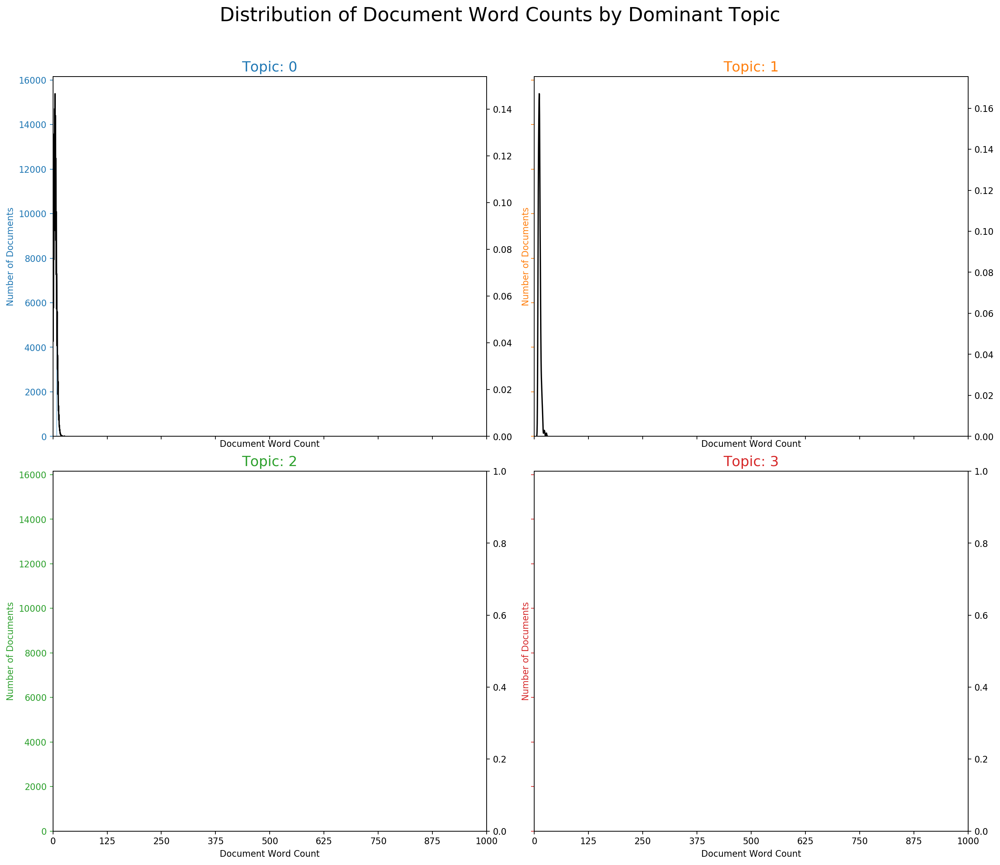

In [88]:
import seaborn as sns
import matplotlib.colors as mcolors
cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]  # more colors: 'mcolors.XKCD_COLORS'

fig, axes = plt.subplots(2,2,figsize=(16,14), dpi=160, sharex=True, sharey=True)

for i, ax in enumerate(axes.flatten()):    
    df_dominant_topic_sub = df_dominant_topic.loc[df_dominant_topic.Dominant_Topic == i, :]
    doc_lens = [len(d) for d in df_dominant_topic_sub.Text]
    ax.hist(doc_lens, bins = 1000, color=cols[i])
    ax.tick_params(axis='y', labelcolor=cols[i], color=cols[i])
    sns.kdeplot(doc_lens, color="black", shade=False, ax=ax.twinx())
    ax.set(xlim=(0, 1000), xlabel='Document Word Count')
    ax.set_ylabel('Number of Documents', color=cols[i])
    ax.set_title('Topic: '+str(i), fontdict=dict(size=16, color=cols[i]))

fig.tight_layout()
fig.subplots_adjust(top=0.90)
plt.xticks(np.linspace(0,1000,9))
fig.suptitle('Distribution of Document Word Counts by Dominant Topic', fontsize=22)
plt.show()

IndexError: list index out of range

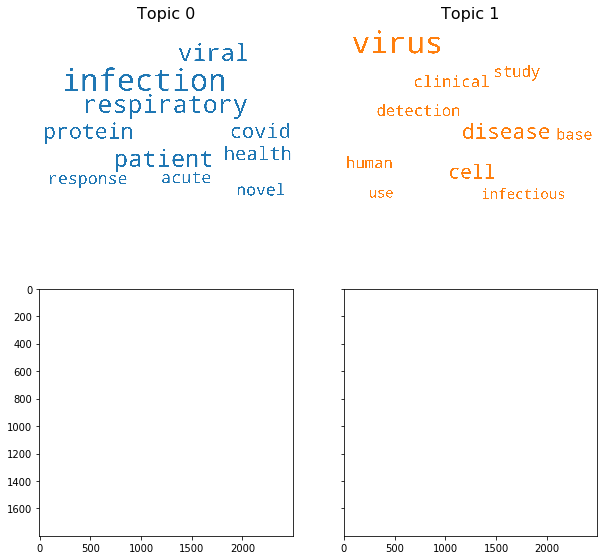

In [89]:
from matplotlib import pyplot as plt
from wordcloud import WordCloud, STOPWORDS
import matplotlib.colors as mcolors

cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]  # more colors: 'mcolors.XKCD_COLORS'

cloud = WordCloud(stopwords=stop_words,
                  background_color='white',
                  width=2500,
                  height=1800,
                  max_words=10,
                  colormap='tab10',
                  color_func=lambda *args, **kwargs: cols[i],
                  prefer_horizontal=1.0)

topics = lda_model.show_topics(formatted=False)

fig, axes = plt.subplots(2, 2, figsize=(10,10), sharex=True, sharey=True)

for i, ax in enumerate(axes.flatten()):
    fig.add_subplot(ax)
    topic_words = dict(topics[i][1])
    cloud.generate_from_frequencies(topic_words, max_font_size=300)
    plt.gca().imshow(cloud)
    plt.gca().set_title('Topic ' + str(i), fontdict=dict(size=16))
    plt.gca().axis('off')


plt.subplots_adjust(wspace=0, hspace=0)
plt.axis('off')
plt.margins(x=0, y=0)
plt.tight_layout()
plt.show()